 # Sberbank Russian Housing Market
 ###  29 April, 2017
 
 # Data preprocessing
 ## Load data

In [2]:
## Variables specific for competition

ID = 'id'                                            
TARGET = 'price_doc'    
LOGTARGET = 'log_price_doc'
LOGPV_PER_M2 = 'log_pv_price_per_m2'    # logarithm of the discounted value of the price per living area
LOGDOLLARPRICE = 'log_dollar_price'     # logarithm of the dollar price
LOGDOLLAR_PER_M2 = 'log_dollar_price_per_m2'   # logarithm of the dollar price of one sqr meter living area

RAW_DIRECTORY = 'H:/J/Kaggle/6_Sberbank_HousingPrices_2017/rawdata/'  
DIRECTORY = 'H:/J/Kaggle/6_Sberbank_HousingPrices_2017/data/'
TRAIN_FILE = RAW_DIRECTORY + 'train.csv'     
TEST_FILE = RAW_DIRECTORY +'test.csv'        
MACRO_FILE = RAW_DIRECTORY + 'macro.csv'

# Before onehot encoding the common file of the train and test data 
# will be saved into this file:
DATA_FILE = DIRECTORY + 'data.csv'                 
DATA_ONEHOT = DIRECTORY + 'data_onehot.csv'        # includes onehot encoding

# The final training, validation and local test set will be saved into these files:
TRAIN_ONEHOT = DIRECTORY + 'train_onehot.csv'         
VALID_ONEHOT = DIRECTORY + 'valid_onehot.csv'        
LOCALTEST_ONEHOT = DIRECTORY + 'localtest_onehot.csv'       # this is for local test
TRAIN_PREPROCESSED = DIRECTORY + 'train_preprocessed.csv'
VALID_PREPROCESSED = DIRECTORY + 'valid_preprocessed.csv'
LOCALTEST_PREPROCESSED = DIRECTORY + 'localtest_preprocessed.csv'

# Dataset including training, validaton, and local test sets
ALLTRAIN = DIRECTORY + 'alltrain.csv'                       # without one-hot encoding
ALLTRAIN_ONEHOT = DIRECTORY + 'alltrain_onehot.csv'         # with one-hot encoding

# The predictions will be made for this dataset:
TEST_PREPROCESSED = DIRECTORY + 'test_preprocessed.csv'     # without one-hot encoding
TEST_ONEHOT = DIRECTORY + 'test_onehot.csv'                 # with one-hot encoding

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import random

In [4]:
train = pd.read_csv(TRAIN_FILE)
test = pd.read_csv(TEST_FILE)

In [5]:
train.head()

,id,timestamp,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,...,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,big_church_count_5000,church_count_5000,mosque_count_5000,leisure_count_5000,sport_count_5000,market_count_5000,price_doc
0,1,2011-08-20,43,27.0,4.0,NaN,NaN,NaN,NaN,NaN,...,9,4,0,13,22,1,0,52,4,5850000
1,2,2011-08-23,34,19.0,3.0,NaN,NaN,NaN,NaN,NaN,...,15,3,0,15,29,1,10,66,14,6000000
2,3,2011-08-27,43,29.0,2.0,NaN,NaN,NaN,NaN,NaN,...,10,3,0,11,27,0,4,67,10,5700000
3,4,2011-09-01,89,50.0,9.0,NaN,NaN,NaN,NaN,NaN,...,11,2,1,4,4,0,0,26,3,13100000
4,5,2011-09-05,77,77.0,4.0,NaN,NaN,NaN,NaN,NaN,...,319,108,17,135,236,2,91,195,14,16331452


In [6]:
for idx in range(len(train.columns)):
    print(train.dtypes[idx], ' '*6, train.columns[idx])

int64        id
object        timestamp
int64        full_sq
float64        life_sq
float64        floor
float64        max_floor
float64        material
float64        build_year
float64        num_room
float64        kitch_sq
float64        state
object        product_type
object        sub_area
float64        area_m
int64        raion_popul
float64        green_zone_part
float64        indust_part
int64        children_preschool
float64        preschool_quota
int64        preschool_education_centers_raion
int64        children_school
float64        school_quota
int64        school_education_centers_raion
int64        school_education_centers_top_20_raion
float64        hospital_beds_raion
int64        healthcare_centers_raion
int64        university_top_20_raion
int64        sport_objects_raion
int64        additional_education_raion
object        culture_objects_top_25
int64        culture_objects_top_25_raion
int64        shopping_centers_raion
int64        office_raion
object    

In [7]:
train.shape, test.shape

((30471, 292), (7662, 291))

In [8]:
train['istrain'] = 1
test['istrain'] = 0
data = pd.concat([train.copy(), test.copy()],ignore_index=True)
data.shape

(38133, 293)

In [9]:
data.head()

,0_13_all,0_13_female,0_13_male,0_17_all,0_17_female,0_17_male,0_6_all,0_6_female,0_6_male,16_29_all,...,water_km,water_treatment_km,work_all,work_female,work_male,workplaces_km,young_all,young_female,young_male,zd_vokzaly_avto_km
0,18654,8945,9709,23603,11317,12286,9576,4677,4899,17508,...,0.992631,23.683460,98207,45930,52277,0.884350,21154,10147,11007,14.231961
1,13729,6800,6929,17700,8702,8998,6880,3414,3466,15164,...,0.698081,1.317476,70194,34572,35622,0.686252,15727,7802,7925,9.242586
2,11252,5336,5916,14884,7063,7821,5879,2784,3095,19401,...,0.468265,4.912660,63388,31575,31813,1.510089,13028,6193,6835,9.540544
3,24934,12152,12782,32063,15550,16513,13087,6442,6645,3292,...,1.200336,15.623710,120381,60341,60040,0.622272,28563,13883,14680,17.478380
4,11631,5408,6223,15237,7124,8113,5706,2724,2982,5164,...,0.820294,10.683540,68043,33807,34236,0.892668,13368,6209,7159,1.595898


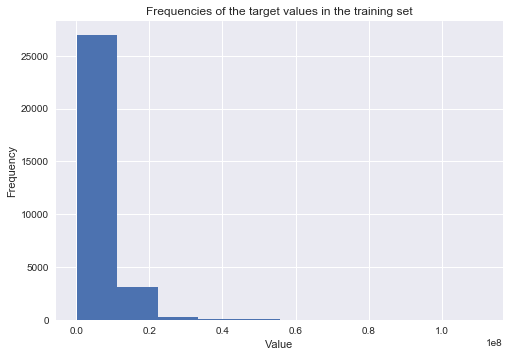

In [10]:
plt.hist(train[TARGET])
plt.title("Frequencies of the target values in the training set")
plt.xlabel("Value")
plt.ylabel("Frequency")
plt.show()

In [11]:
train[TARGET].describe()

count    3.047100e+04
mean     7.123035e+06
std      4.780111e+06
min      1.000000e+05
25%      4.740002e+06
50%      6.274411e+06
75%      8.300000e+06
max      1.111111e+08
Name: price_doc, dtype: float64

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\nonparametric\kdetools.py:20: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  y = X[:m/2+1] + np.r_[0,X[m/2+1:],0]*1j


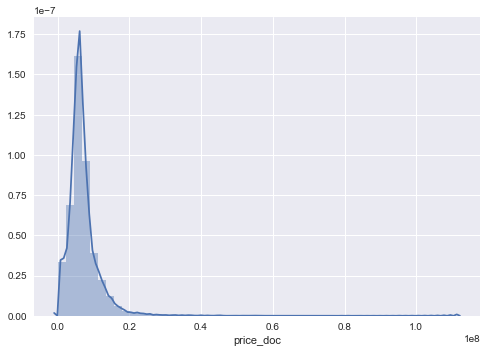

In [12]:
sns.distplot(train[TARGET])

## Separate numeric and categorical variables

In [13]:
# Find columns with numeric (int or float) values and nonnumeric (categorical) variables

nonnumeric_cols = data.dtypes[data.dtypes == 'object'].index.copy()
numeric_cols = data.dtypes[data.dtypes != 'object'].index.copy()
print(nonnumeric_cols)
print(numeric_cols)

Index(['big_market_raion', 'big_road1_1line', 'culture_objects_top_25',
       'detention_facility_raion', 'ecology', 'incineration_raion',
       'nuclear_reactor_raion', 'oil_chemistry_raion', 'product_type',
       'radiation_raion', 'railroad_1line', 'railroad_terminal_raion',
       'sub_area', 'thermal_power_plant_raion', 'timestamp', 'water_1line'],
      dtype='object')
Index(['0_13_all', '0_13_female', '0_13_male', '0_17_all', '0_17_female',
       '0_17_male', '0_6_all', '0_6_female', '0_6_male', '16_29_all',
       ...
       'water_km', 'water_treatment_km', 'work_all', 'work_female',
       'work_male', 'workplaces_km', 'young_all', 'young_female', 'young_male',
       'zd_vokzaly_avto_km'],
      dtype='object', length=277)


In [14]:
## Number of variables with different dtypes
data.dtypes.value_counts()

int64      156
float64    121
object      16
dtype: int64

In [15]:
# New feature suggested by Bhavesh Ghodasara (https://www.kaggle.com/c/sberbank-russian-housing-market/discussion/33269)
data['apartment_name'] = data['sub_area'] + data['metro_km_avto'].astype(str)
# id 18344 got full_sq as 634. Now may houses of Nekrasovka and with the same distance from metro are there. But none of them 
# got such huge full_sq. however there are many house in same area with 63 square meters. so this must be typo and we can clean 
# this value. Similarly we can populate missing but important feature like floor, max floor and life_sq from there.

# feature apartment_name_month_year has no shared information between train and test... therefore, it may overfit the model
# week_yr_cnt
# month_yr_cnt
# apartment_name_month_yr_cnt

In [16]:
len(data['apartment_name'].unique())

13626

In [17]:
def describe_variable(dt):
    print('--------------------------------------------')
    for c in data.columns:
        if c != 'istrain':
            if data[c].dtype == dt:
                t1 = data[data['istrain'] == 1][c]
                t2 = data[data['istrain'] == 0][c]
                if dt == "object":
                    f1 = t1[pd.isnull(t1) == False].value_counts()
                    f2 = t2[pd.isnull(t2) == False].value_counts()
                else:
                    f1 = t1[pd.isnull(t1) == False].describe()
                    f2 = t2[pd.isnull(t2) == False].describe()
                m1 = sum(t1.isnull())
                m2 = sum(t2.isnull())
                f = pd.concat([f1, f2], axis = 1)
                f.columns=['Train','Test']
                print(dt + ' - ' + c)
                print('Number of unique values - train: %d, test: %d' % (len(t1.value_counts()),
                                                                         len(t2.value_counts())))
                print('Number of missing values - train: %d, test: %d' %  (m1, m2))
                if dt == 'object':
                    print(f.sort_values(by = 'Train', ascending = False))
                else:
                    print(f)
                
                if dt != "object":
                    if len(t1.value_counts())<=10:
                        c1 = t1.value_counts()
                        c2 = t2.value_counts()
                        c = pd.concat([c1, c2], axis=1)
                        c.columns=['Train','Test']
                        print(c)
                print('=' * 30)

In [18]:
describe_variable('int64')

--------------------------------------------
int64 - 0_13_all
Number of unique values - train: 146, test: 145
Number of missing values - train: 0, test: 0
              Train          Test
count  30471.000000   7662.000000
mean    9841.097535  10247.364265
std     7290.007118   7172.973633
min      322.000000    322.000000
25%     3112.000000   4648.000000
50%     9633.000000   9955.000000
75%    13121.000000  13729.000000
max    36035.000000  36035.000000
int64 - 0_13_female
Number of unique values - train: 146, test: 145
Number of missing values - train: 0, test: 0
              Train          Test
count  30471.000000   7662.000000
mean    4803.833153   5013.089402
std     3536.907486   3482.495325
min      156.000000    156.000000
25%     1512.000000   2306.000000
50%     4667.000000   4940.000000
75%     6699.000000   6800.000000
max    17461.000000  17461.000000
int64 - 0_13_male
Number of unique values - train: 144, test: 143
Number of missing values - train: 0, test: 0
         

In [19]:
# Check consistency
print('demography')
print(data[data['0_13_female'] + data['0_13_male'] != data['0_13_all']].shape[0])
print(data[data['0_17_female'] + data['0_17_male'] != data['0_17_all']].shape[0])
print(data[data['0_6_female'] + data['0_6_male'] != data['0_6_all']].shape[0])
print(data[data['16_29_female'] + data['16_29_male'] != data['16_29_all']].shape[0])
print(data[data['7_14_female'] + data['7_14_male'] != data['7_14_all']].shape[0])
print(data[data['ekder_female'] + data['ekder_male'] != data['ekder_all']].shape[0])
print(data[data['female_f'] + data['male_f'] != data['full_all']].shape[0])
print(data[data['work_female'] + data['work_male'] != data['work_all']].shape[0])
print(data[data['young_female'] + data['young_male'] != data['young_all']].shape[0])
print(data[data['raion_popul'] != data['full_all']].shape[0])

print('=' * 30)
print('big_church_count')
print(data[data['big_church_count_500'] > data['big_church_count_1000']].shape[0])
print(data[data['big_church_count_1000'] > data['big_church_count_1500']].shape[0])
print(data[data['big_church_count_1500'] > data['big_church_count_2000']].shape[0])
print(data[data['big_church_count_2000'] > data['big_church_count_3000']].shape[0])
print(data[data['big_church_count_3000'] > data['big_church_count_5000']].shape[0])

print('=' * 30)
print('cafe_count')
print(data[data['cafe_count_500'] > data['cafe_count_1000']].shape[0])
print(data[data['cafe_count_1000'] > data['cafe_count_1500']].shape[0])
print(data[data['cafe_count_1500'] > data['cafe_count_2000']].shape[0])
print(data[data['cafe_count_2000'] > data['cafe_count_3000']].shape[0])
print(data[data['cafe_count_3000'] > data['cafe_count_5000']].shape[0])

print('=' * 30)
print('cafe_count_500 with price')
print(data[data['cafe_count_500_na_price'] > data['cafe_count_500']].shape[0])
print(data[data['cafe_count_500_price_500'] > data['cafe_count_500_price_1000']].shape[0])
print(data[data['cafe_count_500_price_1000'] > data['cafe_count_500_price_1500']].shape[0])
print(data[data['cafe_count_500_price_1500'] > data['cafe_count_500_price_2500']].shape[0])
print(data[data['cafe_count_500_price_2500'] > data['cafe_count_500_price_4000']].shape[0])
print(data[data['cafe_count_500_price_4000'] > data['cafe_count_500']].shape[0])
print(data[data['cafe_count_500_price_high'] > data['cafe_count_500']].shape[0])
print(data[data['cafe_count_500_na_price'] + data['cafe_count_500_price_500'] + data['cafe_count_500_price_1000'] + 
           data['cafe_count_500_price_1500'] + data['cafe_count_500_price_2500'] + data['cafe_count_500_price_4000'] +
           data['cafe_count_500_price_high'] != data['cafe_count_500']].shape[0])


print('=' * 30)
print('cafe_count_1000 with price')
print(data[data['cafe_count_1000_na_price'] > data['cafe_count_1000']].shape[0])
print(data[data['cafe_count_1000_price_500'] > data['cafe_count_1000_price_1000']].shape[0])
print(data[data['cafe_count_1000_price_1000'] > data['cafe_count_1000_price_1500']].shape[0])
print(data[data['cafe_count_1000_price_1500'] > data['cafe_count_1000_price_2500']].shape[0])
print(data[data['cafe_count_1000_price_2500'] > data['cafe_count_1000_price_4000']].shape[0])
print(data[data['cafe_count_1000_price_4000'] > data['cafe_count_1000']].shape[0])
print(data[data['cafe_count_1000_price_high'] > data['cafe_count_1000']].shape[0])
print(data[data['cafe_count_1000_na_price'] + data['cafe_count_1000_price_500'] + data['cafe_count_1000_price_1000'] + 
           data['cafe_count_1000_price_1500'] + data['cafe_count_1000_price_2500'] + data['cafe_count_1000_price_4000'] +
           data['cafe_count_1000_price_high'] != data['cafe_count_1000']].shape[0])

print('=' * 30)
print('cafe_count_1500 with price')
print(data[data['cafe_count_1500_na_price'] > data['cafe_count_1500']].shape[0])
print(data[data['cafe_count_1500_price_500'] > data['cafe_count_1500_price_1000']].shape[0])
print(data[data['cafe_count_1500_price_1000'] > data['cafe_count_1500_price_1500']].shape[0])
print(data[data['cafe_count_1500_price_1500'] > data['cafe_count_1500_price_2500']].shape[0])
print(data[data['cafe_count_1500_price_2500'] > data['cafe_count_1500_price_4000']].shape[0])
print(data[data['cafe_count_1500_price_4000'] > data['cafe_count_1500']].shape[0])
print(data[data['cafe_count_1500_price_high'] > data['cafe_count_1500']].shape[0])
print(data[data['cafe_count_1500_na_price'] + data['cafe_count_1500_price_500'] + data['cafe_count_1500_price_1000'] + 
           data['cafe_count_1500_price_1500'] + data['cafe_count_1500_price_2500'] + data['cafe_count_1500_price_4000'] +
           data['cafe_count_1500_price_high'] != data['cafe_count_1500']].shape[0])


print('=' * 30)
print('cafe_count_2000 with price')
print(data[data['cafe_count_2000_na_price'] > data['cafe_count_2000']].shape[0])
print(data[data['cafe_count_2000_price_500'] > data['cafe_count_2000_price_1000']].shape[0])
print(data[data['cafe_count_2000_price_1000'] > data['cafe_count_2000_price_1500']].shape[0])
print(data[data['cafe_count_2000_price_1500'] > data['cafe_count_2000_price_2500']].shape[0])
print(data[data['cafe_count_2000_price_2500'] > data['cafe_count_2000_price_4000']].shape[0])
print(data[data['cafe_count_2000_price_4000'] > data['cafe_count_2000']].shape[0])
print(data[data['cafe_count_2000_price_high'] > data['cafe_count_2000']].shape[0])
print(data[data['cafe_count_2000_na_price'] + data['cafe_count_2000_price_500'] + data['cafe_count_2000_price_1000'] + 
           data['cafe_count_2000_price_1500'] + data['cafe_count_2000_price_2500'] + data['cafe_count_2000_price_4000'] +
           data['cafe_count_2000_price_high'] != data['cafe_count_2000']].shape[0])


print('=' * 30)
print('cafe_count_3000 with price')
print(data[data['cafe_count_3000_na_price'] > data['cafe_count_3000']].shape[0])
print(data[data['cafe_count_3000_price_500'] > data['cafe_count_3000_price_1000']].shape[0])
print(data[data['cafe_count_3000_price_1000'] > data['cafe_count_3000_price_1500']].shape[0])
print(data[data['cafe_count_3000_price_1500'] > data['cafe_count_3000_price_2500']].shape[0])
print(data[data['cafe_count_3000_price_2500'] > data['cafe_count_3000_price_4000']].shape[0])
print(data[data['cafe_count_3000_price_4000'] > data['cafe_count_3000']].shape[0])
print(data[data['cafe_count_3000_price_high'] > data['cafe_count_3000']].shape[0])
print(data[data['cafe_count_3000_na_price'] + data['cafe_count_3000_price_500'] + data['cafe_count_3000_price_1000'] + 
           data['cafe_count_3000_price_1500'] + data['cafe_count_3000_price_2500'] + data['cafe_count_3000_price_4000'] +
           data['cafe_count_3000_price_high'] != data['cafe_count_3000']].shape[0])


print('=' * 30)
print('cafe_count_5000 with price')
print(data[data['cafe_count_5000_na_price'] > data['cafe_count_5000']].shape[0])
print(data[data['cafe_count_5000_price_500'] > data['cafe_count_5000_price_1000']].shape[0])
print(data[data['cafe_count_5000_price_1000'] > data['cafe_count_5000_price_1500']].shape[0])
print(data[data['cafe_count_5000_price_1500'] > data['cafe_count_5000_price_2500']].shape[0])
print(data[data['cafe_count_5000_price_2500'] > data['cafe_count_5000_price_4000']].shape[0])
print(data[data['cafe_count_5000_price_4000'] > data['cafe_count_5000']].shape[0])
print(data[data['cafe_count_5000_price_high'] > data['cafe_count_5000']].shape[0])
print(data[data['cafe_count_5000_na_price'] + data['cafe_count_5000_price_500'] + data['cafe_count_5000_price_1000'] + 
           data['cafe_count_5000_price_1500'] + data['cafe_count_5000_price_2500'] + data['cafe_count_5000_price_4000'] +
           data['cafe_count_5000_price_high'] != data['cafe_count_5000']].shape[0])

print('=' * 30)
print('church_count')
print(data[data['church_count_500'] > data['church_count_1000']].shape[0])
print(data[data['church_count_1000'] > data['church_count_1500']].shape[0])
print(data[data['church_count_1500'] > data['church_count_2000']].shape[0])
print(data[data['church_count_2000'] > data['church_count_3000']].shape[0])
print(data[data['church_count_3000'] > data['church_count_5000']].shape[0])

print('=' * 30)
print('leisure_count')
print(data[data['leisure_count_500'] > data['leisure_count_1000']].shape[0])
print(data[data['leisure_count_1000'] > data['leisure_count_1500']].shape[0])
print(data[data['leisure_count_1500'] > data['leisure_count_2000']].shape[0])
print(data[data['leisure_count_2000'] > data['leisure_count_3000']].shape[0])
print(data[data['leisure_count_3000'] > data['leisure_count_5000']].shape[0])

print('=' * 30)
print('market_count')
print(data[data['market_count_500'] > data['market_count_1000']].shape[0])
print(data[data['market_count_1000'] > data['market_count_1500']].shape[0])
print(data[data['market_count_1500'] > data['market_count_2000']].shape[0])
print(data[data['market_count_2000'] > data['market_count_3000']].shape[0])
print(data[data['market_count_3000'] > data['market_count_5000']].shape[0])

print('=' * 30)
print('mosque_count')
print(data[data['mosque_count_500'] > data['mosque_count_1000']].shape[0])
print(data[data['mosque_count_1000'] > data['mosque_count_1500']].shape[0])
print(data[data['mosque_count_1500'] > data['mosque_count_2000']].shape[0])
print(data[data['mosque_count_2000'] > data['mosque_count_3000']].shape[0])
print(data[data['mosque_count_3000'] > data['mosque_count_5000']].shape[0])

print('=' * 30)
print('office_count')
print(data[data['office_count_500'] > data['office_count_1000']].shape[0])
print(data[data['office_count_1000'] > data['office_count_1500']].shape[0])
print(data[data['office_count_1500'] > data['office_count_2000']].shape[0])
print(data[data['office_count_2000'] > data['office_count_3000']].shape[0])
print(data[data['office_count_3000'] > data['office_count_5000']].shape[0])

print('=' * 30)
print('office_sqm')
print(data[data['office_sqm_500'] > data['office_sqm_1000']].shape[0])
print(data[data['office_sqm_1000'] > data['office_sqm_1500']].shape[0])
print(data[data['office_sqm_1500'] > data['office_sqm_2000']].shape[0])
print(data[data['office_sqm_2000'] > data['office_sqm_3000']].shape[0])
print(data[data['office_sqm_3000'] > data['office_sqm_5000']].shape[0])

print('=' * 30)
print('sport_count')
print(data[data['sport_count_500'] > data['sport_count_1000']].shape[0])
print(data[data['sport_count_1000'] > data['sport_count_1500']].shape[0])
print(data[data['sport_count_1500'] > data['sport_count_2000']].shape[0])
print(data[data['sport_count_2000'] > data['sport_count_3000']].shape[0])
print(data[data['sport_count_3000'] > data['sport_count_5000']].shape[0])

print('=' * 30)
print('trc_count')
print(data[data['trc_count_500'] > data['trc_count_1000']].shape[0])
print(data[data['trc_count_1000'] > data['trc_count_1500']].shape[0])
print(data[data['trc_count_1500'] > data['trc_count_2000']].shape[0])
print(data[data['trc_count_2000'] > data['trc_count_3000']].shape[0])
print(data[data['trc_count_3000'] > data['trc_count_5000']].shape[0])

print('=' * 30)
print('trc_sqm')
print(data[data['trc_sqm_500'] > data['trc_sqm_1000']].shape[0])
print(data[data['trc_sqm_1000'] > data['trc_sqm_1500']].shape[0])
print(data[data['trc_sqm_1500'] > data['trc_sqm_2000']].shape[0])
print(data[data['trc_sqm_2000'] > data['trc_sqm_3000']].shape[0])
print(data[data['trc_sqm_3000'] > data['trc_sqm_5000']].shape[0])



demography
361
5953
4961
4550
5336
2784
6783
3473
2079
38133
big_church_count
0
0
0
0
0
cafe_count
0
0
0
0
0
cafe_count_500 with price
0
6041
9297
9570
6496
0
0
0
cafe_count_1000 with price
0
7688
17579
19012
13213
0
0
0
cafe_count_1500 with price
0
9171
20428
24535
18112
0
0
0
cafe_count_2000 with price
0
9617
23121
28847
21402
0
0
0
cafe_count_3000 with price
0
8289
27293
31396
27689
0
0
0
cafe_count_5000 with price
0
6505
31313
36213
31683
0
0
0
church_count
0
0
0
0
0
leisure_count
0
0
0
0
0
market_count
0
0
0
0
0
mosque_count
0
0
0
0
0
office_count
0
0
0
0
0
office_sqm
0
0
0
0
0
sport_count
0
0
0
0
0
trc_count
0
0
0
0
0
trc_sqm
0
0
0
0
0


In [20]:
# Further investigation
print((data['0_13_female'] + data['0_13_male'] - data['0_13_all']).describe())
print((data['0_17_female'] + data['0_17_male'] - data['0_17_all']).describe())
print((data['0_6_female'] + data['0_6_male'] - data['0_6_all']).describe())
print((data['16_29_female'] + data['16_29_male'] - data['16_29_all']).describe())
print((data['7_14_female'] + data['7_14_male'] - data['7_14_all']).describe())
print((data['ekder_female'] + data['ekder_male'] - data['ekder_all']).describe())
print((data['female_f'] + data['male_f'] - data['full_all']).describe())
print((data['work_female'] + data['work_male'] - data['work_all']).describe())
print((data['young_female'] + data['young_male'] - data['young_all']).describe())
print((data['raion_popul'] - data['full_all']).describe())

count    38133.000000
mean         0.009467
std          0.096837
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
dtype: float64
count    38133.000000
mean         0.156112
std          0.362966
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
dtype: float64
count    38133.000000
mean         0.130097
std          0.336415
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
dtype: float64
count    38133.000000
mean         0.119319
std          0.324168
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
dtype: float64
count    38133.000000
mean         0.139931
std          0.346920
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
dtype: float64
count    38133.000000
mean         0.073008
s

In [21]:
describe_variable('float64')

--------------------------------------------
float64 - ID_railroad_station_walk
Number of unique values - train: 133, test: 122
Number of missing values - train: 25, test: 34
              Train         Test
count  30446.000000  7628.000000
mean      38.857321    38.017042
std       27.766264    29.655250
min        1.000000     1.000000
25%       18.000000    17.000000
50%       33.000000    30.000000
75%       53.000000    51.000000
max      133.000000   135.000000
float64 - additional_education_km
Number of unique values - train: 11843, test: 4152
Number of missing values - train: 0, test: 0
              Train         Test
count  30471.000000  7662.000000
mean       1.328488     1.322325
std        1.526219     1.545901
min        0.000000     0.000000
25%        0.474842     0.509985
50%        0.899034     0.873033
75%        1.571062     1.510351
max       24.268209    24.268209
float64 - area_m
Number of unique values - train: 146, test: 145
Number of missing values - train: 0,

In [22]:
# Check consistency
print(data[data['build_count_1921-1945'] + data['build_count_1946-1970'] + data['build_count_1971-1995'] + 
     data['build_count_after_1995'] + data['build_count_before_1920'] != data['build_count_block'] + data['build_count_brick'] +
     data['build_count_foam'] + data['build_count_frame'] + data['build_count_mix'] + data['build_count_monolith'] +
     data['build_count_panel'] + data['build_count_slag'] + data['build_count_wood']].shape[0])
print(data[data['build_count_1921-1945'] + data['build_count_1946-1970'] + data['build_count_1971-1995'] + 
     data['build_count_after_1995'] + data['build_count_before_1920'] != data['raion_build_count_with_builddate_info']].shape[0])
print(data[data['build_count_block'] + data['build_count_brick'] + data['build_count_foam'] + data['build_count_frame'] + 
      data['build_count_mix'] + data['build_count_monolith'] + data['build_count_panel'] + data['build_count_slag'] + 
      data['build_count_wood'] != data['raion_build_count_with_material_info']].shape[0])

print('=' * 30)
print('build_year')
print(data[data['build_year'] < 1900]['build_year'].unique().astype(int))
print(data[data['build_year'] > 2017]['build_year'].unique().astype(int))

print('=' * 30)
print('house/flat')
print(data[data['floor'] > data['max_floor']].shape[0])
print(data[data['full_sq'] < data['kitch_sq']].shape[0])
print(data[data['full_sq'] < data['life_sq']].shape[0])
print((data[data['num_room'] > 0]['life_sq'] / data[data['num_room'] > 0]['num_room']).describe())


22048
6209
6209
build_year
[   0    1    3 1896   20 1860 1895 1876 1890 1691 1886  215   71    2 1875
 1898]
[20052009     4965     2018     2019]
house/flat
2136
17
49
count    23236.000000
mean        18.546352
std         19.359991
min          0.000000
25%         14.333333
50%         16.050000
75%         19.100000
max       2492.666667
dtype: float64


In [23]:
ls_mistakes = data[data['build_year'] < 1900]['build_year'].unique().astype(int)

for mistake in ls_mistakes:
    print(mistake)
    print(data[data['build_year'] == mistake].shape[0])
    print('=' * 20)

for mistake in [20052009, 4965]:
    print(mistake)
    print(data[data['build_year'] == mistake].shape[0])
    print('=' * 20)

0
899
1
555
3
2
1896
2
20
1
1860
2
1895
2
1876
1
1890
7
1691
1
1886
1
215
2
71
1
2
1
1875
1
1898
1
20052009
1
4965
1


In [24]:
for mistake in ls_mistakes:
    print(mistake)
    print(len(data[data['build_year'] == mistake]['apartment_name'].unique()))
    print('=' * 20)

for mistake in [20052009, 4965]:
    print(mistake)
    print(len(data[data['build_year'] == mistake]['apartment_name'].unique()))
    print('=' * 20)

0
186
1
175
3
2
1896
1
20
1
1860
2
1895
2
1876
1
1890
7
1691
1
1886
1
215
2
71
1
2
1
1875
1
1898
1
20052009
1
4965
1


In [25]:
for mistake in ls_mistakes:
    print(mistake)
    for apart in data[data['build_year'] == mistake]['apartment_name'].unique():
        data_apart = data[data['apartment_name'] == apart].copy()
        num_mist = data_apart[data_apart['build_year'] == mistake].shape[0]
        num_nonmist = data_apart[data_apart['build_year'] != mistake].shape[0]
        num_otheryrs = len(data_apart[data_apart['build_year'] != mistake]['build_year'].unique())
        print('In %s the number of houses with build_year == %d is %d' % (apart, mistake, num_mist))
        print('                                         with other build_year is %d' % num_nonmist)
        print('                     the number of other different build years is %d' % num_otheryrs)
        for yr in data_apart[data_apart['build_year'] != mistake]['build_year'].unique():
            print('Number of houses with build_year %.0f is %d' % (yr, data_apart[data_apart['build_year'] == yr].shape[0]))
        print('-' * 30)
    print('=' * 30)

for mistake in [20052009, 4965]:
    print(mistake)
    for apart in data[data['build_year'] == mistake]['apartment_name'].unique():
        data_apart = data[data['apartment_name'] == apart].copy()
        num_mist = data_apart[data_apart['build_year'] == mistake].shape[0]
        num_nonmist = data_apart[data_apart['build_year'] != mistake].shape[0]
        num_otheryrs = len(data_apart[data_apart['build_year'] != mistake]['build_year'].unique())
        print('In %s the number of houses with build_year == %d is %d' % (apart, mistake, num_mist))
        print('                                          with other build_year is %d' % num_nonmist)
        print('                     the number of other different build years is %d' % num_otheryrs)
        for yr in data_apart[data_apart['build_year'] != mistake]['build_year'].unique():
            print('Number of houses with build_year %.0f is %d' % (yr, data_apart[data_apart['build_year'] == yr].shape[0]))
        print('-' * 30)
    print('=' * 30)

0
In Poselenie Vnukovskoe4.685435005 the number of houses with build_year == 0 is 1
                                         with other build_year is 52
                     the number of other different build years is 3
Number of houses with build_year nan is 0
Number of houses with build_year 1 is 1
Number of houses with build_year 2014 is 1
------------------------------
In Nekrasovka3.776835959 the number of houses with build_year == 0 is 13
                                         with other build_year is 965
                     the number of other different build years is 6
Number of houses with build_year nan is 0
Number of houses with build_year 2013 is 43
Number of houses with build_year 2014 is 87
Number of houses with build_year 1 is 25
Number of houses with build_year 2015 is 66
Number of houses with build_year 2016 is 10
------------------------------
In Poselenie Moskovskij6.732361525 the number of houses with build_year == 0 is 56
                                       

In [26]:
print(data[data['apartment_name'] == 'Severnoe Izmajlovo2.207263749'][['apartment_name', 'max_floor', 'material', 'build_year']])
print('=' * 50)
print(data[data['apartment_name'] == 'Ramenki4.831326144'][['apartment_name', 'max_floor', 'material', 'build_year']])
print('=' * 50)
print(data[data['apartment_name'] == 'Cheremushki0.959703023'][['apartment_name', 'max_floor', 'material', 'build_year']])
print('=' * 50)
print(data[data['apartment_name'] == 'Sokolinaja Gora1.226667262'][['apartment_name', 'max_floor', 'material', 'build_year']])
print('=' * 50)

                      apartment_name  max_floor  material  build_year
18027  Severnoe Izmajlovo2.207263749        5.0       5.0      1961.0
26332  Severnoe Izmajlovo2.207263749        5.0       5.0      1691.0
           apartment_name  max_floor  material  build_year
12520  Ramenki4.831326144        7.0       6.0      2013.0
12934  Ramenki4.831326144       25.0       1.0      2017.0
12996  Ramenki4.831326144       20.0       1.0      2013.0
13051  Ramenki4.831326144       20.0       6.0      2014.0
13090  Ramenki4.831326144       17.0       4.0         NaN
13095  Ramenki4.831326144       18.0       2.0         NaN
13384  Ramenki4.831326144       23.0       6.0      2015.0
13537  Ramenki4.831326144       17.0       1.0      2014.0
13585  Ramenki4.831326144       15.0       4.0      2014.0
13635  Ramenki4.831326144       17.0       4.0      2017.0
13949  Ramenki4.831326144       23.0       6.0      2017.0
14103  Ramenki4.831326144       22.0       1.0      2014.0
14225  Ramenki4.8313261

In [27]:
# Clean build_year
data[data['apartment_name'] == 'Severnoe Izmajlovo2.207263749']['build_year'] = 1961
data['build_year'] = data['build_year'].apply(lambda x : 1961 if x == 1691 else 
                                              2015 if x == 215 else 
                                              1971 if x == 71 else 
                                              2007 if x == 20052009 else 
                                              1965 if x == 4965 else 
                                              np.nan if x < 50 else 
                                              x)

# Clean state
data['state'] = data['state'].apply(lambda x : 3 if x == 33 else x)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [28]:
print(data[data['floor'] > data['max_floor']]['max_floor'].unique())
print(data[data['floor'] > data['max_floor']]['floor'].unique())

[  0.   1.   3.  17.   2.  11.  10.   4.   9.  14.   6.   5.  23.  12.  16.
   7.  13.  22.  19.  18.  15.   8.]
[ 13.   3.   2.   7.   5.   8.  10.   4.   9.  12.  24.  14.  21.  20.  11.
  17.  16.  15.   6.  19.  18.  25.  23.  22.   1.  77.  26.  37.  34.]


In [29]:
data_with_mistakes = data[data['floor'] > data['max_floor']][['apartment_name', 'build_year', 'material', 
                                                              'max_floor', 'floor']].copy()
apartnames_with_mistakes = data_with_mistakes['apartment_name'].unique()

for apart in apartnames_with_mistakes:
    print('apartment_name == ' + apart)
    print(data_with_mistakes[data_with_mistakes['apartment_name'] == apart][['build_year', 'material', 'max_floor', 'floor']])
    print('=' * 50)

apartment_name == Poselenie Voskresenskoe2.254916339
       build_year  material  max_floor  floor
8216          NaN       1.0        0.0   13.0
10079      2014.0       1.0        1.0    3.0
10214         NaN       1.0        1.0   17.0
10404      2013.0       1.0        1.0    2.0
10718         NaN       1.0        0.0    7.0
11202         NaN       4.0        0.0    8.0
11341         NaN       1.0        0.0   16.0
11406         NaN       1.0        0.0    9.0
11907      2013.0       1.0        1.0   15.0
12178      2013.0       1.0        1.0    7.0
12965         NaN       1.0        1.0    2.0
13303      2014.0       1.0        1.0    5.0
13617         NaN       6.0        0.0    3.0
13642         NaN       1.0        1.0   11.0
13806      2013.0       1.0        1.0    6.0
14201         NaN       1.0        1.0    2.0
14391         NaN       1.0        0.0   12.0
14771         NaN       1.0        1.0    5.0
14846         NaN       1.0        1.0    5.0
15787         NaN       1.0

In [30]:
for apart in apartnames_with_mistakes:
    print('apartment_name == ' + apart)
    print(data[data['apartment_name'] == apart][['build_year', 'material', 'max_floor', 'floor']])
    print('=' * 50)

apartment_name == Poselenie Voskresenskoe2.254916339
       build_year  material  max_floor  floor
2731          NaN       NaN        NaN   13.0
3156          NaN       NaN        NaN    NaN
3332          NaN       NaN        NaN    7.0
3346          NaN       NaN        NaN    2.0
3447          NaN       NaN        NaN    4.0
3448          NaN       NaN        NaN    NaN
3495          NaN       NaN        NaN    3.0
3541          NaN       NaN        NaN    6.0
3542          NaN       NaN        NaN    3.0
3581          NaN       NaN        NaN    8.0
3599          NaN       NaN        NaN    4.0
3601          NaN       NaN        NaN    2.0
3607          NaN       NaN        NaN    2.0
3653          NaN       NaN        NaN   14.0
3684          NaN       NaN        NaN    6.0
3768          NaN       NaN        NaN   15.0
3789          NaN       NaN        NaN   11.0
3849          NaN       NaN        NaN   12.0
3890          NaN       NaN        NaN    5.0
3943          NaN       NaN

In [31]:
for apart in apartnames_with_mistakes:
    print('apartment_name == ' + apart)
    data_for_apart = data[data['apartment_name'] == apart].copy()
    print('Apartments with consistent max_floor and floor (max_floor >= floor):')
    print(data_for_apart[data_for_apart['max_floor'] >= data_for_apart['floor']].groupby(['build_year', 'material', 'max_floor']
                                                                                        ).size())
    print('Apartments with inconsistent max_floor and floor (max_floor < floor):')
    print(data_for_apart[data_for_apart['max_floor'] < data_for_apart['floor']].groupby(['build_year', 'material', 'max_floor',
                                                                                        'floor']).size())
    print('=' * 50)

apartment_name == Poselenie Voskresenskoe2.254916339
Apartments with consistent max_floor and floor (max_floor >= floor):
build_year  material  max_floor
2013.0      1.0       17.0         2
            4.0       25.0         1
            6.0       17.0         1
2014.0      1.0       2.0          2
                      8.0          1
                      10.0         1
                      15.0         2
                      16.0         2
                      17.0         2
            2.0       5.0          1
            4.0       10.0         1
                      13.0         1
2015.0      2.0       1.0          1
2016.0      1.0       3.0          1
                      12.0         1
                      17.0         1
dtype: int64
Apartments with inconsistent max_floor and floor (max_floor < floor):
build_year  material  max_floor  floor
2013.0      1.0       1.0        2.0      1
                                 6.0      1
                                 7.0      1


In [32]:
## Clean max_floor
#data_trial = data
#apart = 'Poselenie Voskresenskoe2.254916339'
#yr = 2013
#mater = 1
#data_trial_apart = data_trial[data_trial['apatment_name'] == apart].copy()
#data_trial_apart = data_trial_apart[data_trial_apart['build_year'] == yr]
#data_trial_apart = data_trial_apart[data_trial_apart['material'] == mater]
#

In [33]:
data['error_flag'] = 0
apart_feats = ["id","timestamp","price_doc", "apartment_name", "error_flag", "full_sq", "life_sq", "floor", "max_floor", 
               "material", "build_year", "num_room", "kitch_sq", "state", "product_type"]

In [34]:
bad_index = data[data.floor > data.max_floor].index
data['error_flag'].ix[bad_index] = 1
ls_apart_names = data.ix[bad_index, 'apartment_name'].unique()
data[data['apartment_name'].isin(ls_apart_names)][apart_feats].sort(columns = ['apartment_name', 'material', 'build_year', 
                                                                               'error_flag'])

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:141: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:5: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
17087,17090,2014-04-07,8300000.0,Ajeroport1.038844703,1,37.0,21.0,9.0,6.0,2.0,1963.0,2.0,7.0,2.0,Investment
27460,27463,2015-01-23,71249624.0,Ajeroport1.406037962,1,151.0,NaN,15.0,1.0,1.0,2015.0,4.0,1.0,1.0,OwnerOccupier
26905,26908,2014-12-20,15500000.0,Akademicheskoe1.392169875,0,77.0,50.0,1.0,17.0,1.0,2001.0,3.0,9.0,3.0,Investment
33146,33149,2015-11-26,NaN,Akademicheskoe1.392169875,0,78.5,45.5,2.0,17.0,1.0,2001.0,3.0,10.7,3.0,Investment
34336,34339,2016-01-15,NaN,Akademicheskoe1.392169875,0,78.5,45.5,2.0,17.0,1.0,2001.0,3.0,10.7,3.0,Investment
21715,21718,2014-08-20,16450000.0,Akademicheskoe1.392169875,0,72.0,43.0,1.0,17.0,1.0,2002.0,3.0,10.0,3.0,Investment
24769,24772,2014-11-14,12850000.0,Akademicheskoe1.392169875,0,52.0,30.0,17.0,17.0,1.0,2002.0,2.0,9.0,3.0,Investment
12662,12665,2013-11-30,9000000.0,Akademicheskoe1.392169875,0,39.0,18.0,10.0,24.0,1.0,2005.0,1.0,10.0,3.0,Investment
14619,14622,2014-02-05,13500000.0,Akademicheskoe1.392169875,0,60.0,30.0,15.0,24.0,1.0,2005.0,2.0,11.0,NaN,Investment
21324,21327,2014-08-06,8200000.0,Akademicheskoe1.392169875,0,45.0,44.0,4.0,5.0,2.0,1961.0,2.0,5.0,3.0,Investment


In [35]:
# Clean floor and max_floor
# 0 and 1 values for max_floor are likely mistakes
bad_index = data[data.max_floor < 2].index
data.ix[bad_index, 'max_floor'] = np.nan
# max floor can't be more than 57 according to https://en.wikipedia.org/wiki/Triumph_Palace
bad_index = data[data.max_floor > 57].index
data.ix[bad_index, 'max_floor'] = np.nan

In [36]:
# floor also must be less than or equal to 57
bad_index = data[data.floor > 57].index
data.ix[bad_index, 'floor'] = np.nan

In [37]:
bad_index = data[data.floor > data.max_floor].index
data['error_flag'] = 0
data['error_flag'].ix[bad_index] = 1
ls_apart_names = data.ix[bad_index, 'apartment_name'].unique()
data[data['apartment_name'].isin(ls_apart_names[:9])][apart_feats].sort(columns = ['apartment_name', 'material', 'build_year', 
                                                                               'error_flag']).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:141: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:6: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
12870,12873,2013-12-06,8500000.0,Bibirevo1.090257622,1,52.0,30.0,12.0,11.0,1.0,1974.0,2.0,8.0,3.0,Investment
11890,11893,2013-11-07,6850000.0,Caricyno2.682654879,0,49.0,31.0,12.0,12.0,5.0,1969.0,2.0,8.0,3.0,Investment
13811,13814,2014-01-16,2000000.0,Caricyno2.682654879,0,39.0,23.0,8.0,12.0,5.0,1969.0,2.0,6.0,2.0,Investment
14630,14633,2014-02-05,5200000.0,Caricyno2.682654879,1,35.0,20.0,12.0,9.0,5.0,1969.0,1.0,9.0,3.0,Investment
12148,12151,2013-11-14,5219608.0,Jakimanka3.288069812,1,41.0,NaN,20.0,17.0,1.0,NaN,1.0,1.0,NaN,OwnerOccupier
12724,12727,2013-12-03,8700000.0,Kuncevo1.608984197,1,55.0,38.0,5.0,3.0,2.0,1960.0,3.0,5.0,NaN,Investment
18365,18368,2014-05-13,7860088.0,Mar'ino1.721299615,0,52.0,30.0,12.0,14.0,1.0,2002.0,2.0,9.0,2.0,Investment
21857,21860,2014-08-25,6950000.0,Mar'ino1.721299615,0,38.0,19.0,10.0,14.0,1.0,2002.0,1.0,7.0,3.0,Investment
27142,27145,2014-12-25,8400000.0,Mar'ino1.721299615,0,51.0,30.0,3.0,14.0,1.0,2002.0,2.0,9.0,2.0,Investment
13381,13384,2013-12-24,12200000.0,Mar'ino1.721299615,1,85.0,81.0,14.0,10.0,1.0,2002.0,3.0,10.0,3.0,Investment


In [38]:
data[data['apartment_name'].isin(ls_apart_names[9:10])][apart_feats].sort(columns = ['apartment_name', 'material', 'build_year', 
                                                                               'error_flag']).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
28315,28318,2015-03-11,4350000.0,Poselenie Moskovskij6.732361525,0,31.00,17.00,5.0,5.0,1.0,1969.0,1.0,5.0,2.0,Investment
13629,13632,2014-01-10,4900000.0,Poselenie Moskovskij6.732361525,0,45.00,259.00,5.0,5.0,1.0,1970.0,2.0,5.0,NaN,Investment
17276,17279,2014-04-11,5700000.0,Poselenie Moskovskij6.732361525,0,41.00,17.00,2.0,17.0,1.0,2008.0,1.0,10.0,3.0,Investment
24559,24562,2014-11-11,9000000.0,Poselenie Moskovskij6.732361525,0,73.00,34.00,3.0,17.0,1.0,2008.0,2.0,10.0,NaN,Investment
10080,10083,2013-08-27,4317866.0,Poselenie Moskovskij6.732361525,0,41.00,NaN,6.0,25.0,1.0,2013.0,1.0,1.0,3.0,OwnerOccupier
10185,10188,2013-08-30,5395417.0,Poselenie Moskovskij6.732361525,0,61.00,NaN,10.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier
10573,10576,2013-09-18,6236270.0,Poselenie Moskovskij6.732361525,0,78.00,78.00,20.0,25.0,1.0,2013.0,3.0,1.0,1.0,OwnerOccupier
23468,23471,2014-10-11,5100484.0,Poselenie Moskovskij6.732361525,0,51.00,NaN,7.0,17.0,1.0,2014.0,2.0,1.0,NaN,OwnerOccupier
22091,22094,2014-09-01,5929795.0,Poselenie Moskovskij6.732361525,0,64.00,44.00,17.0,17.0,1.0,2015.0,2.0,9.0,1.0,OwnerOccupier
31523,31526,2015-09-09,NaN,Poselenie Moskovskij6.732361525,0,57.97,57.97,14.0,17.0,1.0,2015.0,2.0,10.0,1.0,OwnerOccupier


In [39]:
show_data = data[data['apartment_name'].isin(ls_apart_names[9:10])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                                 'build_year', 'error_flag']
                                                                                     ).dropna(subset=['max_floor'])
show_data[show_data['error_flag'] == 1]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
15508,15511,2014-02-27,5566016.0,Poselenie Moskovskij6.732361525,1,64.0,NaN,12.0,2.0,1.0,NaN,2.0,1.0,NaN,OwnerOccupier
20648,20651,2014-07-07,6055982.0,Poselenie Moskovskij6.732361525,1,64.0,NaN,12.0,2.0,1.0,NaN,2.0,1.0,NaN,OwnerOccupier
22225,22228,2014-09-04,7822797.0,Poselenie Moskovskij6.732361525,1,102.0,NaN,25.0,9.0,1.0,NaN,3.0,1.0,1.0,OwnerOccupier


In [40]:
show_data[show_data['material'] == 1.0].sort(columns = 'max_floor')

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  if __name__ == '__main__':


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
15508,15511,2014-02-27,5566016.0,Poselenie Moskovskij6.732361525,1,64.00,NaN,12.0,2.0,1.0,NaN,2.0,1.0,NaN,OwnerOccupier
20648,20651,2014-07-07,6055982.0,Poselenie Moskovskij6.732361525,1,64.00,NaN,12.0,2.0,1.0,NaN,2.0,1.0,NaN,OwnerOccupier
28315,28318,2015-03-11,4350000.0,Poselenie Moskovskij6.732361525,0,31.00,17.0,5.0,5.0,1.0,1969.0,1.0,5.0,2.0,Investment
13629,13632,2014-01-10,4900000.0,Poselenie Moskovskij6.732361525,0,45.00,259.0,5.0,5.0,1.0,1970.0,2.0,5.0,NaN,Investment
22225,22228,2014-09-04,7822797.0,Poselenie Moskovskij6.732361525,1,102.00,NaN,25.0,9.0,1.0,NaN,3.0,1.0,1.0,OwnerOccupier
10185,10188,2013-08-30,5395417.0,Poselenie Moskovskij6.732361525,0,61.00,NaN,10.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier
26415,26418,2014-12-15,5122817.0,Poselenie Moskovskij6.732361525,0,51.00,51.0,8.0,17.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
26408,26411,2014-12-15,4998163.0,Poselenie Moskovskij6.732361525,0,41.00,NaN,10.0,17.0,1.0,NaN,1.0,1.0,NaN,OwnerOccupier
26401,26404,2014-12-15,3912462.0,Poselenie Moskovskij6.732361525,0,38.00,NaN,12.0,17.0,1.0,NaN,1.0,1.0,1.0,OwnerOccupier
26298,26301,2014-12-12,5798951.0,Poselenie Moskovskij6.732361525,0,63.00,NaN,9.0,17.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier


In [41]:
data[data['apartment_name'].isin(ls_apart_names[10:29])][apart_feats].sort(columns = ['apartment_name', 'material', 'build_year', 
                                                                               'error_flag']).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
17087,17090,2014-04-07,8300000.0,Ajeroport1.038844703,1,37.0,21.0,9.0,6.0,2.0,1963.0,2.0,7.0,2.0,Investment
26827,26830,2014-12-18,10500000.0,Begovoe0.898184982,0,35.0,16.0,8.0,9.0,2.0,1970.0,1.0,8.0,2.0,Investment
16722,16725,2014-03-29,9050000.0,Begovoe0.898184982,1,35.0,16.0,9.0,2.0,2.0,1970.0,1.0,9.0,3.0,Investment
35771,35774,2016-02-17,NaN,Birjulevo Vostochnoe4.047868287,0,32.5,18.7,1.0,9.0,1.0,1971.0,1.0,6.0,2.0,Investment
16847,16850,2014-04-01,5840000.0,Birjulevo Vostochnoe4.047868287,1,44.0,28.0,9.0,6.0,1.0,1971.0,2.0,5.0,2.0,Investment
32003,32006,2015-10-02,NaN,Gagarinskoe1.338085913,0,68.6,46.7,3.0,8.0,2.0,1959.0,3.0,7.2,2.0,Investment
35970,35973,2016-02-20,NaN,Gagarinskoe1.338085913,0,48.3,30.7,5.0,10.0,2.0,1959.0,2.0,7.6,2.0,Investment
19374,19377,2014-06-05,16400000.0,Gagarinskoe1.338085913,1,67.0,45.0,10.0,3.0,2.0,1959.0,3.0,6.0,2.0,Investment
21384,21387,2014-08-08,8900000.0,Gagarinskoe2.654952256,1,35.0,19.0,4.0,3.0,2.0,1974.0,1.0,8.0,3.0,Investment
18261,18264,2014-05-08,11688430.0,Hovrino1.894725781,0,70.0,70.0,28.0,30.0,1.0,2014.0,2.0,12.0,2.0,OwnerOccupier


In [42]:
data[data['apartment_name'].isin(ls_apart_names[29:32])][apart_feats].sort(columns = ['apartment_name', 'material', 'build_year', 
                                                                               'error_flag']).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
21597,21600,2014-08-18,7800000.0,Bogorodskoe1.669088599,1,39.0,26.0,9.0,5.0,2.0,1965.0,2.0,5.0,3.0,Investment
21075,21078,2014-07-24,6008800.0,Poselenie Sosenskoe5.933519931,0,74.0,74.0,11.0,17.0,1.0,2014.0,2.0,1.0,2.0,OwnerOccupier
26010,26013,2014-12-08,7375220.0,Poselenie Sosenskoe5.933519931,0,73.0,73.0,12.0,17.0,1.0,2016.0,2.0,1.0,1.0,OwnerOccupier
34817,34820,2016-01-27,NaN,Poselenie Sosenskoe5.933519931,0,72.2,38.0,6.0,17.0,1.0,2016.0,2.0,9.0,1.0,OwnerOccupier
20422,20425,2014-06-30,4475520.0,Poselenie Sosenskoe5.933519931,0,51.0,51.0,10.0,17.0,1.0,2017.0,1.0,51.0,3.0,OwnerOccupier
18709,18712,2014-05-21,6462080.0,Poselenie Sosenskoe5.933519931,0,73.0,73.0,11.0,11.0,1.0,NaN,2.0,0.0,1.0,OwnerOccupier
19470,19473,2014-06-07,6289920.0,Poselenie Sosenskoe5.933519931,0,76.0,NaN,5.0,17.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
20223,20226,2014-06-26,5654040.0,Poselenie Sosenskoe5.933519931,0,74.0,NaN,6.0,15.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
20760,20763,2014-07-10,5924560.0,Poselenie Sosenskoe5.933519931,0,71.0,NaN,10.0,17.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
21389,21392,2014-08-09,6099240.0,Poselenie Sosenskoe5.933519931,0,74.0,NaN,6.0,17.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier


In [43]:
data[data['apartment_name'].isin(ls_apart_names[32:33])][apart_feats].sort(columns = ['apartment_name', 'material', 'build_year', 
                                                                               'error_flag']).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
28353,28356,2015-03-14,9014972.0,Poselenie Vnukovskoe9.19759681,0,79.00,1.00,3.0,17.0,1.0,2015.0,3.0,1.0,1.0,OwnerOccupier
37772,37775,2016-04-22,NaN,Poselenie Vnukovskoe9.19759681,0,33.90,14.33,4.0,16.0,1.0,2016.0,1.0,10.0,1.0,OwnerOccupier
10038,10041,2013-08-23,7182963.0,Poselenie Vnukovskoe9.19759681,0,84.00,NaN,6.0,17.0,1.0,NaN,3.0,1.0,NaN,OwnerOccupier
10351,10354,2013-09-09,3911255.0,Poselenie Vnukovskoe9.19759681,0,37.00,NaN,9.0,17.0,1.0,NaN,1.0,0.0,NaN,OwnerOccupier
10395,10398,2013-09-10,7469462.0,Poselenie Vnukovskoe9.19759681,0,84.00,NaN,20.0,22.0,1.0,NaN,3.0,1.0,NaN,OwnerOccupier
13654,13657,2014-01-13,5488063.0,Poselenie Vnukovskoe9.19759681,0,51.00,NaN,5.0,17.0,1.0,NaN,2.0,1.0,NaN,OwnerOccupier
13676,13679,2014-01-13,7644597.0,Poselenie Vnukovskoe9.19759681,0,66.00,NaN,12.0,17.0,1.0,NaN,2.0,1.0,NaN,OwnerOccupier
13809,13812,2014-01-16,6403240.0,Poselenie Vnukovskoe9.19759681,0,64.00,NaN,6.0,17.0,1.0,NaN,2.0,1.0,NaN,OwnerOccupier
17049,17052,2014-04-07,7289472.0,Poselenie Vnukovskoe9.19759681,0,64.00,1.00,12.0,17.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
18540,18543,2014-05-17,5828383.0,Poselenie Vnukovskoe9.19759681,0,46.00,46.00,3.0,24.0,1.0,NaN,1.0,1.0,NaN,OwnerOccupier


In [44]:
show_data = data[data['apartment_name'].isin(ls_apart_names[32:33])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                                  'build_year', 'error_flag']
                                                                                      ).dropna(subset=['max_floor'])
show_data[show_data['error_flag'] == 1]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
21993,21996,2014-08-28,9363578.0,Poselenie Vnukovskoe9.19759681,1,85.0,NaN,12.0,6.0,1.0,NaN,3.0,1.0,NaN,OwnerOccupier


In [45]:
show_data[show_data['max_floor'] == 12]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
32849,32852,2015-11-16,NaN,Poselenie Vnukovskoe9.19759681,0,35.15,35.15,12.0,12.0,1.0,NaN,1.0,1.0,NaN,OwnerOccupier


In [46]:
data[data['apartment_name'].isin(ls_apart_names[33:37])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
26905,26908,2014-12-20,15500000.0,Akademicheskoe1.392169875,0,77.0,50.0,1.0,17.0,1.0,2001.0,3.0,9.0,3.0,Investment
33146,33149,2015-11-26,NaN,Akademicheskoe1.392169875,0,78.5,45.5,2.0,17.0,1.0,2001.0,3.0,10.7,3.0,Investment
34336,34339,2016-01-15,NaN,Akademicheskoe1.392169875,0,78.5,45.5,2.0,17.0,1.0,2001.0,3.0,10.7,3.0,Investment
21715,21718,2014-08-20,16450000.0,Akademicheskoe1.392169875,0,72.0,43.0,1.0,17.0,1.0,2002.0,3.0,10.0,3.0,Investment
24769,24772,2014-11-14,12850000.0,Akademicheskoe1.392169875,0,52.0,30.0,17.0,17.0,1.0,2002.0,2.0,9.0,3.0,Investment
12662,12665,2013-11-30,9000000.0,Akademicheskoe1.392169875,0,39.0,18.0,10.0,24.0,1.0,2005.0,1.0,10.0,3.0,Investment
14619,14622,2014-02-05,13500000.0,Akademicheskoe1.392169875,0,60.0,30.0,15.0,24.0,1.0,2005.0,2.0,11.0,NaN,Investment
21324,21327,2014-08-06,8200000.0,Akademicheskoe1.392169875,0,45.0,44.0,4.0,5.0,2.0,1961.0,2.0,5.0,3.0,Investment
31770,31773,2015-09-22,NaN,Akademicheskoe1.392169875,0,31.6,19.3,5.0,5.0,2.0,1961.0,1.0,5.2,2.0,Investment
32690,32693,2015-11-10,NaN,Akademicheskoe1.392169875,0,44.9,30.0,4.0,5.0,2.0,1961.0,2.0,5.2,3.0,Investment


In [47]:
data[data['apartment_name'].isin(ls_apart_names[37:38])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
20851,20854,2014-07-15,4232050.0,Poselenie Shherbinka7.452168749,0,56.00,56.00,16.0,17.0,1.0,2013.0,2.0,10.0,1.0,OwnerOccupier
19037,19040,2014-05-28,3183097.0,Poselenie Shherbinka7.452168749,0,39.00,39.00,4.0,19.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
20251,20254,2014-06-27,3143091.0,Poselenie Shherbinka7.452168749,0,37.00,37.00,15.0,19.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
21636,21639,2014-08-19,3105971.0,Poselenie Shherbinka7.452168749,0,37.00,37.00,12.0,20.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
21651,21654,2014-08-19,3125273.0,Poselenie Shherbinka7.452168749,0,37.00,37.00,3.0,19.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
21729,21732,2014-08-21,3105971.0,Poselenie Shherbinka7.452168749,0,37.00,37.00,15.0,25.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
21971,21974,2014-08-28,5916443.0,Poselenie Shherbinka7.452168749,0,76.00,76.00,9.0,15.0,1.0,2014.0,3.0,12.0,1.0,OwnerOccupier
22013,22016,2014-08-29,3103047.0,Poselenie Shherbinka7.452168749,0,37.00,37.00,3.0,15.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
22099,22102,2014-09-02,4513372.0,Poselenie Shherbinka7.452168749,0,56.00,56.00,14.0,19.0,1.0,2014.0,2.0,1.0,1.0,OwnerOccupier
22372,22375,2014-09-09,3823318.0,Poselenie Shherbinka7.452168749,0,37.00,37.00,6.0,17.0,1.0,2014.0,1.0,10.0,1.0,OwnerOccupier


In [48]:
show_data = data[data['apartment_name'].isin(ls_apart_names[37:38])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])
show_data[show_data['error_flag'] == 1]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
23160,23163,2014-10-01,3164406.0,Poselenie Shherbinka7.452168749,1,37.0,37.0,19.0,13.0,1.0,2015.0,1.0,1.0,1.0,OwnerOccupier
34161,34164,2016-01-09,NaN,Poselenie Shherbinka7.452168749,1,37.7,37.7,25.0,10.0,1.0,2016.0,1.0,1.0,1.0,OwnerOccupier


In [49]:
show_data[show_data['build_year'] == 2015].sort(columns = 'max_floor')

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  if __name__ == '__main__':


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
23160,23163,2014-10-01,3164406.0,Poselenie Shherbinka7.452168749,1,37.0,37.0,19.0,13.0,1.0,2015.0,1.0,1.0,1.0,OwnerOccupier
20258,20261,2014-06-27,3140280.0,Poselenie Shherbinka7.452168749,0,37.0,37.0,7.0,15.0,1.0,2015.0,1.0,37.0,1.0,OwnerOccupier
24521,24524,2014-11-10,3208194.0,Poselenie Shherbinka7.452168749,0,29.0,29.0,2.0,15.0,4.0,2015.0,1.0,1.0,1.0,OwnerOccupier
28915,28918,2015-04-06,4001493.0,Poselenie Shherbinka7.452168749,0,37.0,37.0,5.0,15.0,4.0,2015.0,1.0,10.0,1.0,OwnerOccupier
29060,29063,2015-04-11,4997535.0,Poselenie Shherbinka7.452168749,0,57.0,57.0,14.0,15.0,4.0,2015.0,2.0,10.0,1.0,OwnerOccupier
22795,22798,2014-09-23,5591788.0,Poselenie Shherbinka7.452168749,0,1.0,1.0,7.0,19.0,1.0,2015.0,3.0,1.0,1.0,OwnerOccupier
23713,23716,2014-10-20,3572565.0,Poselenie Shherbinka7.452168749,0,37.0,0.0,9.0,19.0,1.0,2015.0,1.0,0.0,3.0,OwnerOccupier
25698,25701,2014-12-03,4617686.0,Poselenie Shherbinka7.452168749,0,56.0,NaN,11.0,19.0,1.0,2015.0,2.0,9.0,NaN,OwnerOccupier
19360,19363,2014-06-05,4344492.0,Poselenie Shherbinka7.452168749,0,57.0,NaN,4.0,19.0,4.0,2015.0,2.0,1.0,1.0,OwnerOccupier
20462,20465,2014-06-30,3061486.0,Poselenie Shherbinka7.452168749,0,37.0,37.0,3.0,19.0,6.0,2015.0,1.0,12.0,1.0,OwnerOccupier


In [50]:
show_data[show_data['build_year'] == 2016].sort(columns = 'max_floor')

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  if __name__ == '__main__':


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
34534,34537,2016-01-20,NaN,Poselenie Shherbinka7.452168749,0,36.56,36.56,3.0,5.0,4.0,2016.0,1.0,10.0,1.0,OwnerOccupier
28699,28702,2015-03-30,4902262.0,Poselenie Shherbinka7.452168749,0,56.00,56.00,6.0,6.0,1.0,2016.0,1.0,1.0,1.0,OwnerOccupier
29110,29113,2015-04-14,4001493.0,Poselenie Shherbinka7.452168749,0,37.00,37.00,10.0,10.0,1.0,2016.0,1.0,1.0,1.0,OwnerOccupier
34161,34164,2016-01-09,NaN,Poselenie Shherbinka7.452168749,1,37.70,37.70,25.0,10.0,1.0,2016.0,1.0,1.0,1.0,OwnerOccupier
33962,33965,2015-12-24,NaN,Poselenie Shherbinka7.452168749,0,36.29,NaN,5.0,13.0,1.0,2016.0,1.0,1.0,1.0,OwnerOccupier
30310,30313,2015-06-18,6136864.0,Poselenie Shherbinka7.452168749,0,74.00,74.00,12.0,13.0,4.0,2016.0,3.0,10.0,1.0,OwnerOccupier
29965,29968,2015-05-27,6602525.0,Poselenie Shherbinka7.452168749,0,82.00,82.00,11.0,13.0,4.0,2016.0,3.0,10.0,1.0,OwnerOccupier
31022,31025,2015-08-13,NaN,Poselenie Shherbinka7.452168749,0,76.20,76.20,2.0,15.0,4.0,2016.0,3.0,10.0,1.0,OwnerOccupier
31347,31350,2015-08-29,NaN,Poselenie Shherbinka7.452168749,0,37.70,37.70,7.0,15.0,4.0,2016.0,1.0,10.0,1.0,OwnerOccupier
31593,31596,2015-09-12,NaN,Poselenie Shherbinka7.452168749,0,42.50,42.50,6.0,15.0,4.0,2016.0,1.0,10.0,1.0,OwnerOccupier


In [51]:
data[data['apartment_name'].isin(ls_apart_names[38:46])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
25588,25591,2014-12-01,2000000.0,Koptevo2.2026702,1,34.00,19.00,5.0,4.0,2.0,1959.0,1.0,8.0,3.0,Investment
15878,15881,2014-03-11,9300000.0,Ljublino1.638681986,0,74.00,45.00,2.0,17.0,1.0,1988.0,3.0,10.0,NaN,Investment
16123,16126,2014-03-17,11000000.0,Ljublino1.638681986,0,74.00,43.00,14.0,17.0,1.0,1988.0,3.0,10.0,2.0,Investment
24889,24892,2014-11-18,6600000.0,Ljublino1.638681986,0,37.00,19.00,8.0,17.0,1.0,1988.0,1.0,7.0,2.0,Investment
23701,23704,2014-10-18,6400000.0,Ljublino1.638681986,1,37.00,19.00,17.0,4.0,1.0,1988.0,1.0,7.0,3.0,Investment
22167,22170,2014-09-03,5463466.0,Mitino0.617664322,0,42.00,38.00,3.0,17.0,1.0,2014.0,1.0,0.0,1.0,OwnerOccupier
23514,23517,2014-10-13,7259324.0,Mitino0.617664322,0,42.00,1.00,13.0,17.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
26718,26721,2014-12-18,7440612.0,Mitino0.617664322,0,43.00,38.00,14.0,25.0,1.0,2015.0,1.0,10.0,1.0,OwnerOccupier
30340,30343,2015-06-20,6522518.0,Mitino0.617664322,0,43.00,NaN,4.0,25.0,1.0,2015.0,1.0,1.0,NaN,OwnerOccupier
23212,23215,2014-10-02,14534062.0,Mitino0.617664322,0,100.00,95.00,8.0,25.0,1.0,2016.0,4.0,10.0,1.0,OwnerOccupier


In [52]:
data[data['apartment_name'].isin(ls_apart_names[46:47])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
20006,20009,2014-06-23,5005513.0,Poselenie Vnukovskoe1.722233308,0,40.00,40.00,19.0,20.0,1.0,2014.0,1.0,6.0,1.0,OwnerOccupier
20755,20758,2014-07-10,4979866.0,Poselenie Vnukovskoe1.722233308,0,40.00,40.00,19.0,20.0,1.0,2014.0,1.0,6.0,1.0,OwnerOccupier
25541,25544,2014-12-01,6368080.0,Poselenie Vnukovskoe1.722233308,0,62.00,62.00,2.0,17.0,1.0,2014.0,2.0,10.0,1.0,OwnerOccupier
26462,26465,2014-12-15,8484767.0,Poselenie Vnukovskoe1.722233308,0,77.00,77.00,3.0,17.0,1.0,2014.0,3.0,0.0,1.0,OwnerOccupier
25062,25065,2014-11-21,7669451.0,Poselenie Vnukovskoe1.722233308,0,61.00,61.00,4.0,17.0,1.0,2015.0,2.0,0.0,1.0,OwnerOccupier
28288,28291,2015-03-10,5027831.0,Poselenie Vnukovskoe1.722233308,0,39.00,39.00,8.0,17.0,1.0,2015.0,1.0,1.0,1.0,OwnerOccupier
28536,28539,2015-03-23,5864843.0,Poselenie Vnukovskoe1.722233308,0,43.00,43.00,7.0,7.0,1.0,2015.0,1.0,1.0,1.0,OwnerOccupier
28629,28632,2015-03-26,7035342.0,Poselenie Vnukovskoe1.722233308,0,51.00,51.00,5.0,17.0,1.0,2015.0,2.0,10.0,1.0,OwnerOccupier
28904,28907,2015-04-06,9011528.0,Poselenie Vnukovskoe1.722233308,0,65.00,1.00,5.0,20.0,1.0,2015.0,2.0,1.0,1.0,OwnerOccupier
29730,29733,2015-05-15,5942884.0,Poselenie Vnukovskoe1.722233308,0,43.00,NaN,5.0,22.0,1.0,2015.0,1.0,1.0,NaN,OwnerOccupier


In [53]:
data[data['apartment_name'].isin(ls_apart_names[47:48])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
11892,11895,2013-11-07,4311610.0,Poselenie Desjonovskoe12.71856773,0,51.00,NaN,3.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier
12880,12883,2013-12-07,5666764.0,Poselenie Desjonovskoe12.71856773,0,75.00,75.00,5.0,12.0,1.0,2013.0,3.0,10.0,1.0,OwnerOccupier
17713,17716,2014-04-22,6330704.0,Poselenie Desjonovskoe12.71856773,0,75.00,75.00,6.0,17.0,1.0,2013.0,3.0,10.0,1.0,OwnerOccupier
18918,18921,2014-05-26,5361876.0,Poselenie Desjonovskoe12.71856773,0,58.00,58.00,2.0,17.0,1.0,2013.0,2.0,10.0,1.0,OwnerOccupier
21869,21872,2014-08-25,5162152.0,Poselenie Desjonovskoe12.71856773,0,59.00,59.00,3.0,17.0,1.0,2013.0,2.0,10.0,1.0,OwnerOccupier
10059,10062,2013-08-26,3401974.0,Poselenie Desjonovskoe12.71856773,0,40.00,NaN,10.0,12.0,1.0,2014.0,1.0,10.0,1.0,OwnerOccupier
15498,15501,2014-02-27,6330704.0,Poselenie Desjonovskoe12.71856773,0,75.00,75.00,8.0,17.0,1.0,2014.0,3.0,1.0,1.0,OwnerOccupier
15928,15931,2014-03-12,3846600.0,Poselenie Desjonovskoe12.71856773,0,40.00,40.00,13.0,15.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
17829,17832,2014-04-24,4838066.0,Poselenie Desjonovskoe12.71856773,0,55.00,55.00,3.0,12.0,1.0,2014.0,2.0,10.0,1.0,OwnerOccupier
17897,17900,2014-04-25,5330075.0,Poselenie Desjonovskoe12.71856773,0,62.00,62.00,10.0,17.0,1.0,2014.0,2.0,10.0,1.0,OwnerOccupier


In [54]:
data_show = data[data['apartment_name'].isin(ls_apart_names[47:48])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])
data_show[data_show['error_flag'] == 1]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
32941,32944,2015-11-18,NaN,Poselenie Desjonovskoe12.71856773,1,59.8,59.8,20.0,15.0,1.0,2015.0,2.0,1.0,1.0,OwnerOccupier
26200,26203,2014-12-10,4958312.0,Poselenie Desjonovskoe12.71856773,1,54.0,NaN,17.0,7.0,2.0,NaN,2.0,1.0,1.0,OwnerOccupier


In [55]:
data_show[data_show['max_floor'] == 20]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
18781,18784,2014-05-22,5317384.0,Poselenie Desjonovskoe12.71856773,0,61.0,NaN,14.0,20.0,1.0,2014.0,2.0,1.0,1.0,OwnerOccupier
26802,26805,2014-12-18,3769167.0,Poselenie Desjonovskoe12.71856773,0,38.0,38.0,11.0,20.0,1.0,2014.0,1.0,10.0,1.0,OwnerOccupier
19153,19156,2014-05-30,3981457.0,Poselenie Desjonovskoe12.71856773,0,38.0,38.0,6.0,20.0,1.0,2015.0,1.0,10.0,1.0,OwnerOccupier
15494,15497,2014-02-27,4438471.0,Poselenie Desjonovskoe12.71856773,0,52.0,52.0,16.0,20.0,1.0,NaN,2.0,10.0,1.0,OwnerOccupier
20561,20564,2014-07-03,4021422.0,Poselenie Desjonovskoe12.71856773,0,38.0,NaN,12.0,20.0,1.0,NaN,1.0,10.0,1.0,OwnerOccupier


In [56]:
data[data['apartment_name'].isin(ls_apart_names[48:49])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
22800,22803,2014-09-23,12628791.0,Nagatinskij Zaton2.36530039,0,78.00,78.00,12.0,21.0,1.0,2014.0,3.0,1.0,1.0,OwnerOccupier
26534,26537,2014-12-16,7658450.0,Nagatinskij Zaton2.36530039,0,38.00,38.00,19.0,19.0,1.0,2015.0,1.0,1.0,1.0,OwnerOccupier
28967,28970,2015-04-08,6264739.0,Nagatinskij Zaton2.36530039,0,37.00,NaN,9.0,16.0,1.0,2015.0,1.0,1.0,1.0,OwnerOccupier
30937,30940,2015-08-06,NaN,Nagatinskij Zaton2.36530039,0,39.59,1.00,3.0,18.0,1.0,2015.0,1.0,1.0,1.0,OwnerOccupier
21553,21556,2014-08-15,12726590.0,Nagatinskij Zaton2.36530039,0,78.00,56.00,17.0,17.0,1.0,2016.0,3.0,12.0,1.0,OwnerOccupier
22070,22073,2014-09-01,9574906.0,Nagatinskij Zaton2.36530039,0,56.00,55.00,16.0,16.0,1.0,2016.0,2.0,1.0,1.0,OwnerOccupier
22611,22614,2014-09-17,6555970.0,Nagatinskij Zaton2.36530039,0,37.00,38.00,9.0,9.0,1.0,2016.0,1.0,1.0,1.0,OwnerOccupier
22804,22807,2014-09-23,8586239.0,Nagatinskij Zaton2.36530039,0,54.00,55.00,5.0,9.0,1.0,2016.0,2.0,1.0,1.0,OwnerOccupier
22953,22956,2014-09-26,9849610.0,Nagatinskij Zaton2.36530039,0,56.00,55.00,8.0,19.0,1.0,2016.0,2.0,1.0,1.0,OwnerOccupier
23386,23389,2014-10-08,11880554.0,Nagatinskij Zaton2.36530039,0,78.00,77.00,3.0,9.0,1.0,2016.0,3.0,1.0,1.0,OwnerOccupier


In [57]:
show_data = data[data['apartment_name'].isin(ls_apart_names[48:49])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])
show_data[show_data['error_flag'] == 1]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
26435,26438,2014-12-15,11239348.0,Nagatinskij Zaton2.36530039,1,56.0,NaN,5.0,2.0,4.0,2014.0,2.0,1.0,1.0,OwnerOccupier


In [58]:
show_data[show_data['build_year'] == 2015]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
26534,26537,2014-12-16,7658450.0,Nagatinskij Zaton2.36530039,0,38.00,38.0,19.0,19.0,1.0,2015.0,1.0,1.0,1.0,OwnerOccupier
28967,28970,2015-04-08,6264739.0,Nagatinskij Zaton2.36530039,0,37.00,NaN,9.0,16.0,1.0,2015.0,1.0,1.0,1.0,OwnerOccupier
30937,30940,2015-08-06,NaN,Nagatinskij Zaton2.36530039,0,39.59,1.0,3.0,18.0,1.0,2015.0,1.0,1.0,1.0,OwnerOccupier
24234,24237,2014-10-31,6945340.0,Nagatinskij Zaton2.36530039,0,38.00,37.0,13.0,17.0,6.0,2015.0,1.0,10.0,1.0,OwnerOccupier


In [59]:
show_data[show_data['max_floor'] == 17]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
21553,21556,2014-08-15,12726590.0,Nagatinskij Zaton2.36530039,0,78.00,56.00,17.0,17.0,1.0,2016.0,3.0,12.0,1.0,OwnerOccupier
26963,26966,2014-12-20,11575025.0,Nagatinskij Zaton2.36530039,0,55.00,NaN,17.0,17.0,1.0,2016.0,2.0,1.0,1.0,OwnerOccupier
28598,28601,2015-03-25,11194600.0,Nagatinskij Zaton2.36530039,0,56.00,55.00,13.0,17.0,1.0,2016.0,2.0,7.0,1.0,OwnerOccupier
30512,30515,2015-07-03,NaN,Nagatinskij Zaton2.36530039,0,55.13,NaN,13.0,17.0,1.0,2016.0,2.0,1.0,1.0,OwnerOccupier
32450,32453,2015-10-28,NaN,Nagatinskij Zaton2.36530039,0,37.00,37.00,9.0,17.0,1.0,2016.0,1.0,10.0,1.0,OwnerOccupier
31562,31565,2015-09-10,NaN,Nagatinskij Zaton2.36530039,0,53.50,NaN,2.0,17.0,1.0,2017.0,2.0,1.0,1.0,OwnerOccupier
23547,23550,2014-10-14,6685888.0,Nagatinskij Zaton2.36530039,0,38.00,NaN,3.0,17.0,1.0,NaN,1.0,1.0,1.0,OwnerOccupier
30070,30073,2015-06-01,8592632.0,Nagatinskij Zaton2.36530039,0,54.00,NaN,15.0,17.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
30724,30727,2015-07-20,NaN,Nagatinskij Zaton2.36530039,0,56.08,NaN,17.0,17.0,4.0,2016.0,2.0,1.0,1.0,OwnerOccupier
30778,30781,2015-07-24,NaN,Nagatinskij Zaton2.36530039,0,37.26,NaN,9.0,17.0,4.0,2016.0,1.0,1.0,1.0,OwnerOccupier


In [60]:
data[data['apartment_name'].isin(ls_apart_names[49:50])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
18226,18229,2014-05-07,5850000.0,Brateevo0.340293234,0,38.0,19.0,2.0,17.0,1.0,1996.0,1.0,8.0,3.0,Investment
26798,26801,2014-12-18,8100000.0,Brateevo0.340293234,1,58.0,34.0,17.0,14.0,1.0,1996.0,2.0,10.0,2.0,Investment


In [61]:
show_data = data[data['apartment_name'].isin(ls_apart_names[49:50])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])
show_data[show_data['error_flag'] == 1]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
26798,26801,2014-12-18,8100000.0,Brateevo0.340293234,1,58.0,34.0,17.0,14.0,1.0,1996.0,2.0,10.0,2.0,Investment


In [62]:
show_data[show_data['material'] == 4]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type


In [63]:
data[data['apartment_name'].isin(ls_apart_names[50:51])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
9825,9828,2013-08-14,4740002.0,Nekrasovka3.776835959,0,46.0,44.0,5.0,25.0,1.0,2013.0,1.0,1.0,1.0,OwnerOccupier
10194,10197,2013-08-30,4061390.0,Nekrasovka3.776835959,0,39.0,37.0,8.0,17.0,1.0,2013.0,1.0,1.0,1.0,OwnerOccupier
10239,10242,2013-09-03,5073100.0,Nekrasovka3.776835959,0,52.0,51.0,14.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier
10275,10278,2013-09-04,3824904.0,Nekrasovka3.776835959,0,37.0,0.0,6.0,17.0,1.0,2013.0,1.0,0.0,1.0,OwnerOccupier
10313,10316,2013-09-06,5903808.0,Nekrasovka3.776835959,0,63.0,60.0,12.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier
10316,10319,2013-09-06,4462000.0,Nekrasovka3.776835959,0,40.0,38.0,3.0,17.0,1.0,2013.0,1.0,1.0,1.0,OwnerOccupier
10457,10460,2013-09-12,5782752.0,Nekrasovka3.776835959,0,62.0,58.0,11.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier
10612,10615,2013-09-19,5159342.0,Nekrasovka3.776835959,0,52.0,51.0,17.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier
10647,10650,2013-09-21,5782752.0,Nekrasovka3.776835959,0,62.0,58.0,10.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier
10744,10747,2013-09-25,5959680.0,Nekrasovka3.776835959,0,64.0,60.0,7.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier


In [64]:
data[data['apartment_name'].isin(ls_apart_names[51:52])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
28593,28596,2015-03-25,7870000.0,Altuf'evskoe3.17306068,1,43.0,28.0,5.0,3.0,2.0,1960.0,2.0,5.0,3.0,Investment


In [65]:
show_data = data[data['apartment_name'].isin(ls_apart_names[51:52])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])
show_data[show_data['error_flag'] == 1]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
28593,28596,2015-03-25,7870000.0,Altuf'evskoe3.17306068,1,43.0,28.0,5.0,3.0,2.0,1960.0,2.0,5.0,3.0,Investment


In [66]:
show_data[show_data['build_year'] == 2015].sort(columns = 'max_floor')

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  if __name__ == '__main__':


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type


In [67]:
data[data['apartment_name'].isin(ls_apart_names[52:59])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
29845,29848,2015-05-21,12013324.0,Filevskij Park0.97353035,1,55.00,55.00,19.0,18.0,1.0,2016.0,1.0,1.0,1.0,OwnerOccupier
18714,18717,2014-05-21,1732252.0,Poselenie Novofedorovskoe37.90751699,0,34.00,34.00,1.0,12.0,1.0,2013.0,1.0,10.0,1.0,OwnerOccupier
17510,17513,2014-04-16,3683706.0,Poselenie Novofedorovskoe37.90751699,0,69.00,NaN,3.0,3.0,1.0,2014.0,3.0,1.0,1.0,OwnerOccupier
20098,20101,2014-06-25,3063307.0,Poselenie Novofedorovskoe37.90751699,0,54.00,NaN,2.0,2.0,1.0,2014.0,2.0,1.0,NaN,OwnerOccupier
20495,20498,2014-07-01,2195596.0,Poselenie Novofedorovskoe37.90751699,0,37.00,37.00,1.0,9.0,1.0,2014.0,1.0,8.0,1.0,OwnerOccupier
20936,20939,2014-07-17,1953928.0,Poselenie Novofedorovskoe37.90751699,0,34.00,34.00,3.0,3.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
21811,21814,2014-08-23,2010376.0,Poselenie Novofedorovskoe37.90751699,0,34.00,34.00,1.0,3.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
22258,22261,2014-09-05,2987151.0,Poselenie Novofedorovskoe37.90751699,0,51.00,NaN,3.0,3.0,1.0,2014.0,2.0,1.0,1.0,OwnerOccupier
22310,22313,2014-09-08,3561990.0,Poselenie Novofedorovskoe37.90751699,0,67.00,67.00,1.0,9.0,1.0,2014.0,3.0,0.0,1.0,OwnerOccupier
19000,19003,2014-05-28,2518800.0,Poselenie Novofedorovskoe37.90751699,0,51.00,NaN,2.0,3.0,1.0,2015.0,2.0,10.0,NaN,OwnerOccupier


In [68]:
data[data['apartment_name'].isin(ls_apart_names[59:60])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
34572,34575,2016-01-21,NaN,Vostochnoe Izmajlovo2.197100197,0,44.7,29.1,9.0,9.0,1.0,1968.0,2.0,6.0,2.0,Investment
30257,30260,2015-06-15,6700000.0,Vostochnoe Izmajlovo2.197100197,1,44.0,27.0,7.0,2.0,1.0,1968.0,2.0,6.0,3.0,Investment


In [69]:
show_data = data[data['apartment_name'].isin(ls_apart_names[59:60])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])
show_data[show_data['error_flag'] == 1]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
30257,30260,2015-06-15,6700000.0,Vostochnoe Izmajlovo2.197100197,1,44.0,27.0,7.0,2.0,1.0,1968.0,2.0,6.0,3.0,Investment


In [70]:
show_data[show_data['material'] == 6]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type


In [71]:
data[data['apartment_name'].isin(ls_apart_names[60:61])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
10571,10574,2013-09-18,2430775.0,Poselenie Filimonkovskoe14.3385449,0,34.00,32.00,3.0,3.0,1.0,2013.0,1.0,1.0,1.0,OwnerOccupier
16269,16272,2014-03-20,3711766.0,Poselenie Filimonkovskoe14.3385449,0,52.00,50.00,9.0,17.0,1.0,2013.0,2.0,10.0,1.0,OwnerOccupier
14852,14855,2014-02-11,2132573.0,Poselenie Filimonkovskoe14.3385449,0,29.00,29.00,5.0,9.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
17186,17189,2014-04-09,2104604.0,Poselenie Filimonkovskoe14.3385449,0,28.00,1.00,5.0,15.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
18368,18371,2014-05-13,3404915.0,Poselenie Filimonkovskoe14.3385449,0,47.00,46.00,9.0,17.0,1.0,2014.0,2.0,1.0,1.0,OwnerOccupier
21278,21281,2014-08-04,8456723.0,Poselenie Filimonkovskoe14.3385449,0,110.00,110.00,1.0,3.0,1.0,2014.0,4.0,0.0,1.0,OwnerOccupier
21905,21908,2014-08-26,6964084.0,Poselenie Filimonkovskoe14.3385449,0,81.00,1.00,3.0,5.0,1.0,2014.0,3.0,1.0,1.0,OwnerOccupier
22217,22220,2014-09-04,2170303.0,Poselenie Filimonkovskoe14.3385449,0,28.00,26.00,10.0,17.0,1.0,2014.0,1.0,0.0,1.0,OwnerOccupier
23537,23540,2014-10-14,3559418.0,Poselenie Filimonkovskoe14.3385449,0,47.00,46.00,2.0,9.0,1.0,2014.0,2.0,0.0,1.0,OwnerOccupier
23786,23789,2014-10-21,3142073.0,Poselenie Filimonkovskoe14.3385449,0,37.00,35.00,11.0,16.0,1.0,2014.0,1.0,0.0,1.0,OwnerOccupier


In [72]:
data[data['apartment_name'].isin(ls_apart_names[61:62])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
31465,31468,2015-09-05,NaN,Arbat1.089461612,1,62.5,39.1,8.0,5.0,2.0,1950.0,3.0,7.1,2.0,Investment


In [73]:
show_data = data[data['apartment_name'].isin(ls_apart_names[61:62])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])
show_data[show_data['error_flag'] == 1]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
31465,31468,2015-09-05,NaN,Arbat1.089461612,1,62.5,39.1,8.0,5.0,2.0,1950.0,3.0,7.1,2.0,Investment


In [74]:
show_data[show_data['material'] == 6.0][show_data['build_year'] == 2015]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if __name__ == '__main__':


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type


In [75]:
data[data['apartment_name'].isin(ls_apart_names[62:72])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
34383,34386,2016-01-18,NaN,Danilovskoe0.353132945,1,44.50,28.7,9.0,5.0,2.0,1968.0,2.0,8.4,3.0,Investment
21808,21811,2014-08-22,7000000.0,Gol'janovo1.099084074,0,45.00,27.0,7.0,9.0,1.0,1970.0,2.0,6.0,2.0,Investment
17544,17547,2014-04-17,16000000.0,Gol'janovo1.099084074,0,75.00,44.0,14.0,17.0,1.0,2004.0,3.0,12.0,4.0,Investment
35413,35416,2016-02-09,NaN,Gol'janovo1.099084074,1,63.60,33.9,17.0,13.0,1.0,2004.0,2.0,12.8,2.0,Investment
19749,19752,2014-06-17,7000000.0,Gol'janovo1.099084074,0,44.00,20.0,14.0,19.0,1.0,2007.0,1.0,9.0,3.0,Investment
19259,19262,2014-06-03,9200000.0,Gol'janovo1.099084074,0,52.00,30.0,14.0,24.0,5.0,2010.0,2.0,8.0,3.0,Investment
32310,32313,2015-10-21,NaN,Juzhnoe Butovo1.295179782,1,35.70,14.2,17.0,10.0,1.0,2002.0,1.0,9.3,3.0,Investment
34186,34189,2016-01-11,NaN,Kurkino5.220256052,1,55.50,24.4,6.0,5.0,1.0,2004.0,1.0,9.2,1.0,Investment
32015,32018,2015-10-03,NaN,Ljublino1.699644039,1,57.00,41.9,9.0,5.0,1.0,1971.0,3.0,5.4,3.0,Investment
18522,18525,2014-05-16,2000000.0,Ljublino1.699644039,0,54.00,33.0,4.0,5.0,2.0,1958.0,2.0,7.0,2.0,Investment


In [76]:
data[data['apartment_name'].isin(ls_apart_names[72:73])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
22219,22222,2014-09-04,9425000.0,Mitino0.68849343,0,50.0,30.0,13.0,17.0,1.0,1992.0,2.0,8.0,4.0,Investment
31707,31710,2015-09-18,NaN,Mitino0.68849343,0,76.1,45.4,10.0,17.0,1.0,1992.0,3.0,10.2,2.0,Investment
36266,36269,2016-03-02,NaN,Mitino0.68849343,1,56.5,32.2,17.0,12.0,1.0,1992.0,2.0,10.2,3.0,Investment


In [77]:
show_data = data[data['apartment_name'].isin(ls_apart_names[72:73])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])
show_data[show_data['error_flag'] == 1]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
36266,36269,2016-03-02,NaN,Mitino0.68849343,1,56.5,32.2,17.0,12.0,1.0,1992.0,2.0,10.2,3.0,Investment


In [78]:
show_data[show_data['build_year'] == 2015][show_data['material'] == 1]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if __name__ == '__main__':


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type


In [79]:
data[data['apartment_name'].isin(ls_apart_names[73:])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                      'build_year', 'error_flag']
                                                                           ).dropna(subset=['max_floor'])

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
17603,17606,2014-04-18,7700000.0,Chertanovo Juzhnoe1.232601345,0,51.0,30.0,5.0,17.0,1.0,2005.0,2.0,9.0,2.0,Investment
37245,37248,2016-03-31,NaN,Chertanovo Juzhnoe1.232601345,1,60.3,34.0,17.0,11.0,1.0,2005.0,2.0,12.9,3.0,Investment
37616,37619,2016-04-15,NaN,Ivanovskoe1.374006324,1,27.9,12.6,9.0,7.0,2.0,1972.0,1.0,6.3,3.0,Investment
36743,36746,2016-03-17,NaN,Ivanovskoe3.425971982,1,61.4,42.6,9.0,8.0,1.0,1972.0,3.0,6.0,3.0,Investment
36370,36373,2016-03-04,NaN,Mar'ina Roshha0.566765932,1,63.2,38.6,9.0,7.0,1.0,1976.0,3.0,8.2,2.0,Investment
37750,37753,2016-04-21,NaN,Troparevo-Nikulino1.106783523,1,145.8,71.0,22.0,11.0,4.0,2003.0,4.0,10.4,4.0,Investment


In [80]:
# values of floor and max_floor are likely interchanged:
ls_idxs = [14630, 13381, 14061, 12315, 22225, 26827, 16847, 19374, 17316, 17754, 19320, 18117, 23092, 22592, 23160, 23701, 23647,
           24183, 26161, 26200, 26798, 28442, 29544, 28826, 28844, 29081, 30225, 35413, 31801, 37245, 36266]
for idx in ls_idxs:
    new_max_floor = data.ix[idx, 'floor']
    data.ix[idx, 'floor'] = data.ix[idx, 'max_floor']
    data.ix[idx, 'max_floor'] = new_max_floor

# value in row 26435 is likely mistyping
data.ix[26435, 'max_floor'] == 22

# the remaining mistakes in max_floor can't be imputed
bad_index = data[data.max_floor < data.floor].index
data.ix[bad_index, 'max_floor'] = np.nan

In [81]:
data['error_flag'] = 0
bad_index = data[data.life_sq > data.full_sq].index
data['error_flag'].ix[bad_index] = 1
ls_apart_names = data.ix[bad_index, 'apartment_name'].unique()
show_data = data[data['apartment_name'].isin(ls_apart_names)][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                                           'build_year', 'error_flag']
                                                                                ).copy()
show_data[show_data['error_flag'] == 1]

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:141: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:6: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
1084,1085,2012-02-06,6200000.0,Bibirevo1.131259906,1,44.00,281.00,6.0,NaN,NaN,NaN,NaN,NaN,NaN,Investment
9237,9240,2013-07-16,5600000.0,Birjulevo Zapadnoe5.154622829,1,47.00,301.00,4.0,12.0,1.0,1973.0,2.0,6.0,2.0,Investment
7208,7211,2013-04-10,6400000.0,Cheremushki0.808096488,1,31.00,195.00,5.0,NaN,NaN,NaN,NaN,NaN,NaN,Investment
26363,26366,2014-12-12,14430018.0,Chertanovo Juzhnoe0.751045779,1,1.00,64.00,22.0,22.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
9646,9649,2013-08-06,12031350.0,Chertanovo Juzhnoe0.751045779,1,82.00,802.00,5.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
33275,33278,2015-12-01,NaN,Chertanovo Juzhnoe0.995097114,1,14.80,33.80,11.0,15.0,1.0,2015.0,1.0,8.0,1.0,OwnerOccupier
33262,33265,2015-12-01,NaN,Chertanovo Juzhnoe0.995097114,1,86.90,869.00,3.0,20.0,4.0,NaN,3.0,0.0,1.0,OwnerOccupier
11784,11787,2013-11-02,15000000.0,Fili Davydkovo1.251643323,1,46.00,59.00,12.0,17.0,1.0,1987.0,3.0,9.0,3.0,Investment
2009,2012,2012-04-25,5770000.0,Gol'janovo1.33668147,1,5.00,40.00,5.0,NaN,NaN,NaN,NaN,NaN,NaN,Investment
32502,32505,2015-10-30,NaN,Horoshevo-Mnevniki1.28305279,1,40.20,237.00,11.0,11.0,1.0,2016.0,2.0,67.0,1.0,OwnerOccupier


In [82]:
# life_sq is likely wrong:
ls_idxs = data[data['life_sq'] < 5].index
data.ix[ls_idxs, 'life_sq'] = np.nan

# life_sq likely should be divided by 10:
ls_idxs = [1084, 9237, 7208, 9646, 33262, 33262, 9256, 6336, 26342, 13629, 13797, 31072, 32367, 29302, 1863, 35658, 21080, 4385]
for idx in ls_idxs:
    data.ix[idx, 'life_sq'] = data.ix[idx, 'life_sq'] / 10
    
# life_sq likely should be divided by 100:
data.ix[13546, 'life_sq'] = data.ix[13546, 'life_sq'] / 100

# full_sq and life_sq are likely interchanged:
ls_idxs = [33275, 11784, 32502, 30642, 9482, 30535, 11711, 1822, 12569, 22611, 22804, 14799, 24428, 6993, 8101, 32498, 6531, 
           16067, 16284, 16116, 20672, 30590]
for idx in ls_idxs:
    new_full_sq = data.ix[idx, 'life_sq']
    data.ix[idx, 'life_sq'] = data.ix[idx, 'full_sq']
    data.ix[idx, 'full_sq'] = new_full_sq

In [83]:
# check for nan in full_sq
data[data['full_sq'].isnull()][apart_feats]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type


In [84]:
# check for nan in life_sq
data[data['life_sq'].isnull()][data['full_sq'] < 10][apart_feats]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
6112,6115,2013-02-22,5177040.0,Poselenie Voskresenskoe2.436882294,0,6.0,NaN,3.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
16289,16292,2014-03-20,4457400.0,Poselenie Voskresenskoe2.436882294,0,1.0,NaN,1.0,NaN,4.0,NaN,1.0,1.0,3.0,OwnerOccupier
16738,16741,2014-03-31,7820575.0,Poselenie Voskresenskoe2.531421821,0,1.0,NaN,1.0,NaN,4.0,NaN,1.0,1.0,3.0,OwnerOccupier
17194,17197,2014-04-09,13066000.0,Pokrovskoe Streshnevo2.503193979,0,1.0,NaN,1.0,NaN,1.0,NaN,1.0,1.0,1.0,OwnerOccupier
17932,17935,2014-04-28,4425000.0,Poselenie Voskresenskoe2.254916339,0,0.0,NaN,0.0,NaN,1.0,NaN,0.0,0.0,1.0,OwnerOccupier
18600,18603,2014-05-19,6675730.0,Tverskoe1.036567808,0,1.0,NaN,1.0,NaN,1.0,NaN,1.0,1.0,3.0,OwnerOccupier
22171,22174,2014-09-03,6256186.0,Poselenie Vnukovskoe2.077115314,0,1.0,NaN,1.0,NaN,1.0,NaN,1.0,1.0,1.0,OwnerOccupier
22722,22725,2014-09-20,4740000.0,Nekrasovka0.801174699,0,1.0,NaN,1.0,25.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
22795,22798,2014-09-23,5591788.0,Poselenie Shherbinka7.452168749,0,1.0,NaN,7.0,19.0,1.0,2015.0,3.0,1.0,1.0,OwnerOccupier
22871,22874,2014-09-24,4740000.0,Nekrasovka0.801174699,0,1.0,NaN,1.0,NaN,1.0,2015.0,1.0,1.0,1.0,OwnerOccupier


In [85]:
# full_sq < 10 is likely mistake:
bad_index = data[data.full_sq < 10].index
data.ix[bad_index, 'full_sq'] = np.nan

In [86]:
# life_sq < 10 may be a mistake
data['error_flag'] = 0
bad_index = data[data.life_sq < 10].index
data['error_flag'].ix[bad_index] = 1
ls_apart_names = data.ix[bad_index, 'apartment_name'].unique()

data[data['apartment_name'].isin(ls_apart_names[:10])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                               'build_year', 'error_flag']
                                                                    ).copy()

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:141: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:8: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
27956,27959,2015-02-18,7500000.0,Caricyno0.980130386,0,52.0,34.0,6.0,9.0,1.0,1971.0,3.0,5.0,2.0,Investment
263,264,2011-11-01,5200000.0,Caricyno0.980130386,0,36.0,22.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,Investment
8950,8953,2013-07-04,4100000.0,Caricyno0.980130386,0,25.0,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Investment
6506,6509,2013-03-14,4600000.0,Caricyno0.980130386,1,26.0,9.0,7.0,NaN,NaN,NaN,NaN,NaN,NaN,Investment
16830,16833,2014-04-01,5300000.0,Caricyno1.999192628,0,30.0,18.0,4.0,5.0,2.0,1966.0,1.0,5.0,3.0,Investment
16958,16961,2014-04-03,4850000.0,Caricyno1.999192628,0,30.0,18.0,1.0,5.0,2.0,1966.0,1.0,5.0,3.0,Investment
1107,1108,2012-02-08,4600000.0,Caricyno1.999192628,1,30.0,9.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,Investment
19459,19462,2014-06-06,3750000.0,Gol'janovo1.128009551,1,14.0,9.0,1.0,5.0,2.0,1965.0,1.0,2.0,2.0,Investment
24314,24317,2014-11-05,3600000.0,Gol'janovo1.128009551,1,12.0,8.0,4.0,5.0,2.0,1965.0,1.0,0.0,2.0,Investment
29134,29137,2015-04-15,2590000.0,Gol'janovo1.128009551,1,12.0,8.0,1.0,5.0,2.0,1965.0,1.0,0.0,2.0,Investment


In [87]:
show_data = data[data['sub_area'] == 'Juzhnoe Tushino'][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                               'build_year', 'error_flag'])
show_data[show_data['full_sq'] < 20]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
5957,5960,2013-02-07,3500000.0,Juzhnoe Tushino0.92498768,1,13.0,8.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,Investment
19093,19096,2014-05-29,4250000.0,Juzhnoe Tushino1.006007559,0,18.0,13.0,4.0,5.0,2.0,1964.0,1.0,2.0,2.0,Investment
5691,5694,2013-01-18,3780000.0,Juzhnoe Tushino1.006007559,0,17.0,13.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,Investment


In [88]:
show_data = data[data['sub_area'] == 'Kuncevo'][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                               'build_year', 'error_flag'])
show_data[show_data['material'] == 5]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
25986,25989,2014-12-08,2100000.0,Kuncevo0.223614167,0,32.0,21.0,9.0,9.0,5.0,1962.0,1.0,5.0,3.0,Investment
36356,36359,2016-03-04,NaN,Kuncevo0.375887941,0,49.1,31.7,3.0,12.0,5.0,1966.0,2.0,9.5,2.0,Investment
11446,11449,2013-10-22,8300000.0,Kuncevo0.403657687,1,40.0,7.0,4.0,12.0,5.0,1966.0,2.0,7.0,2.0,Investment
36244,36247,2016-03-01,NaN,Kuncevo0.510325415,0,68.0,46.0,12.0,16.0,5.0,1974.0,3.0,8.1,3.0,Investment
21235,21238,2014-08-01,6750000.0,Kuncevo0.523207476,0,38.0,22.0,6.0,9.0,5.0,1964.0,2.0,7.0,2.0,Investment
12057,12060,2013-11-12,7800000.0,Kuncevo0.755591384,0,38.0,22.0,7.0,12.0,5.0,1966.0,1.0,6.0,3.0,Investment
35030,35033,2016-02-01,NaN,Kuncevo0.755591384,0,33.2,17.7,8.0,12.0,5.0,1966.0,1.0,9.8,2.0,Investment
12671,12674,2013-12-02,7024000.0,Kuncevo0.848294103,0,36.0,36.0,8.0,9.0,5.0,1966.0,2.0,7.0,3.0,Investment
15060,15063,2014-02-15,7000000.0,Kuncevo1.236478969,0,35.0,20.0,8.0,12.0,5.0,1968.0,1.0,9.0,3.0,Investment
18040,18043,2014-04-30,9600000.0,Kuncevo1.475034492,0,56.0,30.0,11.0,14.0,5.0,1999.0,2.0,8.0,2.0,Investment


In [89]:
# clean
data.iloc[21243, data.columns.get_loc('life_sq')] = 28
data.iloc[[702, 1085], data.columns.get_indexer(['max_floor', 'material', 'build_year', 'num_room', 'kitch_sq'])] = [
    5, 2, 1962, 1, 1]
data.iloc[[5957, 1413, 2906, 7627, 9374], data.columns.get_loc('num_room')] = 1
data.iloc[11446, data.columns.get_loc('life_sq')] = 27
data.iloc[1107, data.columns.get_indexer(['life_sq', 'max_floor', 'material', 'build_year', 'num_room', 'kitch_sq'])] = [
    18, 5, 2, 1966, 1, 5]

In [90]:
# check for very large rooms
data['error_flag'] = 0
bad_index = data[data.life_sq / data.num_room > 30].index
data['error_flag'].ix[bad_index] = 1
ls_apart_names = data.ix[bad_index, 'apartment_name'].unique()

data[data['apartment_name'].isin(ls_apart_names[:10])][apart_feats].sort(columns = ['apartment_name', 'material', 
                                                                               'build_year', 'error_flag']
                                                                    ).copy()

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:141: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:8: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)


,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
9416,9419,2013-07-24,6300000.0,Koptevo1.870775825,1,43.0,40.0,11.0,12.0,1.0,1974.0,1.0,13.0,2.0,Investment
9910,9913,2013-08-19,7257928.0,Nekrasovka3.776835959,0,79.0,77.0,8.0,NaN,1.0,2013.0,3.0,1.0,1.0,OwnerOccupier
10151,10154,2013-08-29,5764128.0,Nekrasovka3.776835959,0,58.0,58.0,13.0,NaN,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier
10239,10242,2013-09-03,5073100.0,Nekrasovka3.776835959,0,52.0,51.0,14.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier
10275,10278,2013-09-04,3824904.0,Nekrasovka3.776835959,0,37.0,NaN,6.0,17.0,1.0,2013.0,1.0,0.0,1.0,OwnerOccupier
10313,10316,2013-09-06,5903808.0,Nekrasovka3.776835959,0,63.0,60.0,12.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier
10457,10460,2013-09-12,5782752.0,Nekrasovka3.776835959,0,62.0,58.0,11.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier
10612,10615,2013-09-19,5159342.0,Nekrasovka3.776835959,0,52.0,51.0,17.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier
10617,10620,2013-09-19,5903808.0,Nekrasovka3.776835959,0,63.0,NaN,12.0,NaN,1.0,2013.0,2.0,1.0,NaN,OwnerOccupier
10647,10650,2013-09-21,5782752.0,Nekrasovka3.776835959,0,62.0,58.0,10.0,17.0,1.0,2013.0,2.0,1.0,1.0,OwnerOccupier


In [91]:
# check for very large life_sq
ls_idxs = data[data['life_sq'] > 150].index
ls_apart_names = data.iloc[ls_idxs, data.columns.get_loc('apartment_name')].unique()
ls_apart_names = np.sort(ls_apart_names)
data[data['apartment_name'].isin(ls_apart_names[:11])][apart_feats].sort_values(by = ['apartment_name', 'full_sq'],
                                                                           ascending = [True, False])

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
27793,27796,2015-02-09,3134129.0,Filevskij Park1.057236265,1,407.00,407.00,4.0,4.0,4.0,2015.0,1.0,10.0,1.0,OwnerOccupier
28017,28020,2015-02-20,5864232.0,Filevskij Park1.057236265,1,91.00,91.00,2.0,3.0,4.0,2015.0,3.0,10.0,1.0,OwnerOccupier
27930,27933,2015-02-16,2744643.0,Filevskij Park1.057236265,1,39.00,39.00,3.0,3.0,4.0,2015.0,1.0,10.0,1.0,OwnerOccupier
31463,31466,2015-09-05,NaN,Hamovniki0.934640084,1,154.53,154.53,4.0,10.0,1.0,2017.0,3.0,10.0,1.0,OwnerOccupier
17138,17141,2014-04-08,8000000.0,Horoshevskoe0.416710867,1,172.00,172.00,10.0,12.0,2.0,1955.0,1.0,15.0,1.0,Investment
128,129,2011-10-15,5000000.0,Ivanovskoe1.070555937,0,325.00,325.00,7.0,NaN,NaN,NaN,NaN,NaN,NaN,Investment
3822,3825,2012-09-25,36613500.0,Izmajlovo2.540312453,0,158.00,158.00,4.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
3855,3858,2012-09-26,36613500.0,Izmajlovo2.540312453,0,158.00,158.00,4.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
10037,10040,2013-08-23,12581315.0,Izmajlovo2.540312453,0,69.00,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
29310,29313,2015-04-22,18657500.0,Juzhnoe Butovo3.060519434,1,197.00,197.00,1.0,2.0,4.0,2012.0,4.0,25.0,1.0,Investment


In [92]:
data.iloc[27793, data.columns.get_indexer(['full_sq', 'life_sq'])] = data.iloc[27793, data.columns.get_indexer(
    ['full_sq', 'life_sq'])] / 10

In [93]:
data[data['apartment_name'].isin(ls_apart_names[11:13])][apart_feats].sort_values(by = ['apartment_name', 'full_sq'],
                                                                           ascending = [True, False])

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
16743,16746,2014-03-31,54212936.0,Obruchevskoe2.07059658,0,303.0,NaN,32.0,32.0,1.0,NaN,6.0,0.0,NaN,OwnerOccupier
997,998,2012-01-31,26056764.0,Obruchevskoe2.07059658,0,183.0,183.0,32.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
1174,1175,2012-02-13,20452438.0,Obruchevskoe2.07059658,0,169.0,NaN,19.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
1289,1292,2012-02-22,20852812.0,Obruchevskoe2.07059658,0,169.0,NaN,25.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
1693,1696,2012-03-27,24898258.0,Obruchevskoe2.07059658,0,169.0,NaN,11.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
2436,2439,2012-06-07,20786084.0,Obruchevskoe2.07059658,0,169.0,NaN,24.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
19342,19345,2014-06-04,26555006.0,Obruchevskoe2.07059658,0,169.0,NaN,7.0,NaN,1.0,NaN,4.0,0.0,NaN,OwnerOccupier
22174,22177,2014-09-03,18800000.0,Obruchevskoe2.07059658,0,169.0,NaN,10.0,NaN,1.0,NaN,4.0,0.0,NaN,OwnerOccupier
970,971,2012-01-30,18477800.0,Obruchevskoe2.07059658,0,167.0,NaN,26.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
2417,2420,2012-06-06,18477800.0,Obruchevskoe2.07059658,0,167.0,NaN,26.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier


In [94]:
data[data['apartment_name'].isin(ls_apart_names[13:24])][apart_feats].sort_values(by = ['apartment_name', 'full_sq'],
                                                                           ascending = [True, False])

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
36745,36748,2016-03-17,NaN,Poselenie Pervomajskoe22.04100584,1,165.00,165.0,1.0,3.0,1.0,2016.0,5.0,1.0,1.0,OwnerOccupier
37679,37682,2016-04-19,NaN,Poselenie Pervomajskoe22.04100584,0,163.70,NaN,3.0,3.0,1.0,NaN,1.0,1.0,1.0,OwnerOccupier
18652,18655,2014-05-20,7552500.0,Poselenie Pervomajskoe22.04100584,0,160.00,NaN,1.0,NaN,1.0,NaN,1.0,1.0,NaN,OwnerOccupier
13083,13086,2013-12-13,2950000.0,Poselenie Pervomajskoe22.04100584,0,137.00,89.0,1.0,3.0,2.0,2013.0,5.0,42.0,NaN,Investment
22047,22050,2014-09-01,7088275.0,Poselenie Pervomajskoe22.04100584,0,102.00,NaN,4.0,9.0,1.0,NaN,3.0,1.0,1.0,OwnerOccupier
32343,32346,2015-10-22,NaN,Poselenie Pervomajskoe22.04100584,0,80.89,NaN,6.0,9.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
19405,19408,2014-06-06,4493424.0,Poselenie Pervomajskoe22.04100584,0,74.00,NaN,4.0,4.0,2.0,NaN,2.0,1.0,NaN,OwnerOccupier
22132,22135,2014-09-02,4583436.0,Poselenie Pervomajskoe22.04100584,0,74.00,NaN,2.0,2.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
18592,18595,2014-05-19,4442130.0,Poselenie Pervomajskoe22.04100584,1,73.00,70.0,1.0,4.0,2.0,NaN,2.0,1.0,NaN,OwnerOccupier
16480,16483,2014-03-25,4515210.0,Poselenie Pervomajskoe22.04100584,0,71.00,NaN,1.0,17.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier


In [95]:
data[data['apartment_name'].isin(ls_apart_names[24:28])][apart_feats].sort_values(by = ['apartment_name', 'full_sq'],
                                                                           ascending = [True, False])

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
25304,25307,2014-11-25,36860612.0,Presnenskoe1.455347933,1,160.00,155.00,3.0,17.0,4.0,NaN,4.0,20.00,1.0,OwnerOccupier
27283,27286,2015-01-14,44385056.0,Presnenskoe1.455347933,0,157.00,81.00,8.0,14.0,6.0,2016.0,4.0,17.00,1.0,OwnerOccupier
26638,26641,2014-12-17,45744088.0,Presnenskoe1.455347933,1,150.00,146.00,14.0,17.0,4.0,2017.0,4.0,1.00,1.0,OwnerOccupier
26655,26658,2014-12-17,44425664.0,Presnenskoe1.455347933,1,150.00,146.00,13.0,17.0,4.0,2017.0,4.0,1.00,1.0,OwnerOccupier
35131,35134,2016-02-03,NaN,Presnenskoe1.455347933,1,144.51,144.51,9.0,15.0,1.0,2016.0,4.0,1.00,1.0,OwnerOccupier
30045,30048,2015-05-29,34879316.0,Presnenskoe1.455347933,0,139.00,NaN,2.0,17.0,1.0,NaN,4.0,1.00,1.0,OwnerOccupier
37195,37198,2016-03-30,NaN,Presnenskoe1.455347933,0,137.36,NaN,13.0,17.0,1.0,NaN,4.0,1.00,1.0,OwnerOccupier
20758,20761,2014-07-10,30274932.0,Presnenskoe1.455347933,1,119.00,114.00,4.0,17.0,6.0,2017.0,3.0,14.00,1.0,OwnerOccupier
21010,21013,2014-07-22,32652930.0,Presnenskoe1.455347933,1,119.00,119.00,8.0,NaN,1.0,NaN,3.0,0.00,1.0,OwnerOccupier
20084,20087,2014-06-25,32945228.0,Presnenskoe1.455347933,1,112.00,112.00,7.0,9.0,4.0,2017.0,3.0,12.00,1.0,OwnerOccupier


In [96]:
data[data['apartment_name'].isin(ls_apart_names[28:29])][apart_feats].sort_values(by = ['apartment_name', 'max_floor', 'life_sq'],
                                                                           ascending = [True, False, False])

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
25748,25751,2014-12-03,4000000.0,Tverskoe1.036567808,1,61.00,51.0,29.0,44.0,1.0,2009.0,1.0,4.0,3.0,Investment
18862,18865,2014-05-26,5588313.0,Tverskoe1.036567808,1,94.00,79.0,18.0,42.0,4.0,2010.0,1.0,4.0,1.0,Investment
29709,29712,2015-05-14,3700000.0,Tverskoe1.036567808,1,116.00,98.0,11.0,41.0,4.0,2011.0,1.0,8.0,1.0,Investment
33150,33153,2015-11-26,NaN,Tverskoe1.036567808,0,96.70,36.8,18.0,41.0,4.0,2011.0,2.0,20.8,4.0,Investment
14119,14122,2014-01-25,18500000.0,Tverskoe1.036567808,1,117.00,102.0,14.0,40.0,4.0,2009.0,1.0,6.0,1.0,Investment
15696,15699,2014-03-04,3000000.0,Tverskoe1.036567808,1,131.00,118.0,10.0,39.0,4.0,2009.0,1.0,3.0,1.0,Investment
19445,19448,2014-06-06,16840000.0,Tverskoe1.036567808,1,103.00,86.0,14.0,39.0,4.0,2009.0,1.0,5.0,1.0,Investment
29201,29204,2015-04-17,6685941.0,Tverskoe1.036567808,1,102.00,86.0,25.0,39.0,1.0,2009.0,2.0,6.0,4.0,Investment
11096,11099,2013-10-09,2750000.0,Tverskoe1.036567808,1,93.00,77.0,10.0,39.0,4.0,2009.0,1.0,5.0,3.0,Investment
35194,35197,2016-02-04,NaN,Tverskoe1.036567808,1,119.00,102.3,21.0,38.0,4.0,2010.0,3.0,8.5,1.0,Investment


In [97]:
show_data = data[data['apartment_name'].isin(ls_apart_names[28:29])][apart_feats].sort_values(by = ['apartment_name', 
                                                                                                    'max_floor', 'life_sq'],
                                                                           ascending = [True, False, False])
show_data[show_data['max_floor'] < 25]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
21872,21875,2014-08-26,6478000.0,Tverskoe1.036567808,1,63.00,63.0,1.0,24.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
20273,20276,2014-06-27,7472293.0,Tverskoe1.036567808,1,62.00,62.0,19.0,24.0,1.0,2015.0,2.0,1.0,1.0,OwnerOccupier
30119,30122,2015-06-04,5612068.0,Tverskoe1.036567808,1,44.00,44.0,22.0,24.0,1.0,NaN,1.0,1.0,1.0,OwnerOccupier
22259,22262,2014-09-05,5482109.0,Tverskoe1.036567808,0,42.00,NaN,2.0,24.0,1.0,2014.0,1.0,1.0,NaN,OwnerOccupier
25972,25975,2014-12-08,6205500.0,Tverskoe1.036567808,0,59.00,NaN,24.0,24.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
26437,26440,2014-12-15,6709500.0,Tverskoe1.036567808,0,63.00,NaN,23.0,23.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
27332,27335,2015-01-16,7419500.0,Tverskoe1.036567808,0,78.00,NaN,23.0,23.0,1.0,NaN,3.0,1.0,1.0,OwnerOccupier
28937,28940,2015-04-07,5847544.0,Tverskoe1.036567808,1,43.00,43.0,5.0,22.0,1.0,NaN,1.0,1.0,1.0,OwnerOccupier
37536,37539,2016-04-12,NaN,Tverskoe1.036567808,0,74.50,31.5,22.0,22.0,1.0,2003.0,2.0,12.5,3.0,Investment
14862,14865,2014-02-11,4534920.0,Tverskoe1.036567808,0,41.00,18.0,11.0,22.0,4.0,2014.0,1.0,1.0,1.0,OwnerOccupier


In [98]:
show_data[show_data['max_floor'] < 22]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
24751,24754,2014-11-14,6709500.0,Tverskoe1.036567808,0,63.00,NaN,21.0,21.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
25205,25208,2014-11-24,6146400.0,Tverskoe1.036567808,0,59.00,NaN,19.0,21.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
26248,26251,2014-12-11,6552000.0,Tverskoe1.036567808,0,62.00,NaN,20.0,21.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
28343,28346,2015-03-13,6264600.0,Tverskoe1.036567808,0,59.00,NaN,20.0,21.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
20804,20807,2014-07-12,5030984.0,Tverskoe1.036567808,1,40.00,40.0,15.0,20.0,1.0,NaN,1.0,1.0,NaN,OwnerOccupier
37414,37417,2016-04-07,NaN,Tverskoe1.036567808,1,34.80,34.8,6.0,20.0,1.0,NaN,1.0,1.0,1.0,OwnerOccupier
10326,10329,2013-09-06,7343044.0,Tverskoe1.036567808,0,84.00,NaN,2.0,20.0,1.0,NaN,3.0,1.0,1.0,OwnerOccupier
17470,17473,2014-04-16,7297950.0,Tverskoe1.036567808,0,44.00,NaN,10.0,20.0,1.0,NaN,1.0,10.0,NaN,OwnerOccupier
18354,18357,2014-05-13,5363268.0,Tverskoe1.036567808,0,43.00,NaN,7.0,20.0,1.0,2014.0,1.0,1.0,NaN,OwnerOccupier
36087,36090,2016-02-26,NaN,Tverskoe1.036567808,0,60.20,NaN,7.0,20.0,4.0,NaN,2.0,1.0,1.0,OwnerOccupier


In [99]:
data.iloc[22785, data.columns.get_indexer(['full_sq', 'life_sq'])] = data.iloc[22785, data.columns.get_indexer(
    ['full_sq', 'life_sq'])] / 10

In [100]:
show_data[show_data['max_floor'] < 17]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
36221,36224,2016-03-01,NaN,Tverskoe1.036567808,1,73.54,73.54,2.0,16.0,1.0,NaN,2.0,1.0,1.0,OwnerOccupier
11037,11040,2013-10-07,18300000.0,Tverskoe1.036567808,0,93.00,60.00,6.0,16.0,1.0,2003.0,4.0,10.0,3.0,Investment
12042,12045,2013-11-12,18200000.0,Tverskoe1.036567808,0,98.00,60.00,4.0,16.0,1.0,1982.0,4.0,9.0,2.0,Investment
15074,15077,2014-02-17,6340000.0,Tverskoe1.036567808,0,63.00,60.00,16.0,16.0,1.0,2014.0,2.0,1.0,1.0,OwnerOccupier
26646,26649,2014-12-17,6800000.0,Tverskoe1.036567808,1,37.00,36.00,12.0,16.0,1.0,1982.0,1.0,8.0,1.0,Investment
33615,33618,2015-12-12,NaN,Tverskoe1.036567808,1,31.10,31.10,4.0,16.0,1.0,2016.0,1.0,1.0,1.0,OwnerOccupier
34318,34321,2016-01-15,NaN,Tverskoe1.036567808,0,24.90,24.90,16.0,16.0,1.0,2017.0,1.0,0.0,1.0,OwnerOccupier
37915,37918,2016-04-29,NaN,Tverskoe1.036567808,0,43.80,19.10,14.0,16.0,1.0,1980.0,1.0,10.6,1.0,Investment
12703,12706,2013-12-02,5550000.0,Tverskoe1.036567808,0,36.00,18.00,6.0,16.0,1.0,2007.0,1.0,8.0,3.0,Investment
13406,13409,2013-12-25,4112500.0,Tverskoe1.036567808,0,74.00,NaN,3.0,16.0,1.0,NaN,2.0,1.0,NaN,OwnerOccupier


In [101]:
show_data[show_data['max_floor'] < 15]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
16541,16544,2014-03-26,3890818.0,Tverskoe1.036567808,1,66.00,66.00,14.0,14.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
27763,27766,2015-02-06,8150000.0,Tverskoe1.036567808,0,80.00,41.00,2.0,14.0,1.0,NaN,3.0,10.0,1.0,Investment
17273,17276,2014-04-11,3868800.0,Tverskoe1.036567808,1,34.00,34.00,1.0,14.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier
31875,31878,2015-09-25,NaN,Tverskoe1.036567808,1,30.41,30.41,14.0,14.0,1.0,2016.0,1.0,1.0,1.0,OwnerOccupier
37075,37078,2016-03-26,NaN,Tverskoe1.036567808,0,39.10,20.80,3.0,14.0,1.0,1984.0,1.0,8.6,3.0,Investment
14486,14489,2014-02-03,4363862.0,Tverskoe1.036567808,1,46.00,46.00,13.0,13.0,6.0,2014.0,1.0,0.0,1.0,OwnerOccupier
37838,37841,2016-04-26,NaN,Tverskoe1.036567808,0,58.02,NaN,11.0,13.0,1.0,2016.0,2.0,1.0,NaN,OwnerOccupier
14691,14694,2014-02-06,6755240.0,Tverskoe1.036567808,0,86.00,84.00,8.0,12.0,1.0,2014.0,3.0,1.0,2.0,OwnerOccupier
24321,24324,2014-11-05,6234154.0,Tverskoe1.036567808,0,80.00,76.00,12.0,12.0,1.0,2014.0,3.0,1.0,1.0,OwnerOccupier
23488,23491,2014-10-13,6923820.0,Tverskoe1.036567808,1,69.00,69.00,8.0,12.0,4.0,NaN,2.0,1.0,1.0,OwnerOccupier


In [102]:
show_data[show_data['max_floor'] < 10]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
10581,10584,2013-09-18,4244188.0,Tverskoe1.036567808,1,46.00,46.0,9.0,9.0,2.0,NaN,1.0,1.0,1.0,OwnerOccupier
22725,22728,2014-09-20,4403610.0,Tverskoe1.036567808,1,43.00,43.0,9.0,9.0,1.0,NaN,1.0,1.0,1.0,OwnerOccupier
29930,29933,2015-05-26,8021301.0,Tverskoe1.036567808,0,62.00,34.0,2.0,9.0,1.0,2016.0,2.0,12.0,1.0,OwnerOccupier
16278,16281,2014-03-20,1886643.0,Tverskoe1.036567808,0,64.00,29.0,4.0,9.0,5.0,2014.0,2.0,13.0,3.0,OwnerOccupier
32612,32615,2015-11-06,NaN,Tverskoe1.036567808,0,41.31,NaN,2.0,9.0,1.0,NaN,1.0,1.0,1.0,OwnerOccupier
35464,35467,2016-02-10,NaN,Tverskoe1.036567808,0,92.90,NaN,9.0,9.0,1.0,NaN,3.0,1.0,1.0,OwnerOccupier
30860,30863,2015-07-31,NaN,Tverskoe1.036567808,0,49.00,49.0,8.0,8.0,1.0,2017.0,3.0,1.0,1.0,OwnerOccupier
15239,15242,2014-02-20,18800000.0,Tverskoe1.036567808,0,69.00,39.0,6.0,8.0,2.0,1917.0,3.0,7.0,3.0,Investment
26403,26406,2014-12-15,6850000.0,Tverskoe1.036567808,0,30.00,16.0,6.0,8.0,2.0,1960.0,1.0,7.0,2.0,Investment
15926,15929,2014-03-12,8265414.0,Tverskoe1.036567808,0,66.00,NaN,8.0,8.0,2.0,NaN,2.0,10.0,1.0,OwnerOccupier


In [103]:
show_data[show_data['max_floor'] < 4]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
36446,36449,2016-03-09,NaN,Tverskoe1.036567808,1,232.70,232.7,3.0,3.0,1.0,NaN,1.0,1.0,NaN,OwnerOccupier
21921,21924,2014-08-27,7267500.0,Tverskoe1.036567808,1,160.00,160.0,0.0,3.0,2.0,NaN,3.0,0.0,1.0,OwnerOccupier
21743,21746,2014-08-21,5472000.0,Tverskoe1.036567808,0,59.00,59.0,1.0,3.0,2.0,NaN,2.0,1.0,NaN,OwnerOccupier
16142,16145,2014-03-18,5872409.0,Tverskoe1.036567808,1,45.00,45.0,3.0,3.0,6.0,2015.0,1.0,0.0,1.0,OwnerOccupier
30120,30123,2015-06-04,1983000.0,Tverskoe1.036567808,1,34.00,34.0,3.0,3.0,1.0,NaN,1.0,1.0,1.0,OwnerOccupier
21934,21937,2014-08-27,3954879.0,Tverskoe1.036567808,0,54.00,NaN,3.0,3.0,1.0,2014.0,2.0,1.0,NaN,OwnerOccupier
22513,22516,2014-09-15,3886607.0,Tverskoe1.036567808,0,52.00,NaN,3.0,3.0,1.0,2014.0,2.0,1.0,NaN,OwnerOccupier
23035,23038,2014-09-29,4071778.0,Tverskoe1.036567808,0,55.00,NaN,3.0,3.0,1.0,NaN,2.0,1.0,NaN,OwnerOccupier
23300,23303,2014-10-06,7200000.0,Tverskoe1.036567808,0,92.00,NaN,3.0,3.0,5.0,NaN,3.0,1.0,1.0,OwnerOccupier
23670,23673,2014-10-17,4394688.0,Tverskoe1.036567808,0,43.00,NaN,3.0,3.0,1.0,2014.0,1.0,1.0,1.0,OwnerOccupier


In [104]:
show_data[show_data['max_floor'].isnull()]

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
7443,7446,2013-04-18,38154376.0,Tverskoe1.036567808,0,178.00,178.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
8823,8826,2013-07-01,32637000.0,Tverskoe1.036567808,0,141.00,141.0,13.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
4800,4803,2012-11-19,6763447.0,Tverskoe1.036567808,0,120.00,120.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
3092,3095,2012-07-31,3000000.0,Tverskoe1.036567808,0,115.00,102.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,Investment
8125,8128,2013-05-24,7243819.0,Tverskoe1.036567808,0,96.00,96.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
5026,5029,2012-11-30,7538380.0,Tverskoe1.036567808,0,83.00,83.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
27852,27855,2015-02-11,8786379.0,Tverskoe1.036567808,0,81.00,81.0,14.0,NaN,1.0,NaN,3.0,0.0,NaN,OwnerOccupier
5016,5019,2012-11-29,5526164.0,Tverskoe1.036567808,0,79.00,79.0,9.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
4572,4575,2012-11-06,5608283.0,Tverskoe1.036567808,0,78.00,78.0,11.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier
5198,5201,2012-12-11,5501938.0,Tverskoe1.036567808,0,78.00,78.0,15.0,NaN,NaN,NaN,NaN,NaN,NaN,OwnerOccupier


In [105]:
data[data['apartment_name'].isin(ls_apart_names[29:])][apart_feats].sort_values(by = ['apartment_name', 'max_floor', 'life_sq'],
                                                                           ascending = [True, False, False])

,id,timestamp,price_doc,apartment_name,error_flag,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type
17277,17280,2014-04-11,37325704.0,Vojkovskoe1.810528359,1,220.0,176.0,8.0,12.0,4.0,2007.0,2.0,12.0,1.0,Investment
23896,23899,2014-10-23,46191272.0,Vojkovskoe1.810528359,1,218.0,174.0,10.0,12.0,4.0,2007.0,2.0,13.0,3.0,Investment
27771,27774,2015-02-07,41984796.0,Vojkovskoe1.810528359,1,199.0,157.0,10.0,12.0,4.0,2007.0,2.0,11.0,1.0,Investment
24270,24273,2014-10-31,28000000.0,Vojkovskoe1.810528359,1,144.0,113.0,2.0,12.0,4.0,2007.0,3.0,5.0,1.0,Investment
2257,2260,2012-05-23,34187584.0,Vojkovskoe1.810528359,0,173.0,142.0,8.0,NaN,NaN,NaN,NaN,NaN,NaN,Investment


In [106]:
data['num_room'] = data['num_room'].apply(lambda x : np.nan if x == 0 else x)

In [107]:
# for large apartments (life_sq > 50) with kitch_sq == 0, impute np.nan for kitch_sq
data['kitch_sq'] = data.apply(lambda row : np.nan if ((row['life_sq'] > 50) and (row['kitch_sq'] == 0)) 
                                                      else row['kitch_sq'], axis = 1)

In [108]:
# a large apartment with kitch_sq == 0 in the original dataset
data[apart_feats].iloc[27852]

id                              27855
timestamp                  2015-02-11
price_doc                 8.78638e+06
apartment_name    Tverskoe1.036567808
error_flag                          0
full_sq                            81
life_sq                            81
floor                              14
max_floor                         NaN
material                            1
build_year                        NaN
num_room                            3
kitch_sq                          NaN
state                             NaN
product_type            OwnerOccupier
Name: 27852, dtype: object

In [109]:
describe_variable('object')

--------------------------------------------
object - big_market_raion
Number of unique values - train: 2, test: 2
Number of missing values - train: 0, test: 0
     Train  Test
no   27649  7130
yes   2822   532
object - big_road1_1line
Number of unique values - train: 2, test: 2
Number of missing values - train: 0, test: 0
     Train  Test
no   29690  7339
yes    781   323
object - culture_objects_top_25
Number of unique values - train: 2, test: 2
Number of missing values - train: 0, test: 0
     Train  Test
no   28543  6971
yes   1928   691
object - detention_facility_raion
Number of unique values - train: 2, test: 2
Number of missing values - train: 0, test: 0
     Train  Test
no   27427  6876
yes   3044   786
object - ecology
Number of unique values - train: 5, test: 5
Number of missing values - train: 0, test: 0
              Train  Test
poor           8018  2060
no data        7656  1765
good           7174  1611
excellent      3938  1226
satisfactory   3685  1000
object - inciner

In [110]:
# Convert binary categorical variables into numeric
data['big_market_raion'] = data['big_market_raion'].apply(lambda x : 1 if x == 'yes' else 0)
data['big_road1_1line'] = data['big_road1_1line'].apply(lambda x : 1 if x == 'yes' else 0)
data['culture_objects_top_25'] = data['culture_objects_top_25'].apply(lambda x : 1 if x == 'yes' else 0)
data['detention_facility_raion'] = data['detention_facility_raion'].apply(lambda x : 1 if x == 'yes' else 0)
data['ecology'] = data['ecology'].apply(lambda x : 0 if x == 'poor' else 1 if x == 'satisfactory' else 2 if x == ' good' else
                                        3 if x == 'excellent' else np.nan)
data['incineration_raion'] = data['incineration_raion'].apply(lambda x : 1 if x == 'yes' else 0)
data['nuclear_reactor_raion'] = data['nuclear_reactor_raion'].apply(lambda x : 1 if x == 'yes' else 0)
data['oil_chemistry_raion'] = data['oil_chemistry_raion'].apply(lambda x : 1 if x == 'yes' else 0)
data['product_type'] = data['product_type'].apply(lambda x : 1 if x == 'Investment' else 0)
data['radiation_raion'] = data['radiation_raion'].apply(lambda x : 1 if x == 'yes' else 0)
data['railroad_1line'] = data['railroad_1line'].apply(lambda x : 1 if x == 'yes' else 0)
data['railroad_terminal_raion'] = data['railroad_terminal_raion'].apply(lambda x : 1 if x == 'yes' else 0)
data['thermal_power_plant_raion'] = data['thermal_power_plant_raion'].apply(lambda x : 1 if x == 'yes' else 0)
data['water_1line'] = data['water_1line'].apply(lambda x : 1 if x == 'yes' else 0)


In [111]:
# Transform ID features into strings
data['ID_big_road1'] = data['ID_big_road1'].astype(str)
data['ID_big_road2'] = data['ID_big_road2'].astype(str)
data['ID_bus_terminal'] = data['ID_bus_terminal'].astype(str)
data['ID_metro'] = data['ID_metro'].astype(str)
data['ID_railroad_station_avto'] = data['ID_railroad_station_avto'].astype(str)
data['ID_railroad_terminal'] = data['ID_railroad_terminal'].astype(str)

data['ID_railroad_station_walk'] = data['ID_railroad_station_walk'].astype(str)

In [112]:
describe_variable('object')

--------------------------------------------
object - ID_big_road1
Number of unique values - train: 48, test: 46
Number of missing values - train: 0, test: 0
    Train    Test
1    4824  1137.0
2    3611   772.0
4    2961  1022.0
38   2670   520.0
13   2541   953.0
14   2150   486.0
11   1813   128.0
5    1417   393.0
3    1281   291.0
16   1201   260.0
10    914   172.0
20    570   204.0
22    460   164.0
29    395    84.0
8     369    89.0
15    360    73.0
6     355    97.0
9     314    82.0
12    310    82.0
23    272    54.0
27    241   119.0
28    222    50.0
17    171    73.0
34    166    41.0
26    129    33.0
35    117    31.0
31    108    25.0
7      73    22.0
21     64    16.0
30     61    34.0
32     58    36.0
18     44    11.0
33     35    13.0
43     34    15.0
37     33     9.0
36     21     3.0
45     19     3.0
40     18     2.0
42     18     4.0
19     13    11.0
24     10    42.0
39      9     1.0
41      6     NaN
25      5     1.0
44      3     2.0
46      2     

In [171]:
# Check for outliers
def scatterplots(trainframe, testframe, dataframe):
    for c in data.columns:
        if c not in ['istrain', TARGET]:
            if data[c].dtype != 'object':
                minval = min(dataframe[c])
                maxval = max(dataframe[c])
                fig, (ax1, ax2, ax3) = plt.subplots(nrows = 1, ncols = 3, sharey = True, 
                                                    figsize = (12, 5))
                ax1.scatter(range(trainframe.shape[0]), np.sort(trainframe[c].values))
                ax2.scatter(range(testframe.shape[0]), np.sort(testframe[c].values))
                ax3.scatter(range(dataframe.shape[0]), np.sort(dataframe[c].values))
                ax1.set_ylim([minval, maxval])
                ax2.set_ylim([minval, maxval])
                ax3.set_ylim([minval, maxval])
                ax1.set_title('Train')
                ax2.set_title('Test')
                ax3.set_title('Train and test together')
                ax1.set_xlabel('index', fontsize = 12)
                ax2.set_xlabel('index', fontsize = 12)
                ax3.set_xlabel('index', fontsize = 12)
                ax1.set_ylabel(c, fontsize = 12)
                fig.show

## uncomment the next line for the scatter plots
#scatterplots(data[data['istrain'] == 1], data[data['istrain'] == 0], data)

In [114]:
# Define new variables: build_ratio using build_count
data['build_count_total'] = (data['build_count_before_1920'] + data['build_count_1921-1945'] + data['build_count_1946-1970'] + 
                             data['build_count_1971-1995'] + data['build_count_after_1995'])
data['build_ratio_before_1920'] = data['build_count_before_1920'] / data['build_count_total']
data['build_ratio_1921-1945'] = data['build_count_1921-1945'] / data['build_count_total']
data['build_ratio_1946-1970'] = data['build_count_1946-1970'] / data['build_count_total']
data['build_ratio_1971-1995'] = data['build_count_1971-1995'] / data['build_count_total']
data['build_ratio_after_1995'] = data['build_count_after_1995'] / data['build_count_total']

data['build_count_total'] = (data['build_count_brick'] + data['build_count_foam'] + data['build_count_frame'] + 
                             data['build_count_mix'] + data['build_count_monolith'] + data['build_count_panel'] + 
                             data['build_count_slag'] + data['build_count_wood'])
data['build_ratio_brick'] = data['build_count_brick'] / data['build_count_total']
data['build_ratio_foam'] = data['build_count_foam'] / data['build_count_total']
data['build_ratio_frame'] = data['build_count_frame'] / data['build_count_total']
data['build_ratio_mix'] = data['build_count_mix'] / data['build_count_total']
data['build_ratio_monolith'] = data['build_count_monolith'] / data['build_count_total']
data['build_ratio_panel'] = data['build_count_panel'] / data['build_count_total']
data['build_ratio_slag'] = data['build_count_slag'] / data['build_count_total']
data['build_ratio_wood'] = data['build_count_wood'] / data['build_count_total']

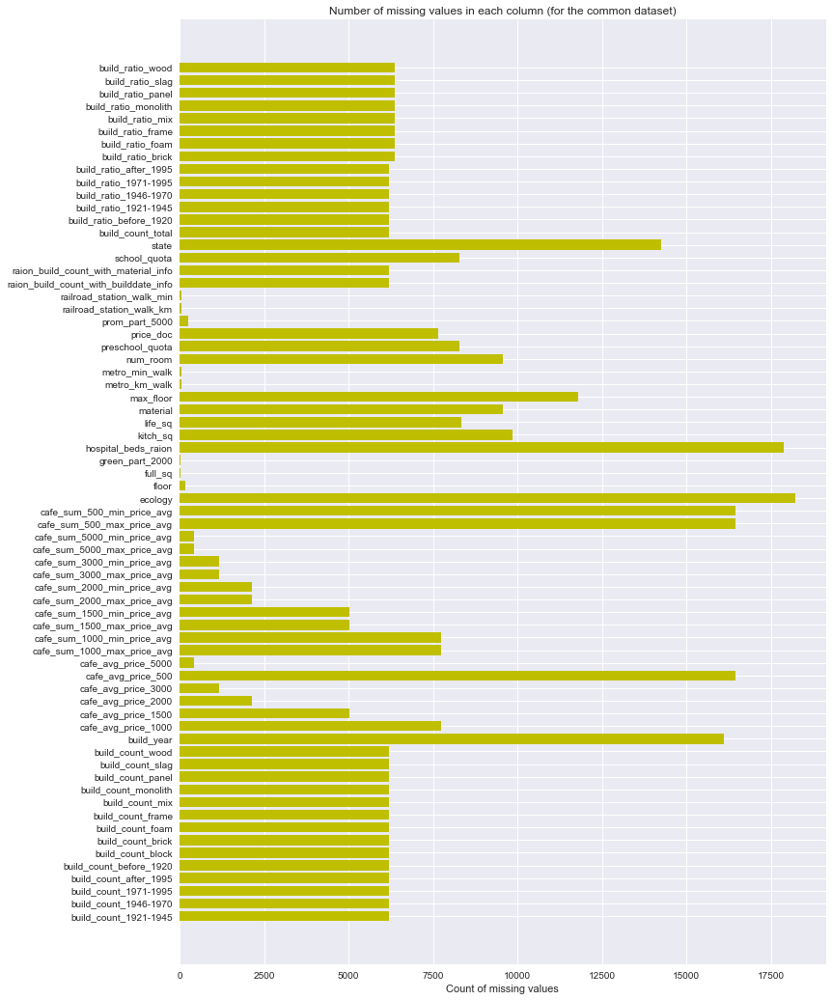

In [115]:
# Number of missing values in each column
missing_data = data.isnull().sum(axis = 0).reset_index()
missing_data.columns = ['column_name', 'missing_count']
missing_data = missing_data.ix[missing_data['missing_count'] > 0]
ind_data = np.arange(missing_data.shape[0])
fig, ax = plt.subplots(figsize = (12, 18))
ax.barh(ind_data, missing_data.missing_count.values, color = 'y')
ax.set_yticks(ind_data)
ax.set_yticklabels(missing_data.column_name.values, rotation = 'horizontal')
ax.set_xlabel("Count of missing values")
ax.set_title("Number of missing values in each column (for the common dataset)")
plt.show()

In [116]:
data.drop('error_flag', axis = 1, inplace = True)
del show_data
del data_show
del missing_data

In [117]:
data.shape

(38133, 308)

## Correlation

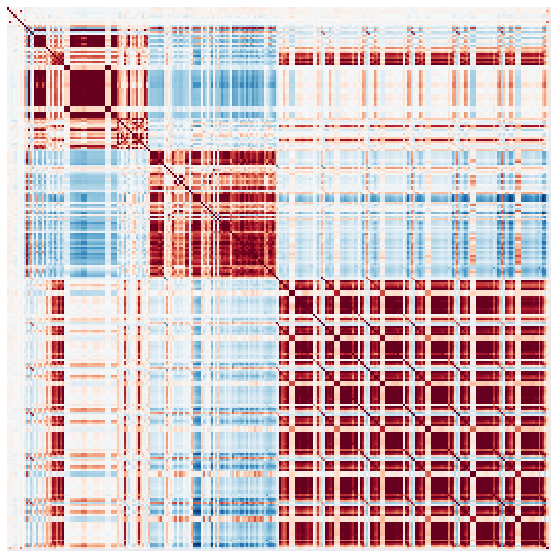

In [118]:
corrmat = train.corr()
f, ax = plt.subplots(figsize=(10, 10))
sns.heatmap(corrmat, vmax=.8, square=True,xticklabels=False,yticklabels=False,cbar=False)

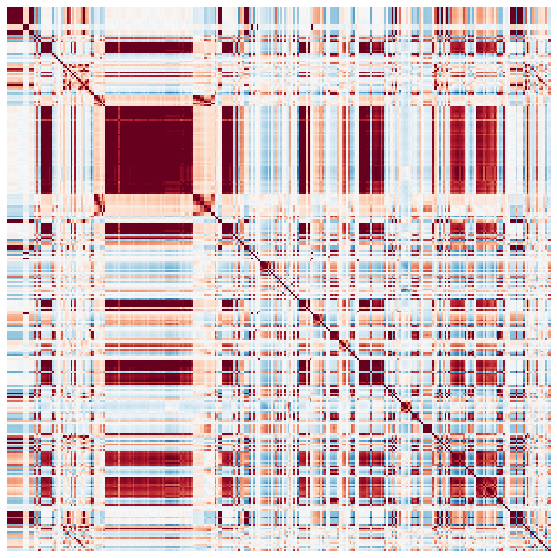

In [119]:
corrmat = data.corr()
f, ax = plt.subplots(figsize=(10, 10))
sns.heatmap(corrmat, vmax=.8, square=True,xticklabels=False,yticklabels=False,cbar=False)

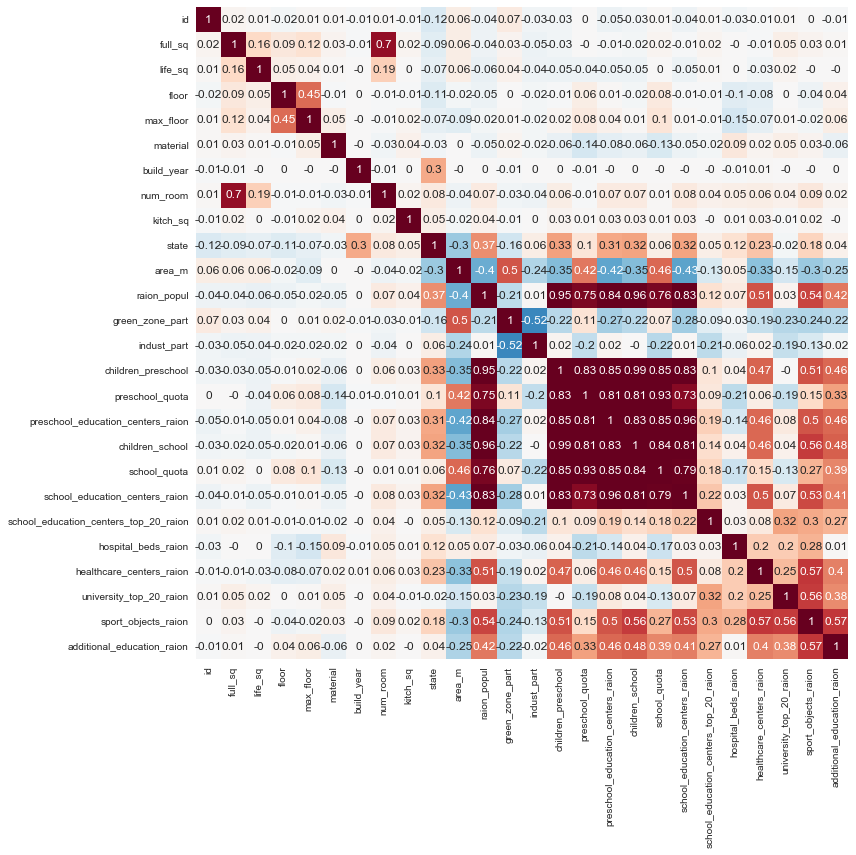

In [120]:
corrmat = train.ix[:, :30].corr().round(decimals = 2)
f, ax = plt.subplots(figsize = (12, 12))
sns.heatmap(corrmat, vmax = .8, square=True,xticklabels=True,yticklabels=True,cbar=False,annot=True)
sns.set(font_scale = 0.8)

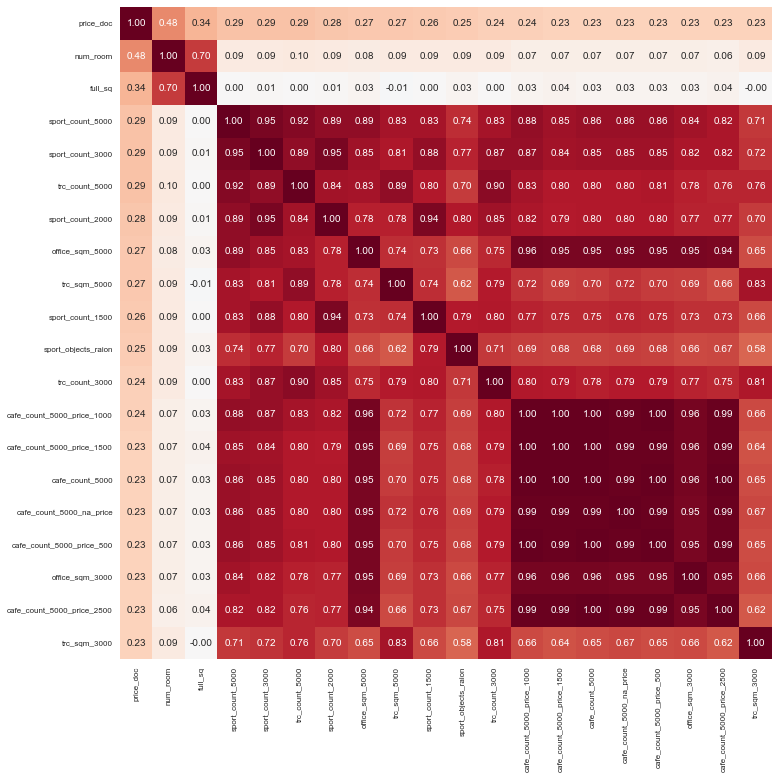

In [121]:
# Top 20 correlated variables
corrmat = train.corr()
k = 20 #number of variables for heatmap
cols = corrmat.nlargest(k, TARGET)[TARGET].index
#cm = np.corrcoef(train[cols].values.T)
cm = train[cols].corr().round(decimals = 2)
f, ax = plt.subplots(figsize=(12, 12))
sns.set(font_scale=1.25)
hm = sns.heatmap(cm, cbar=False, annot=True, square=True, fmt='.2f', annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values)
plt.show()

In [122]:
# Calculate the variable inflation factor for the numerical variables
from statsmodels.stats.outliers_influence import variance_inflation_factor
def find_multicollinearity(X):
    '''X - pandas dataframe'''
    thresh = 5.0
    variables = list(X.columns)
    #num_var = len(variables)
    vif = [variance_inflation_factor(X.as_matrix(), ix) for ix in range(X.shape[1])]
    columns_with_high_vif = []
    i = 1
    while max(vif) > thresh:
        print(i)
        maxloc = vif.index(max(vif))
        print('dropping ', X.columns[maxloc], ' with vif: ', vif[maxloc])
        columns_with_high_vif.append(X.columns[maxloc])
        variables.pop(maxloc)
        X = X[variables]
        vif = [variance_inflation_factor(X.as_matrix(), ix) for ix in range(X.shape[1])]
        i = i + 1
    print('Remaining variables:')
    print(X[variables].columns)
    return X, columns_with_high_vif

col_sel = data.columns[data.dtypes == 'int64'].append(data.columns[data.dtypes == 'float64'])
mytrain = data[data['istrain'] == 1]
X = mytrain[col_sel].dropna()
print(X.shape)

Y, columns_with_high_vif = find_multicollinearity(X)

(4750, 298)


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:167: RuntimeWarning: divide by zero encountered in double_scalars
  vif = 1. / (1. - r_squared_i)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1181: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1181: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - self.ssr/self.centered_tss


1
dropping  0_13_all  with vif:  inf
2
dropping  0_13_male  with vif:  inf
3
dropping  0_17_all  with vif:  inf
4
dropping  0_6_all  with vif:  inf
5
dropping  0_6_female  with vif:  inf
6
dropping  16_29_all  with vif:  inf
7
dropping  7_14_all  with vif:  inf
8
dropping  7_14_female  with vif:  inf
9
dropping  cafe_count_1000  with vif:  inf
10
dropping  cafe_count_1500  with vif:  inf
11
dropping  cafe_count_2000  with vif:  inf
12
dropping  cafe_count_3000  with vif:  inf
13
dropping  cafe_count_500  with vif:  inf
14
dropping  cafe_count_5000  with vif:  inf
15
dropping  ekder_all  with vif:  inf
16
dropping  ekder_female  with vif:  inf
17
dropping  female_f  with vif:  inf
18
dropping  work_all  with vif:  inf
19
dropping  young_all  with vif:  inf
20
dropping  build_count_1921-1945  with vif:  inf
21
dropping  build_count_block  with vif:  inf
22
dropping  build_count_brick  with vif:  inf
23
dropping  metro_km_walk  with vif:  inf
24
dropping  public_transport_station_km  with

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1183: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.uncentered_tss


44
dropping  cafe_sum_5000_max_price_avg  with vif:  735821.124699
45
dropping  young_female  with vif:  687187.628467
46
dropping  0_17_male  with vif:  186786.565199
47
dropping  raion_build_count_with_material_info  with vif:  166383.816555
48
dropping  cafe_sum_3000_max_price_avg  with vif:  123890.292898
49
dropping  bulvar_ring_km  with vif:  73722.1297019
50
dropping  0_17_female  with vif:  53067.6197159
51
dropping  cafe_sum_2000_max_price_avg  with vif:  36390.3168489
52
dropping  kremlin_km  with vif:  28986.6091346
53
dropping  build_count_frame  with vif:  26054.8469961
54
dropping  build_year  with vif:  17794.2086717
55
dropping  16_29_female  with vif:  14551.4258407
56
dropping  cafe_sum_1500_max_price_avg  with vif:  13470.9142078
57
dropping  work_female  with vif:  10418.9450417
58
dropping  sadovoe_km  with vif:  7861.43870734
59
dropping  7_14_male  with vif:  6730.536685
60
dropping  cafe_count_5000_price_1500  with vif:  4130.51441256
61
dropping  cafe_count_500

In [123]:
remaining_cols = list(Y.columns)
remaining_cols

['16_29_male',
 'big_church_count_500',
 'big_market_raion',
 'big_road1_1line',
 'cafe_count_1000_price_high',
 'cafe_count_500_price_1000',
 'cafe_count_500_price_4000',
 'cafe_count_500_price_high',
 'culture_objects_top_25',
 'detention_facility_raion',
 'incineration_raion',
 'leisure_count_500',
 'market_count_1000',
 'market_count_500',
 'mosque_count_1000',
 'mosque_count_1500',
 'mosque_count_2000',
 'mosque_count_3000',
 'mosque_count_500',
 'mosque_count_5000',
 'nuclear_reactor_raion',
 'office_sqm_500',
 'oil_chemistry_raion',
 'railroad_1line',
 'railroad_terminal_raion',
 'school_education_centers_top_20_raion',
 'sport_count_500',
 'thermal_power_plant_raion',
 'trc_count_500',
 'trc_sqm_1000',
 'university_top_20_raion',
 'water_1line',
 'additional_education_km',
 'build_count_before_1920',
 'ecology',
 'floor',
 'green_part_500',
 'green_zone_km',
 'green_zone_part',
 'hospital_beds_raion',
 'kindergarten_km',
 'material',
 'office_km',
 'preschool_km',
 'price_doc',

In [124]:
import pickle

with open('remaining_cols.txt', 'wb') as fp:
    pickle.dump(remaining_cols, fp)
    
### unpickling:
##with open("remaining_cols.txt", "rb") as fp:
##    remaining_cols = pickle.load(fp)

In [125]:
columns_with_high_vif

with open('columns_with_high_vif.txt', 'wb') as fp:
    pickle.dump(columns_with_high_vif, fp)

## Variables vs. target

count    30471.000000
mean        15.609483
std          0.604574
min         11.512935
25%         15.371548
50%         15.651990
75%         15.931766
max         18.526041
Name: log_price_doc, dtype: float64


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\nonparametric\kdetools.py:20: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  y = X[:m/2+1] + np.r_[0,X[m/2+1:],0]*1j


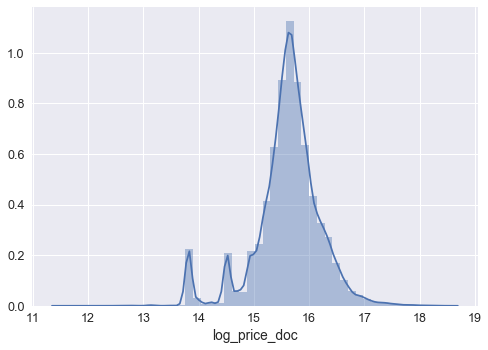

In [126]:
# Create the logarithm of the target variable because of skewness
LOGTARGET = 'log_price_doc'
data[LOGTARGET] = np.log(data[TARGET] + 1)
train[LOGTARGET] = np.log(data[TARGET] + 1)
print(data[LOGTARGET].describe())
sns.distplot(data[~np.isnan(data[LOGTARGET])][LOGTARGET])

In [ ]:
## uncomment the next two cells for the figures

In [172]:
## Categorical variables
#mytrain = data[data['istrain'] == 1].copy()
#sel_cols = mytrain.columns[mytrain.dtypes == 'object']
#sel_cols = [t for t in sel_cols if t not in ['Id', 'timestamp', 'apartment_name', TARGET, LOGTARGET]] 
#
#for col in sel_cols:
#    vals = mytrain[col].unique()
#    target_for_boxplot = []
#    logtarget_for_boxplot = []
#    for val in vals:
#        data_to_add = mytrain[mytrain[col] == val].copy()
#        target_to_add = data_to_add[TARGET]
#        target_for_boxplot.append(target_to_add)
#        logtarget_to_add = data_to_add[LOGTARGET]
#        logtarget_for_boxplot.append(logtarget_to_add)
#    fig, (ax1, ax2) = plt.subplots(nrows = 1, ncols = 2, figsize = (12, 5))
#    ax1.boxplot(target_for_boxplot)
#    ax2.boxplot(logtarget_for_boxplot)
#    ax1.set_xlabel(col, fontsize = 12)
#    ax1.set_xticklabels(vals)
#    ax1.set_ylabel(TARGET, fontsize = 12)
#    ax2.set_xlabel(col, fontsize = 12)
#    ax2.set_xticklabels(vals)
#    ax2.set_ylabel(LOGTARGET, fontsize = 12)
#    fig.show

In [173]:
## Numerical variables (both int64 and float64)
#sel_cols = mytrain.columns[mytrain.dtypes != 'object']
#sel_cols = [t for t in sel_cols if t not in ['Id', 'timestamp', TARGET, LOGTARGET]] 
#
#for col in sel_cols:
#    fig, (ax1, ax2) = plt.subplots(nrows = 1, ncols = 2, sharey = True, figsize = (12, 5))
#    ax1.scatter(mytrain[col], mytrain[TARGET])
#    ax2.scatter(mytrain[col], mytrain[TARGET])
#    ax1.set_xlabel(col, fontsize = 12)
#    ax2.set_xlabel(col, fontsize = 12)
#    ax1.set_ylabel(TARGET, fontsize = 12)
#    ax2.set_ylabel(LOGTARGET, fontsize = 12)
#    fig.show

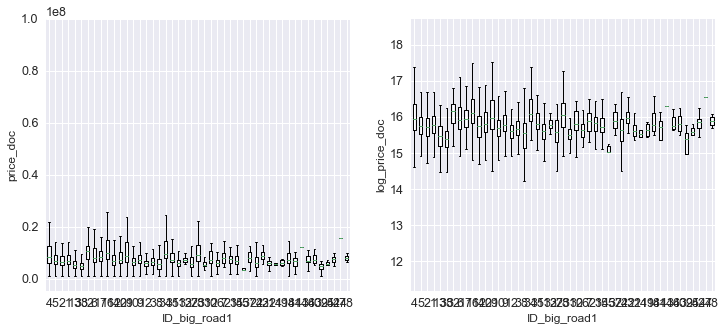

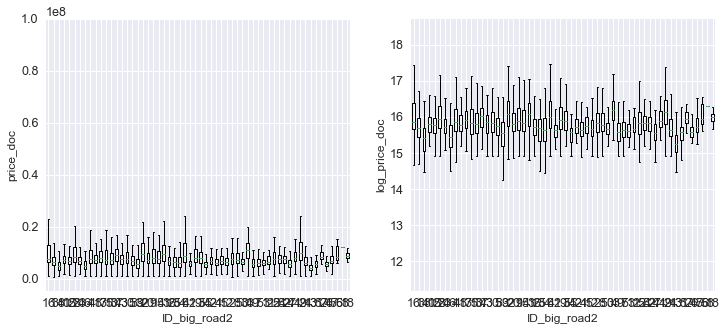

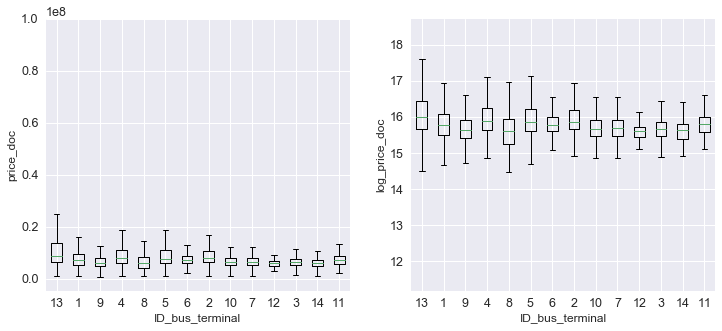

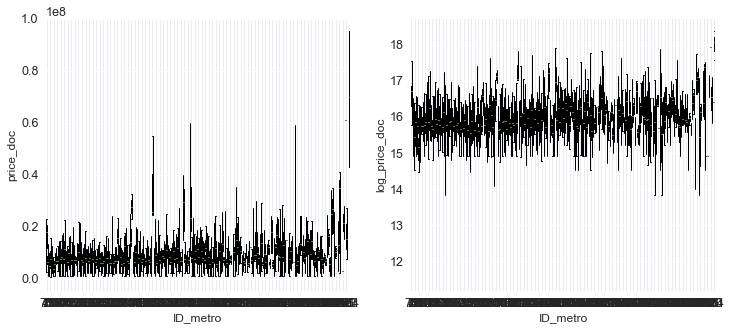

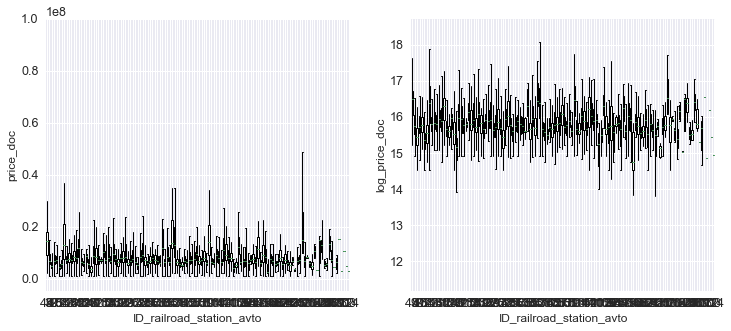

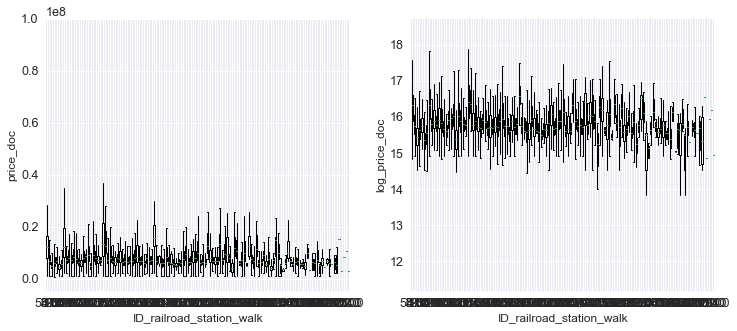

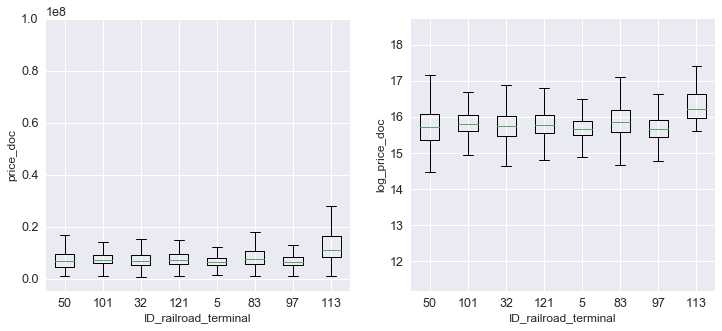

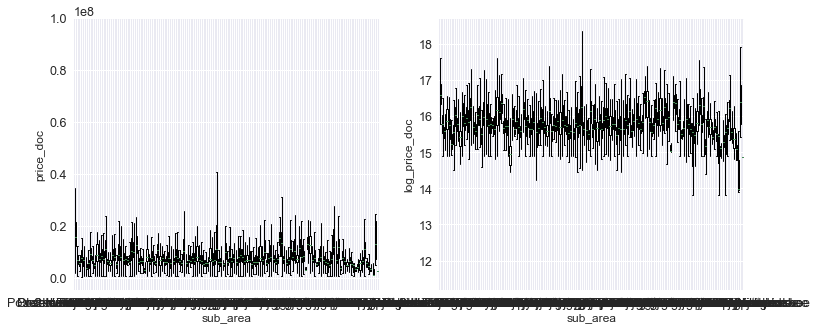

In [129]:
# In order to remove outliers restrict plots for data with full_sq < 1000, kitch_sq < 300, state < 5, industrial_km < 8, 
# cemetery_km < 7.5, incineration_km < 35, public_trainsport_station_km < 7.5, 
# additional_education_km < 15, church_synagogue_km < 5
restricted = mytrain.copy()
restricted = restricted[restricted['full_sq'] < 1000]
restricted = restricted[restricted['life_sq'] < 1500]
restricted = restricted[restricted['floor'] < 50]
restricted = restricted[restricted['kitch_sq'] < 300]
restricted = restricted[restricted['state'] < 5]
restricted = restricted[restricted['industrial_km'] < 8]
restricted = restricted[restricted['cemetery_km'] < 7.5] 
restricted = restricted[restricted['incineration_km'] < 35]
restricted = restricted[restricted['public_transport_station_km'] < 7.5]
restricted = restricted[restricted['additional_education_km'] < 15]
restricted = restricted[restricted['church_synagogue_km'] < 5]

# Categorical variables
sel_cols = restricted.columns[restricted.dtypes == 'object']
sel_cols = [t for t in sel_cols if t not in ['Id', 'timestamp', 'apartment_name', TARGET, LOGTARGET]] 

for col in sel_cols:
    vals = restricted[col].unique()
    target_for_boxplot = []
    logtarget_for_boxplot = []
    for val in vals:
        data_to_add = restricted[restricted[col] == val].copy()
        target_to_add = data_to_add[TARGET]
        target_for_boxplot.append(target_to_add)
        logtarget_to_add = data_to_add[LOGTARGET]
        logtarget_for_boxplot.append(logtarget_to_add)
    fig, (ax1, ax2) = plt.subplots(nrows = 1, ncols = 2, figsize = (12, 5))
    ax1.boxplot(target_for_boxplot)
    ax2.boxplot(logtarget_for_boxplot)
    ax1.set_xlabel(col, fontsize = 12)
    ax1.set_xticklabels(vals)
    ax1.set_ylabel(TARGET, fontsize = 12)
    ax2.set_xlabel(col, fontsize = 12)
    ax2.set_xticklabels(vals)
    ax2.set_ylabel(LOGTARGET, fontsize = 12)
    fig.show

C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


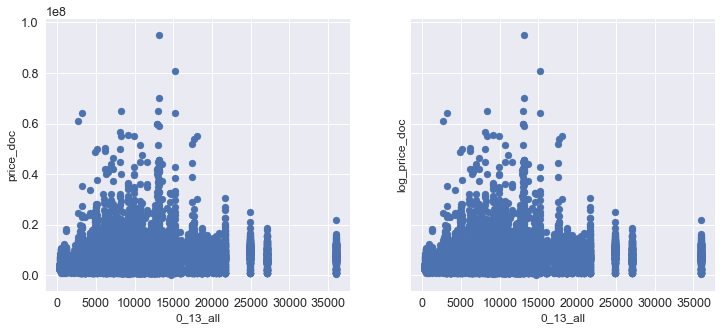

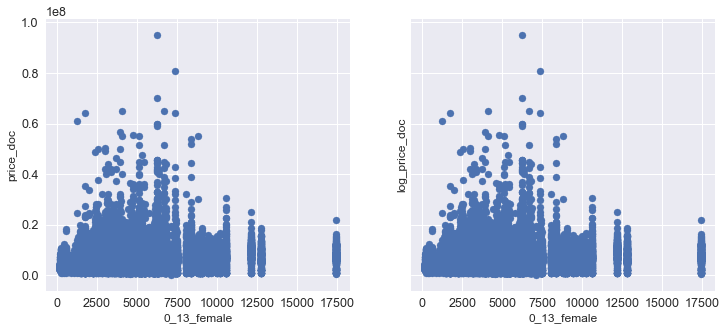

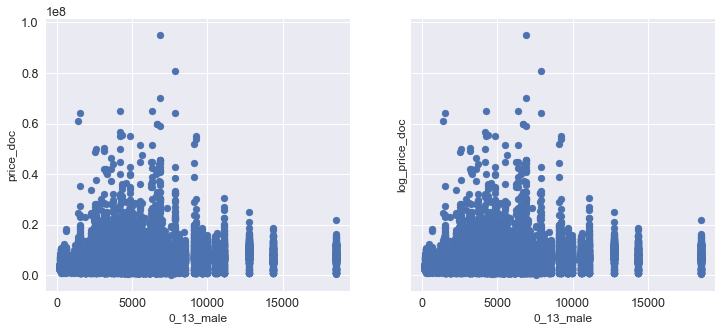

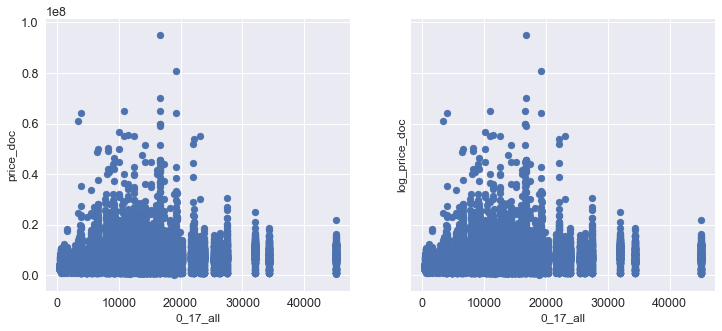

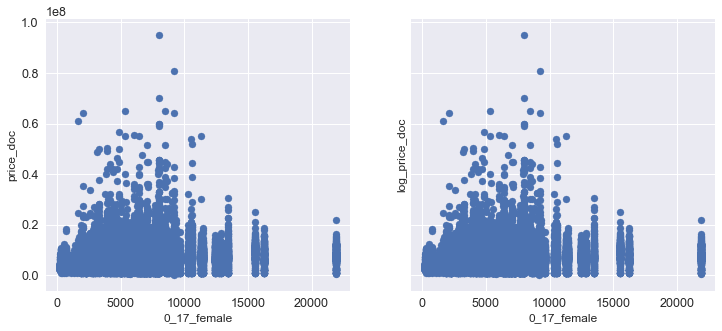

...

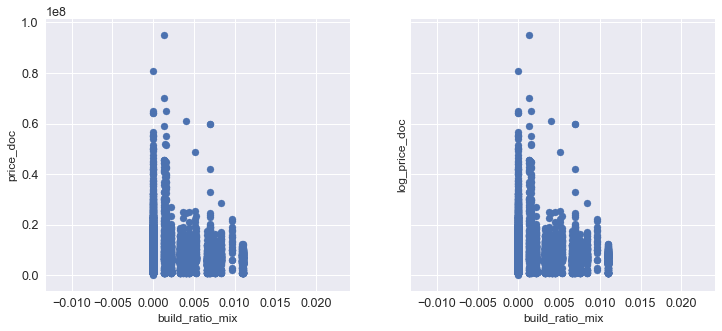

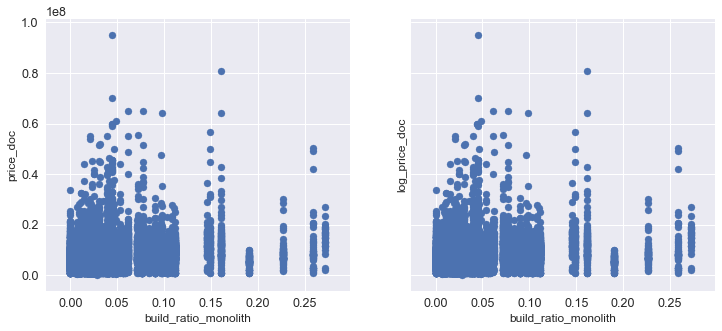

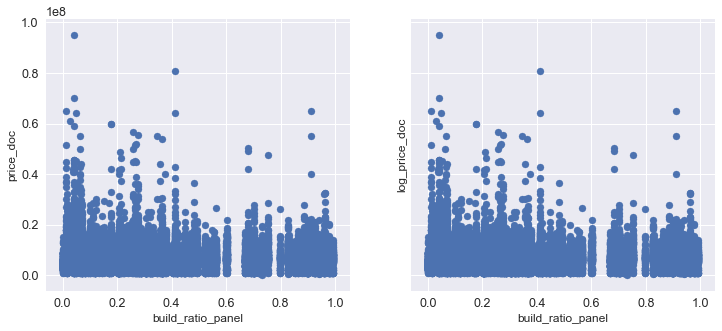

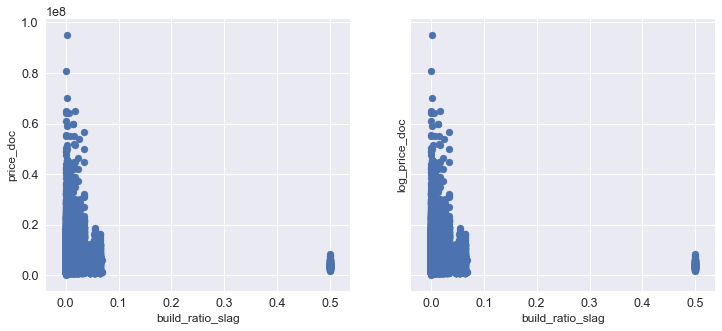

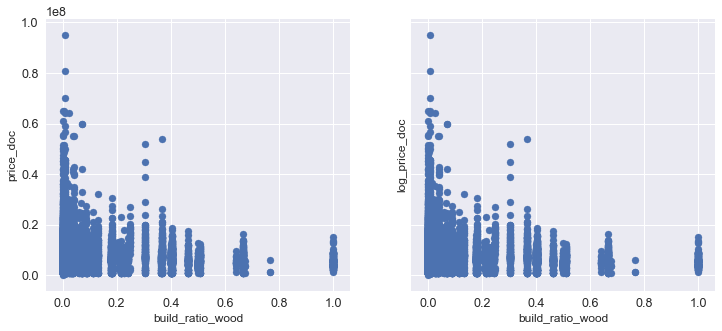

In [130]:
# Numerical variables (both int64 and float64)
sel_cols = restricted.columns[mytrain.dtypes != 'object']
sel_cols = [t for t in sel_cols if t not in ['Id', 'timestamp', TARGET, LOGTARGET]] 

for col in sel_cols:
    fig, (ax1, ax2) = plt.subplots(nrows = 1, ncols = 2, sharey = True, figsize = (12, 5))
    ax1.scatter(restricted[col], restricted[TARGET])
    ax2.scatter(restricted[col], restricted[TARGET])
    ax1.set_xlabel(col, fontsize = 12)
    ax2.set_xlabel(col, fontsize = 12)
    ax1.set_ylabel(TARGET, fontsize = 12)
    ax2.set_ylabel(LOGTARGET, fontsize = 12)
    fig.show

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:141: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\function_base.py:3834: RuntimeWarning: Invalid value encountered in percentile
  RuntimeWarning)


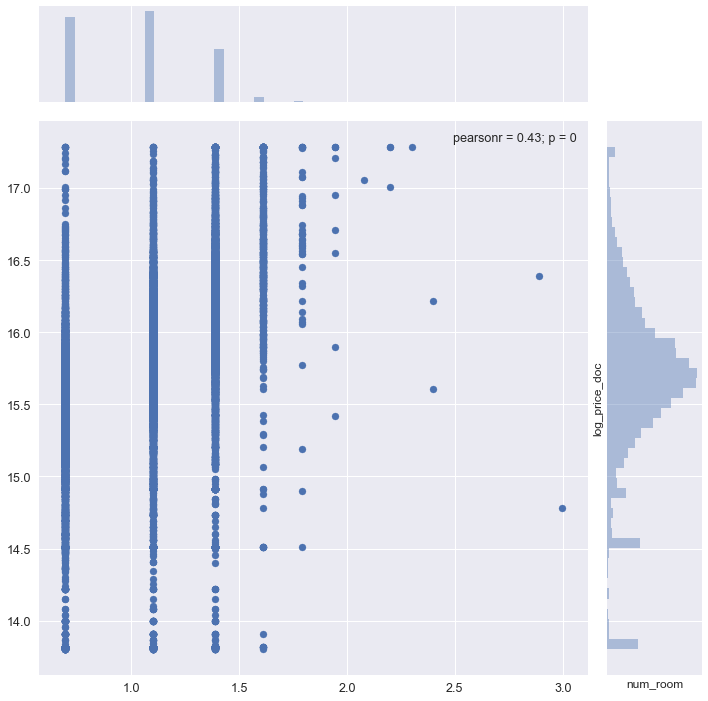

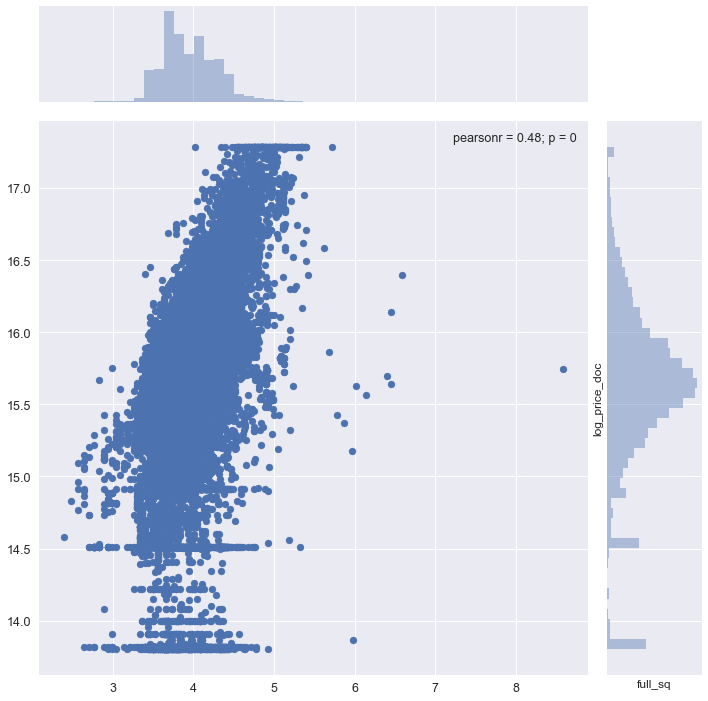

In [131]:
# Plots for LOGTARGET vs. the most correlated variables
def plot_target_vs_logvars(train, target, vars):
    # Truncate largest and lowest values
    ulimit = np.percentile(train[target].values, 99.5)
    llimit = np.percentile(train[target].values, 0.5)
    train[target].ix[train[target] > ulimit] = ulimit
    train[target].ix[train[target] < llimit] = llimit

    for var in vars:
        ulimit = np.percentile(train[var].values, 99.5)
        llimit = np.percentile(train[var].values, 0.5)
        train[var].ix[train[var] > ulimit] = ulimit
        train[var].ix[train[var] < llimit] = llimit
        plt.figure(figsize = (12, 12))
        sns.jointplot(x = np.log1p(train[var].values), y = train[target].values, size = 10)
        plt.ylabel(target, fontsize = 12)
        plt.xlabel(var, fontsize = 12)
        plt.show()

plot_target_vs_logvars(mytrain, LOGTARGET, ['num_room', 'full_sq'])

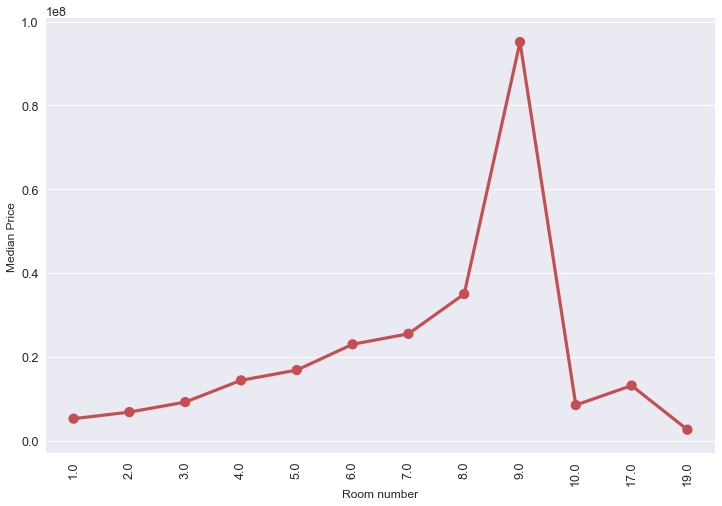

In [132]:
grouped_df = mytrain.groupby('num_room')[TARGET].aggregate(np.median).reset_index()
plt.figure(figsize = (12, 8))
sns.pointplot(grouped_df.num_room.values, grouped_df.price_doc.values, alpha = 0.8, color = sns.color_palette()[2])
plt.ylabel('Median Price', fontsize = 12)
plt.xlabel('Room number', fontsize = 12)
plt.xticks(rotation = 'vertical')
plt.show()

## Create new variables and transform some numeric variables into categorical ones

In [133]:
# Create new variables
data['0_13_maleratio'] = data['0_13_male'] / data['0_13_all']
data['0_17_maleratio'] = data['0_17_male'] / data['0_17_all']
data['0_6_maleratio'] = data['0_6_male'] / data['0_6_all']
data['16_29_maleratio'] = data['16_29_male'] / data['16_29_all']
data['7_14_maleratio'] = data['7_14_male'] / data['7_14_all']
data['ekder_maleratio'] = data['ekder_male'] / data['ekder_all']
data['maleratio'] = data['male_f'] / data['full_all']

data['0_6_ratio_to_all'] = data['0_6_all'] / data['full_all']
data['0_17_ratio_to_all'] = data['0_17_all'] / data['full_all']
data['0_13_ratio_to_all'] = data['0_13_all'] / data['full_all']
data['16_29_ratio_to_all'] = data['16_29_all'] / data['full_all']
data['7_14_ratio_to_all'] = data['7_14_all'] / data['full_all']
data['ekder_ratio_to_all'] = data['ekder_all'] / data['full_all']

data['workingage_ratio_to_all'] = data['work_all'] / data['full_all']
data['workingage_ratio_to_young'] = data['work_all'] / data['young_all']
data['workingage_ratio_to_ekder'] = data['work_all'] / data['ekder_all']

In [134]:
data['ratio_of_houses_close yr'] = data.apply(lambda row : 
                                              row['build_ratio_before_1920'] if row['build_year'] < 1921 
                                              else row['build_ratio_1921-1945'] if row['build_year'] < 1945
                                              else row['build_ratio_1946-1970'] if row['build_year'] < 1971 
                                              else row['build_ratio_1971-1995'] if row['build_year'] < 1995
                                              else row['build_ratio_after_1995'], axis = 1)
data['ratio_of_older_houses'] = data.apply(lambda row : 
                                           0 if row['build_year'] < 1921
                                           else row['build_ratio_before_1920'] if row['build_year'] < 1945
                                           else row['build_ratio_before_1920'] + row['build_ratio_1921-1945'] if row['build_year'] < 1971
                                           else row['build_ratio_before_1920'] + row['build_ratio_1921-1945'] + row['build_ratio_1946-1970'] if row['build_year'] < 1995
                                           else row['build_ratio_before_1920'] + row['build_ratio_1921-1945'] + row['build_ratio_1946-1970'] + row['build_ratio_1971-1995'], axis = 1)
data['ratio_of_younger_houses'] = data.apply(lambda row:
                                             row['build_ratio_1921-1945'] + row['build_ratio_1946-1970'] + row['build_ratio_1971-1995'] + row['build_ratio_after_1995']  if row['build_year'] < 1921
                                             else row['build_ratio_1946-1970'] + row['build_ratio_1971-1995'] + row['build_ratio_after_1995']  if row['build_year'] < 1946
                                             else row['build_ratio_1971-1995'] + row['build_ratio_after_1995'] if row['build_year'] < 1971
                                             else row['build_ratio_after_1995'] if row['build_year'] < 1995
                                             else 0, axis = 1)

data['nonlife_sq'] = data['full_sq'] - data['life_sq']
data['ratio_nonlifesq_to_lifesq'] = data['nonlife_sq'] / data['life_sq']
data['ratio_fullsq_to_lifesq'] = data['full_sq'] / data['life_sq']
data['nonkitch_life_sq'] = data['life_sq'] - data['kitch_sq']
data['ratio_kitchsq_to_lifesq'] = data['kitch_sq'] / data['life_sq']
data['at_max_floor'] = data.apply(lambda row : 1 if row['max_floor'] == row['floor'] else 0, axis = 1)
data['aver_room_sq'] = (data['life_sq'] - data['kitch_sq']) / data['num_room']

# Transform variables into categorical
data['material'] = data['material'].apply(str)
data['state'] = data['state'].apply(str)

In [135]:
import datetime
data['timestamp'] = pd.to_datetime(data['timestamp'], errors='coerce')
data['year'] = data['timestamp'].dt.year
data['month'] = data['timestamp'].dt.month
data['day'] = data['timestamp'].dt.day
data['weekofyear'] = data['timestamp'].dt.week
data['weekday'] = data['timestamp'].dt.weekday
data['quarter'] = data['timestamp'].dt.quarter
data['dayofyear'] = (data['month'] - 1) * 31 + data['day']

firstyr = min(data['year'])  # 2011
data['quarters_from_2011-01-01'] = (data['year'] - firstyr) * 4 + data['quarter']
data['months_from_2011-01-01'] = (data['year'] - firstyr) * 12 + data['month']
data['weeks_from_2011-01-01'] = (data['year'] - firstyr) * 52 + data['weekofyear']


In [136]:
# New feature suggested by Bhavesh Ghodasara (https://www.kaggle.com/c/sberbank-russian-housing-market/discussion/33269)
# data['apartment_name'] = data['sub_area'] + data['metro_km_avto'].astype(str)
# id 18344 got full_sq as 634. Now may houses of Nekrasovka and with the same distance from metro are there. But none of them 
# got such huge full_sq. however there are many house in same area with 63 square meters. so this must be typo and we can clean 
# this value. Similarly we can populate missing but important feature like floor, max floor and life_sq from there.

# feature apartment_name_month_year has no shared information between train and test... therefore, it may overfit the model
# week_yr_cnt
# month_yr_cnt
# apartment_name_month_yr_cnt

In [137]:
data['apartment_name_yr_month'] = data['apartment_name'] + '_' + data['year'].astype(str) + data['month'].astype(str)
data_agg = data.groupby('apartment_name_yr_month').size()
len(data_agg[data_agg > 1]) / len(data_agg[data_agg == 1])
#data['apartment_name_yr_month_cnt'] = 

0.10684195530953641

In [138]:
right_df = pd.DataFrame(data_agg.index, data_agg)
right_df['count'] = right_df['apartment_name_yr_month'].apply(lambda x : data_agg.loc[x])
data = pd.merge(data, right_df, how = 'left', left_on = 'apartment_name_yr_month', right_on = 'apartment_name_yr_month')
data.head()

,0_13_all,0_13_female,0_13_male,0_17_all,0_17_female,0_17_male,0_6_all,0_6_female,0_6_male,16_29_all,...,day,weekofyear,weekday,quarter,dayofyear,quarters_from_2011-01-01,months_from_2011-01-01,weeks_from_2011-01-01,apartment_name_yr_month,count
0,18654,8945,9709,23603,11317,12286,9576,4677,4899,17508,...,20,33,5,3,237,3,8,33,Bibirevo1.131259906_20118,1
1,13729,6800,6929,17700,8702,8998,6880,3414,3466,15164,...,23,34,1,3,240,3,8,34,Nagatinskij Zaton0.647336757_20118,1
2,11252,5336,5916,14884,7063,7821,5879,2784,3095,19401,...,27,34,5,3,244,3,8,34,Tekstil'shhiki1.637996285_20118,1
3,24934,12152,12782,32063,15550,16513,13087,6442,6645,3292,...,1,35,3,3,249,3,9,35,Mitino0.984536582_20119,1
4,11631,5408,6223,15237,7124,8113,5706,2724,2982,5164,...,5,36,0,3,253,3,9,36,Basmannoe0.876620232_20119,1


## Load macro data and make some feature engineering

In [139]:
# Load macro data
macro = pd.read_csv(MACRO_FILE)
macro.head()

,timestamp,oil_urals,gdp_quart,gdp_quart_growth,cpi,ppi,gdp_deflator,balance_trade,balance_trade_growth,usdrub,...,provision_retail_space_modern_sqm,turnover_catering_per_cap,theaters_viewers_per_1000_cap,seats_theather_rfmin_per_100000_cap,museum_visitis_per_100_cap,bandwidth_sports,population_reg_sports_share,students_reg_sports_share,apartment_build,apartment_fund_sqm
0,2010-01-01,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
1,2010-01-02,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
2,2010-01-03,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
3,2010-01-04,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29.905,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
4,2010-01-05,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29.836,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN


In [140]:
macro.shape

(2484, 100)

In [141]:
# Find columns with numeric (int or float) values and nonnumeric (categorical) variables in the macro data
macro_nonnumeric_cols = macro.dtypes[macro.dtypes == 'object'].index.copy()
macro_numeric_cols = macro.dtypes[macro.dtypes != 'object'].index.copy()
print(macro_nonnumeric_cols)
print(macro_numeric_cols)

Index(['timestamp', 'child_on_acc_pre_school', 'modern_education_share',
       'old_education_build_share'],
      dtype='object')
Index(['oil_urals', 'gdp_quart', 'gdp_quart_growth', 'cpi', 'ppi',
       'gdp_deflator', 'balance_trade', 'balance_trade_growth', 'usdrub',
       'eurrub', 'brent', 'net_capital_export', 'gdp_annual',
       'gdp_annual_growth', 'average_provision_of_build_contract',
       'average_provision_of_build_contract_moscow', 'rts', 'micex',
       'micex_rgbi_tr', 'micex_cbi_tr', 'deposits_value', 'deposits_growth',
       'deposits_rate', 'mortgage_value', 'mortgage_growth', 'mortgage_rate',
       'grp', 'grp_growth', 'income_per_cap',
       'real_dispos_income_per_cap_growth', 'salary', 'salary_growth',
       'fixed_basket', 'retail_trade_turnover',
       'retail_trade_turnover_per_cap', 'retail_trade_turnover_growth',
       'labor_force', 'unemployment', 'employment',
       'invest_fixed_capital_per_cap', 'invest_fixed_assets',
       'profitable_ente

In [142]:
## Number of variables with different dtypes in the macro data
macro.dtypes.value_counts()

float64    94
object      4
int64       2
dtype: int64

In [143]:
def describe_macro_variable(dt):
    print('--------------------------------------------')
    for c in macro.columns:
        if macro[c].dtype == dt:
            t = macro[c]
            if dt == "object":
                f = t[pd.isnull(t) == False].value_counts()
            else:
                f = t[pd.isnull(t) == False].describe()
            m = sum(t.isnull())
            print(dt + ' - ' + c)
            print('Number of unique values: %d' % (len(t.value_counts())))
            print('Number of missing values: %d' %  m)
            if dt == 'object':
                if len(t.value_counts())<=10:
                    print(f.sort_values(ascending = False))         # does it work?
                else:
                    print(f.sort_values(ascending = False)[:15])
            else:
                print(f)
            
            if dt != "object":
                if len(t.value_counts())<=10:
                    print(t.value_counts())
            print('=' * 30)

In [144]:
describe_macro_variable('int64')

--------------------------------------------
int64 - deposits_value
Number of unique values: 74
Number of missing values: 0
count    2.484000e+03
mean     1.504170e+07
std      4.762312e+06
min      7.484970e+06
25%      1.087608e+07
50%      1.521005e+07
75%      1.907733e+07
max      2.345319e+07
Name: deposits_value, dtype: float64
int64 - mortgage_value
Number of unique values: 81
Number of missing values: 0
count    2.484000e+03
mean     5.007981e+05
std      3.946050e+05
min      8.016000e+03
25%      1.791530e+05
50%      4.241050e+05
75%      7.660090e+05
max      1.753294e+06
Name: mortgage_value, dtype: float64


In [145]:
describe_macro_variable('float64')

--------------------------------------------
float64 - oil_urals
Number of unique values: 81
Number of missing values: 0
count    2484.000000
mean       86.467157
std        27.528709
min        29.112500
25%        61.283300
50%       101.416500
75%       109.310000
max       122.520000
Name: oil_urals, dtype: float64
float64 - gdp_quart
Number of unique values: 26
Number of missing values: 90
count     2394.000000
mean     16993.230075
std       3187.074480
min       9995.800000
25%      14925.000000
50%      17442.100000
75%      19284.100000
max      22016.100000
Name: gdp_quart, dtype: float64
float64 - gdp_quart_growth
Number of unique values: 23
Number of missing values: 90
count    2394.000000
mean        1.523726
std         2.875659
min        -4.500000
25%         0.400000
50%         1.300000
75%         4.100000
max         5.200000
Name: gdp_quart_growth, dtype: float64
float64 - cpi
Number of unique values: 78
Number of missing values: 31
count    2453.000000
mean      4

In [146]:
describe_macro_variable('object')

--------------------------------------------
object - timestamp
Number of unique values: 2484
Number of missing values: 0
2015-10-26    1
2016-01-16    1
2012-09-12    1
2013-12-31    1
2011-02-01    1
2012-06-15    1
2015-01-01    1
2010-01-17    1
2010-07-22    1
2011-10-21    1
2010-12-12    1
2015-12-17    1
2011-05-15    1
2010-06-22    1
2014-10-04    1
Name: timestamp, dtype: int64
object - child_on_acc_pre_school
Number of unique values: 5
Number of missing values: 658
7,311     366
16,765    365
3,013     365
#!        365
45,713    365
Name: child_on_acc_pre_school, dtype: int64
object - modern_education_share
Number of unique values: 3
Number of missing values: 1389
93,08      365
95,4918    365
90,92      365
Name: modern_education_share, dtype: int64
object - old_education_build_share
Number of unique values: 3
Number of missing values: 1389
25,47     365
8,2517    365
23,14     365
Name: old_education_build_share, dtype: int64


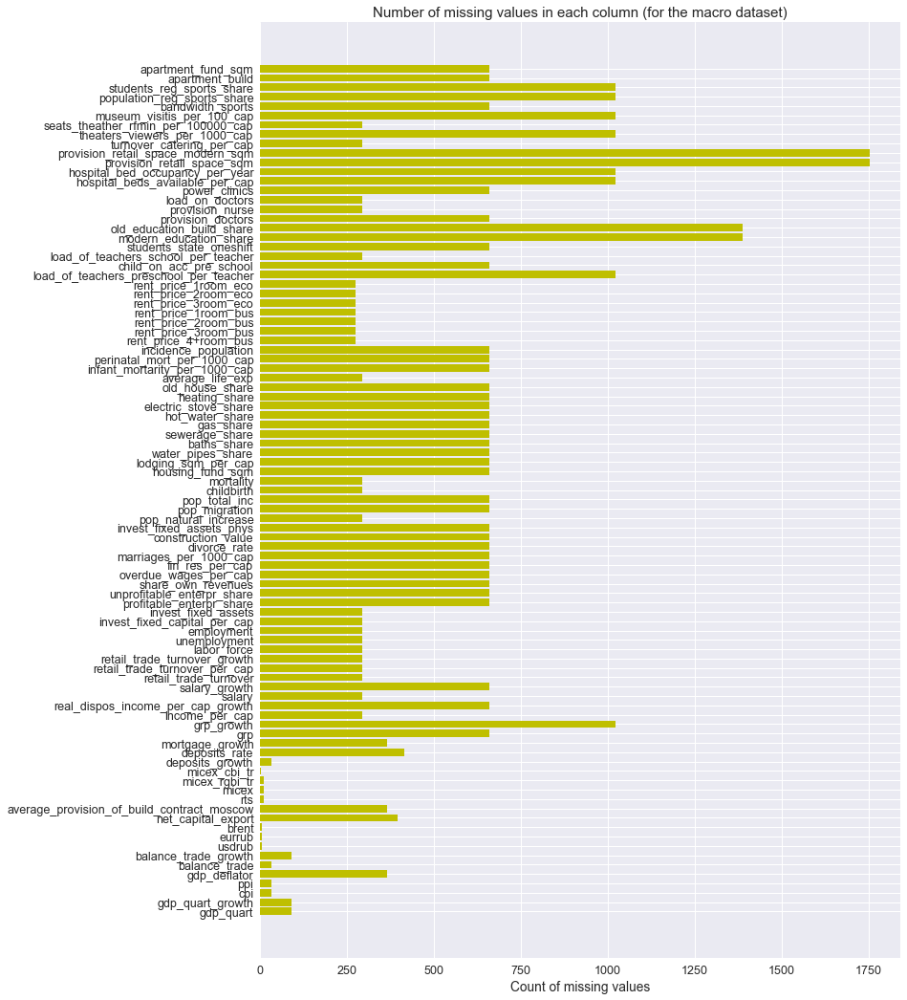

In [147]:
# Number of missing values in each column of macro data
missing_macro = macro.isnull().sum(axis = 0).reset_index()
missing_macro.columns = ['column_name', 'missing_count']
missing_macro = missing_macro.ix[missing_macro['missing_count'] > 0]
ind_macro = np.arange(missing_macro.shape[0])
fig, ax = plt.subplots(figsize = (12, 18))
ax.barh(ind_macro, missing_macro.missing_count.values, color = 'y')
ax.set_yticks(ind_macro)
ax.set_yticklabels(missing_macro.column_name.values, rotation = 'horizontal')
ax.set_xlabel("Count of missing values")
ax.set_title("Number of missing values in each column (for the macro dataset)")
plt.show()

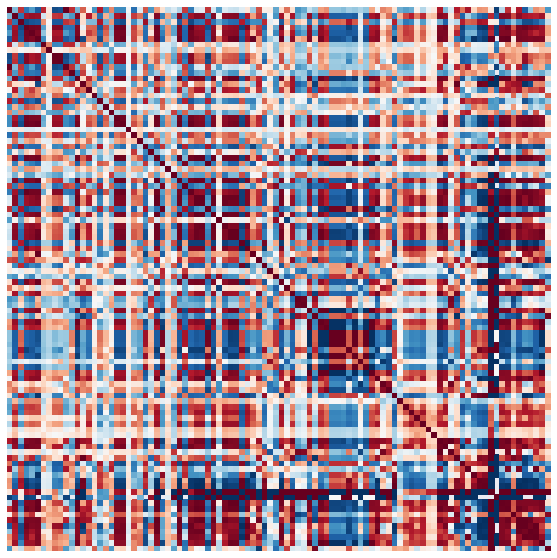

In [148]:
# Check correlation for macro data
corrmat = macro.corr()
f, ax = plt.subplots(figsize=(10, 10))
sns.heatmap(corrmat, vmax=.8, square=True,xticklabels=False,yticklabels=False,cbar=False)

In [149]:
# Calculate the variable inflation factor for the numerical variables in macro data

col_sel_macro = macro.columns[macro.dtypes == 'int64'].append(macro.columns[macro.dtypes == 'float64'])
X_macro = macro[col_sel_macro].dropna()
print(X_macro.shape)

Y_macro, macro_columns_with_high_vif = find_multicollinearity(X_macro)

(334, 96)


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:167: RuntimeWarning: divide by zero encountered in double_scalars
  vif = 1. / (1. - r_squared_i)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1181: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - self.ssr/self.centered_tss


1
dropping  deposits_value  with vif:  inf
2
dropping  mortgage_value  with vif:  inf
3
dropping  oil_urals  with vif:  inf
4
dropping  gdp_quart_growth  with vif:  inf
5
dropping  cpi  with vif:  inf
6
dropping  balance_trade  with vif:  inf
7
dropping  ppi  with vif:  inf
8
dropping  net_capital_export  with vif:  inf
9
dropping  balance_trade_growth  with vif:  inf
10
dropping  average_provision_of_build_contract  with vif:  inf
11
dropping  average_provision_of_build_contract_moscow  with vif:  inf
12
dropping  deposits_rate  with vif:  inf
13
dropping  mortgage_growth  with vif:  inf
14
dropping  mortgage_rate  with vif:  inf
15
dropping  rent_price_1room_eco  with vif:  7375182.82343
16
dropping  gdp_quart  with vif:  667.707334307
17
dropping  rts  with vif:  518.262829353
18
dropping  usdrub  with vif:  32.4339899333
19
dropping  micex  with vif:  20.9512762377
20
dropping  rent_price_2room_eco  with vif:  19.1529226446
21
dropping  rent_price_3room_eco  with vif:  11.099377961

In [150]:
Y_macro.columns

Index(['gdp_deflator', 'brent', 'gdp_annual', 'gdp_annual_growth',
       'micex_rgbi_tr', 'micex_cbi_tr', 'deposits_growth', 'grp', 'grp_growth',
       'income_per_cap', 'real_dispos_income_per_cap_growth', 'salary',
       'salary_growth', 'fixed_basket', 'retail_trade_turnover',
       'retail_trade_turnover_per_cap', 'retail_trade_turnover_growth',
       'labor_force', 'unemployment', 'employment',
       'invest_fixed_capital_per_cap', 'invest_fixed_assets',
       'profitable_enterpr_share', 'unprofitable_enterpr_share',
       'share_own_revenues', 'overdue_wages_per_cap', 'fin_res_per_cap',
       'marriages_per_1000_cap', 'divorce_rate', 'construction_value',
       'invest_fixed_assets_phys', 'pop_natural_increase', 'pop_migration',
       'pop_total_inc', 'childbirth', 'mortality', 'housing_fund_sqm',
       'lodging_sqm_per_cap', 'water_pipes_share', 'baths_share',
       'sewerage_share', 'gas_share', 'hot_water_share',
       'electric_stove_share', 'heating_share', 'ol

In [151]:
macro_columns_with_high_vif

['deposits_value',
 'mortgage_value',
 'oil_urals',
 'gdp_quart_growth',
 'cpi',
 'balance_trade',
 'ppi',
 'net_capital_export',
 'balance_trade_growth',
 'average_provision_of_build_contract',
 'average_provision_of_build_contract_moscow',
 'deposits_rate',
 'mortgage_growth',
 'mortgage_rate',
 'rent_price_1room_eco',
 'gdp_quart',
 'rts',
 'usdrub',
 'micex',
 'rent_price_2room_eco',
 'rent_price_3room_eco',
 'eurrub']

In [152]:
macro_remaining_cols = list(Y_macro.columns)

import pickle

with open('macro_remaining_cols.txt', 'wb') as fp:
    pickle.dump(macro_remaining_cols, fp)

with open('macro_columns_with_high_vif.txt', 'wb') as f:
    pickle.dump(macro_columns_with_high_vif, f)

In [153]:
# Create new features for macro data

macro['timestamp'] = pd.to_datetime(macro['timestamp'], errors='coerce')
macro['year'] = macro['timestamp'].dt.year
macro['month'] = macro['timestamp'].dt.month
macro['day'] = macro['timestamp'].dt.day
macro['weekofyear'] = macro['timestamp'].dt.week
macro['weekofyear'] = macro.apply(lambda row : 0 if ((row['weekofyear'] > 50) & (row['month'] == 1)) else row['weekofyear'], 
                                  axis = 1)
macro['weekday'] = macro['timestamp'].dt.weekday
macro['quarter'] = macro['timestamp'].dt.quarter
macro['dayofyear'] = (macro['month'] - 1) * 31 + macro['day']

# firstyr = min(data['year'])  # 2011, defined earlier
macro['quarters_from_2011-01-01'] = (macro['year'] - firstyr) * 4 + macro['quarter']
macro['months_from_2011-01-01'] = (macro['year'] - firstyr) * 12 + macro['month']
macro['weeks_from_2011-01-01'] = (macro['year'] - firstyr) * 52 + macro['weekofyear']

In [154]:
macro.head()

,timestamp,oil_urals,gdp_quart,gdp_quart_growth,cpi,ppi,gdp_deflator,balance_trade,balance_trade_growth,usdrub,...,year,month,day,weekofyear,weekday,quarter,dayofyear,quarters_from_2011-01-01,months_from_2011-01-01,weeks_from_2011-01-01
0,2010-01-01,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2010,1,1,0,4,1,1,-3,-11,-52
1,2010-01-02,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2010,1,2,0,5,1,2,-3,-11,-52
2,2010-01-03,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2010,1,3,0,6,1,3,-3,-11,-52
3,2010-01-04,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29.905,...,2010,1,4,1,0,1,4,-3,-11,-51
4,2010-01-05,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29.836,...,2010,1,5,1,1,1,5,-3,-11,-51


In [155]:
# Create some plots
def create_time_series_plots(dataset, timevar, var):
    grouped_dataset = dataset.groupby(timevar)[var].aggregate(np.mean).reset_index()
    plt.figure(figsize = (15, 6))
    sns.pointplot(grouped_dataset[timevar].values, grouped_dataset[var].values, alpha = 0.8, color = sns.color_palette()[2])
    plt.ylabel('Mean of %s' % var, fontsize = 12)
    plt.xlabel('Time', fontsize = 12)
    plt.xticks(rotation = 'vertical')
    plt.show()

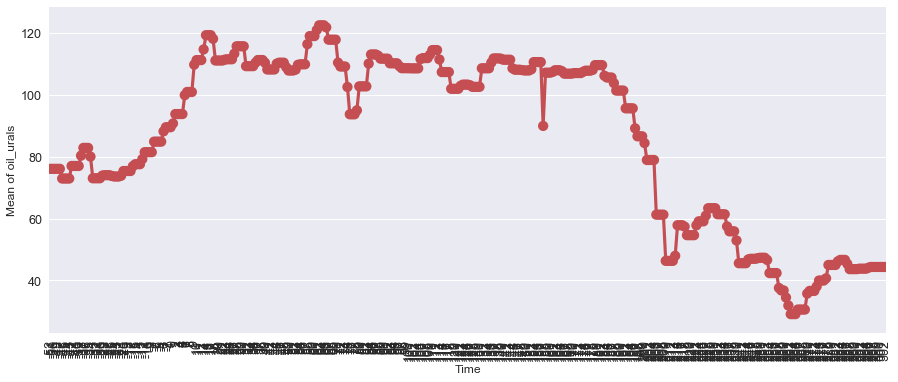

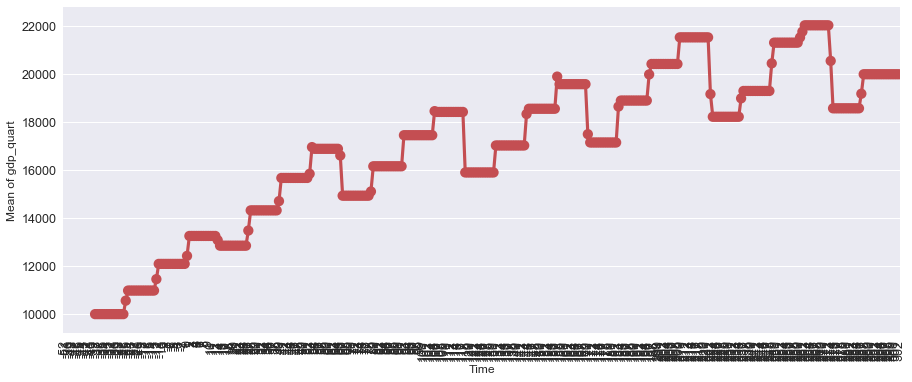

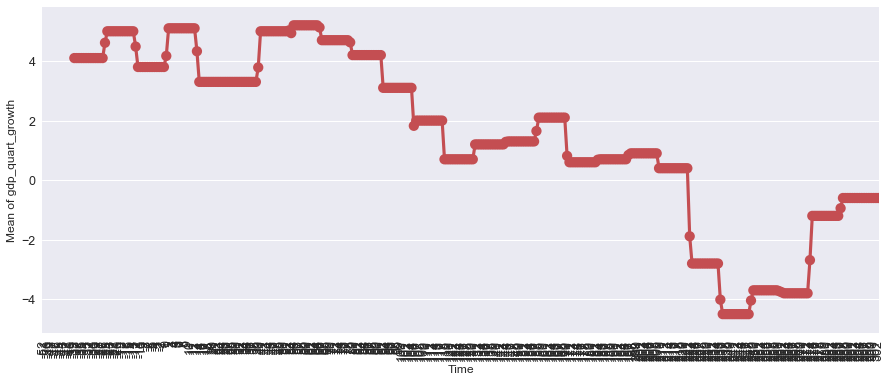

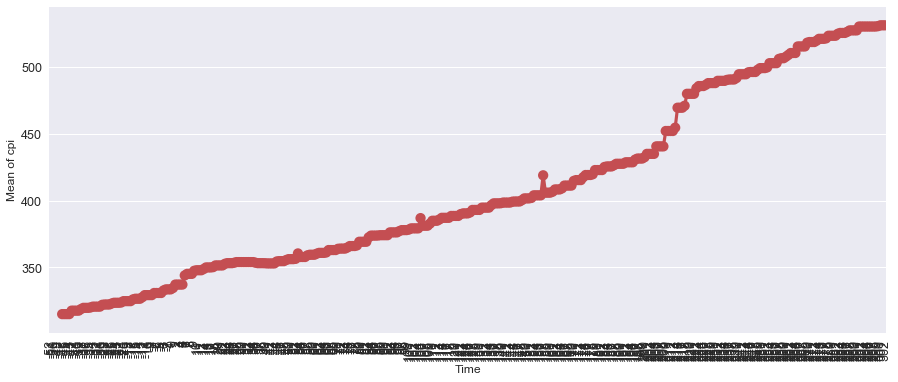

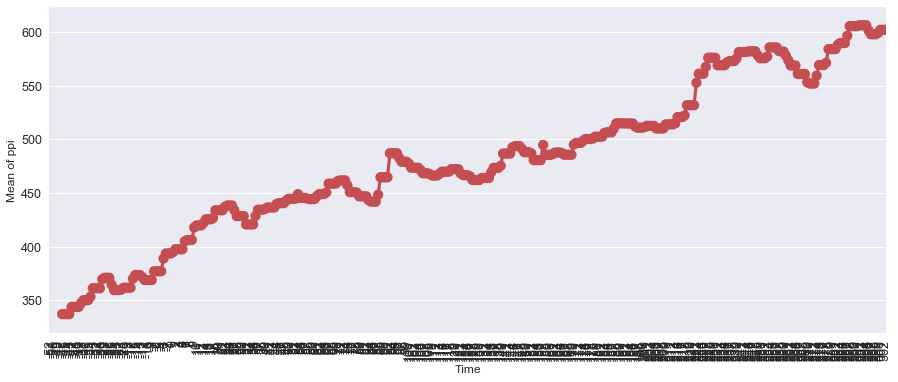

...

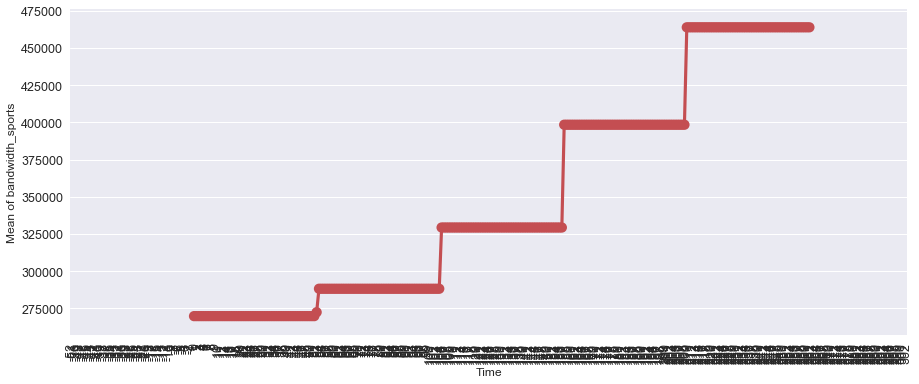

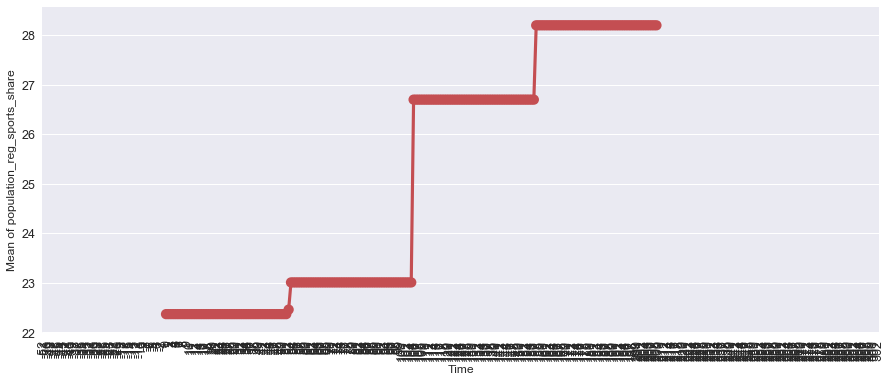

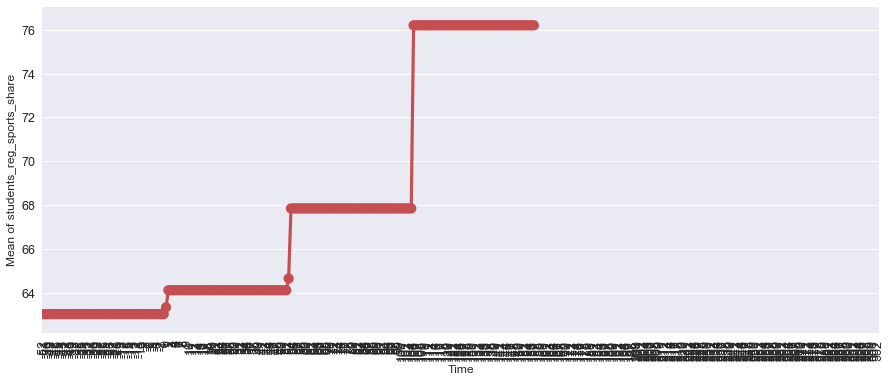

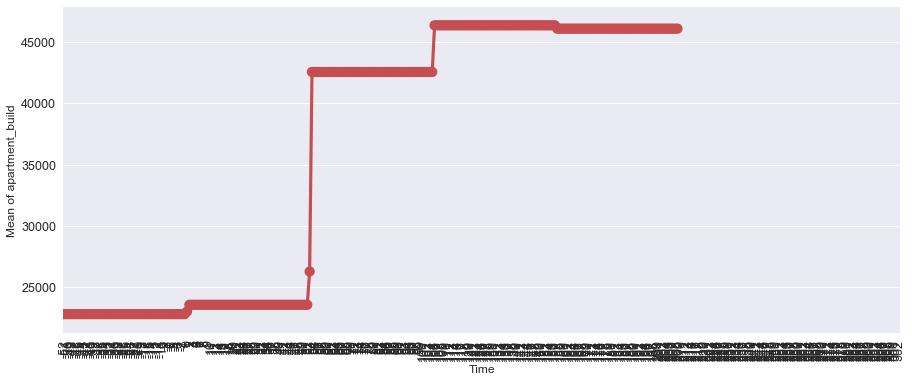

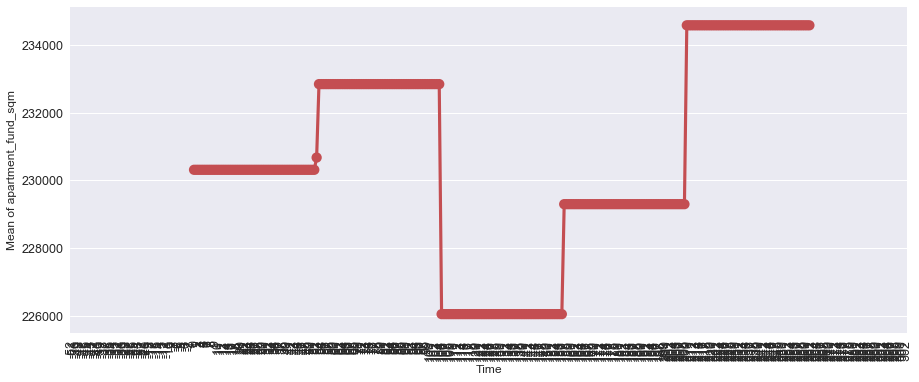

In [156]:
for col in macro_numeric_cols:
    create_time_series_plots(macro, 'weeks_from_2011-01-01', col)

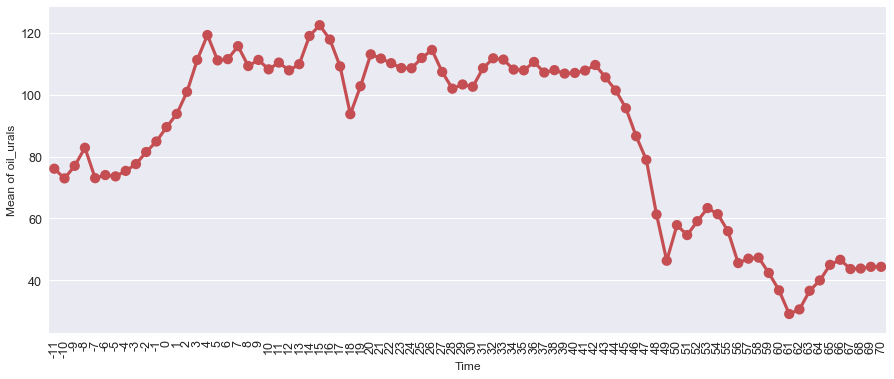

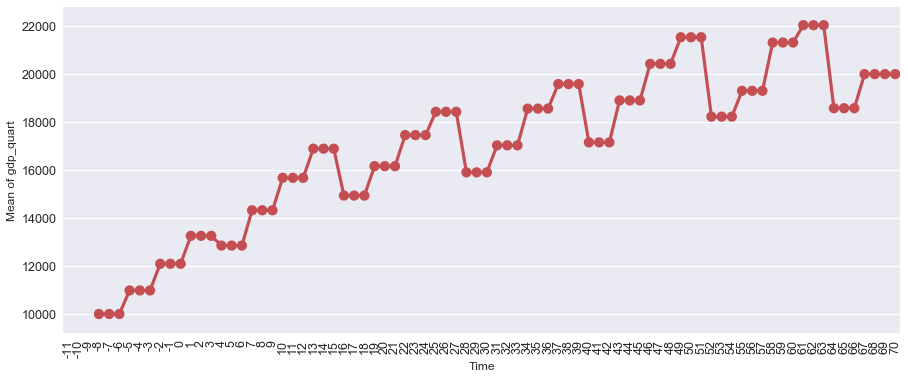

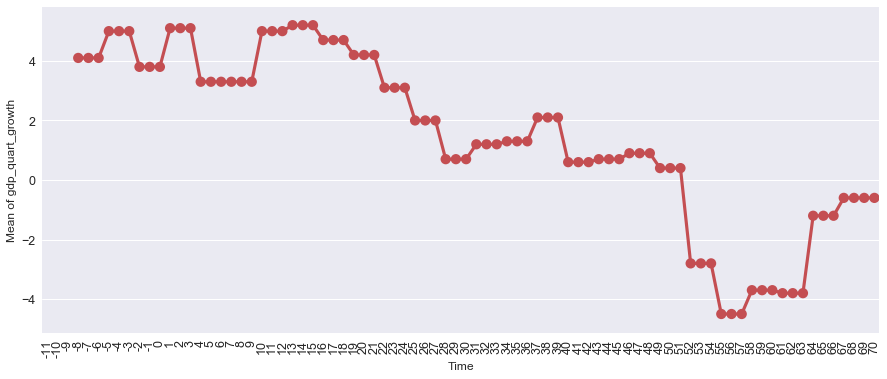

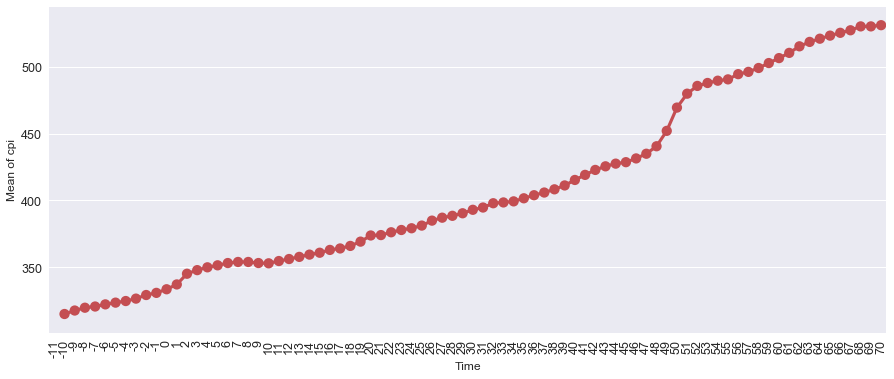

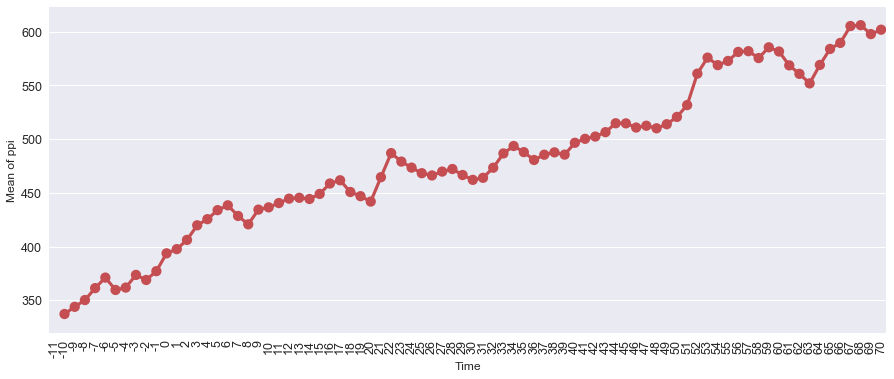

...

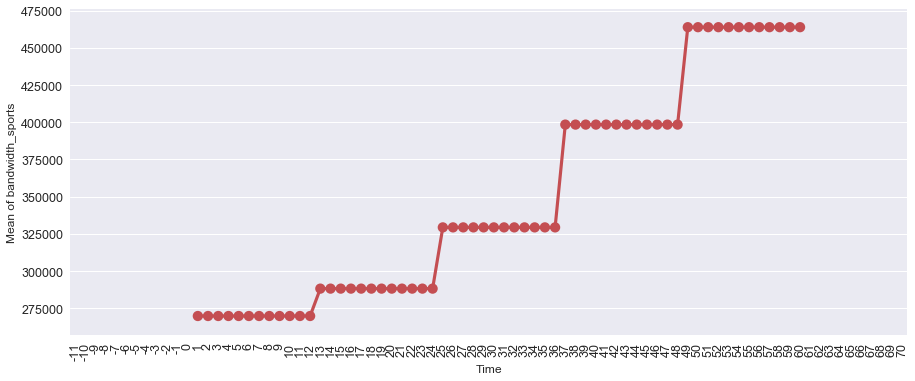

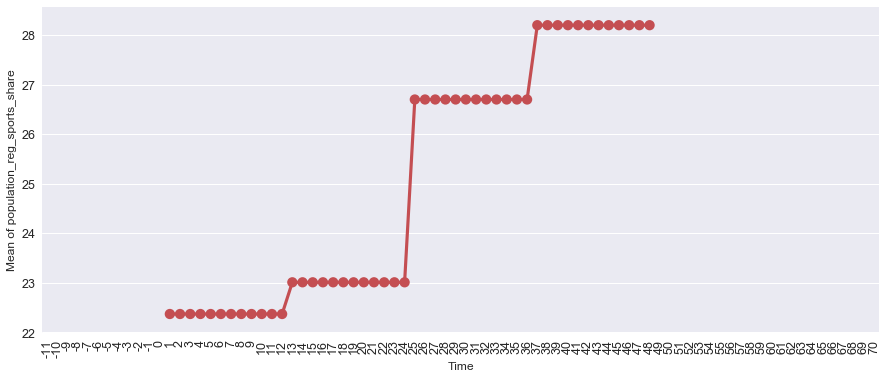

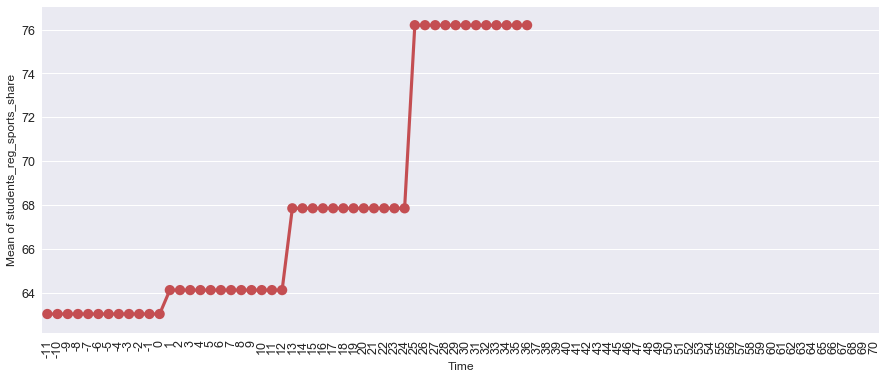

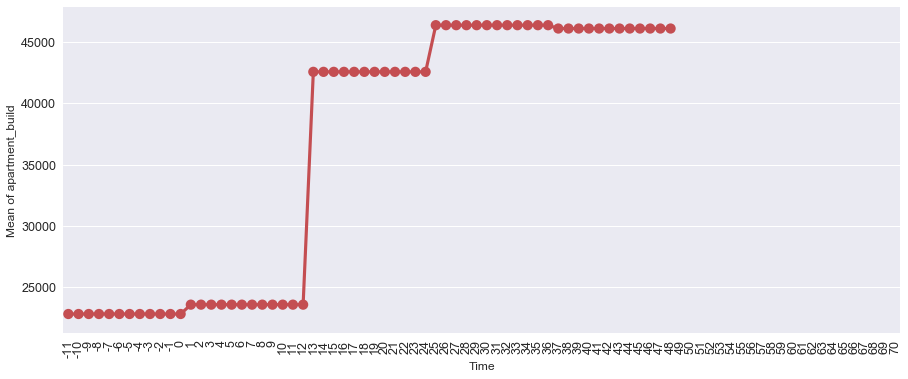

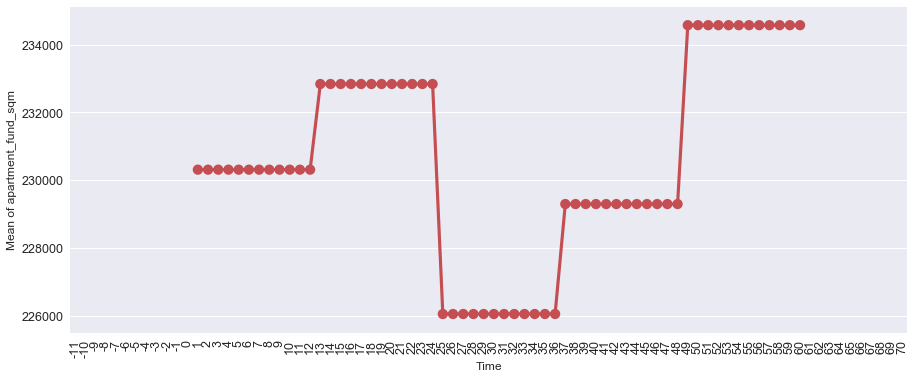

In [157]:
for col in macro_numeric_cols:
    create_time_series_plots(macro, 'months_from_2011-01-01', col)

In [158]:
###macro['timestamp'] = pd.to_datetime(macro['timestamp'], errors='coerce')
###macro['year'] = macro['timestamp'].dt.year
###macro['month'] = macro['timestamp'].dt.month
###macro['day'] = macro['timestamp'].dt.day
###macro['weekofyear'] = macro['timestamp'].dt.week
###macro['weekofyear'] = macro.apply(lambda row : 0 if ((row['weekofyear'] > 50) & (row['month'] == 1)) else row['weekofyear'], 
###                                  axis = 1)
###macro['weekday'] = macro['timestamp'].dt.weekday
###macro['quarter'] = macro['timestamp'].dt.quarter
###macro['dayofyear'] = (macro['month'] - 1) * 31 + macro['day']
###
#### firstyr = min(data['year'])  # 2011, defined earlier
###macro['quarters_from_2011-01-01'] = (macro['year'] - firstyr) * 4 + macro['quarter']
###macro['months_from_2011-01-01'] = (macro['year'] - firstyr) * 12 + macro['month']
###macro['weeks_from_2011-01-01'] = (macro['year'] - firstyr) * 52 + macro['weekofyear']

cols_to_drop = ['year', 'month', 'day', 'weekofyear', 'weekday', 'quarter', 'dayofyear', 'quarters_from_2011-01-01', 
                'weeks_from_2011-01-01']

macro_monthly_averages = macro.groupby('months_from_2011-01-01').aggregate(np.mean).reset_index()
macro_monthly_averages.drop(labels = cols_to_drop, axis = 1, inplace = True)
macro_monthly_averages.rename(columns = lambda x : x + '_monthly_aver', inplace = True)
macro_monthly_averages.rename(columns = {'months_from_2011-01-01_monthly_aver' : 'months_from_2011-01-01'}, inplace = True)
macro_monthly_averages.head()

,months_from_2011-01-01,oil_urals_monthly_aver,gdp_quart_monthly_aver,gdp_quart_growth_monthly_aver,cpi_monthly_aver,ppi_monthly_aver,gdp_deflator_monthly_aver,balance_trade_monthly_aver,balance_trade_growth_monthly_aver,usdrub_monthly_aver,...,provision_retail_space_modern_sqm_monthly_aver,turnover_catering_per_cap_monthly_aver,theaters_viewers_per_1000_cap_monthly_aver,seats_theather_rfmin_per_100000_cap_monthly_aver,museum_visitis_per_100_cap_monthly_aver,bandwidth_sports_monthly_aver,population_reg_sports_share_monthly_aver,students_reg_sports_share_monthly_aver,apartment_build_monthly_aver,apartment_fund_sqm_monthly_aver
0,-11,76.10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29.838164,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
1,-10,72.97,NaN,NaN,315.1,337.2,NaN,18.114,NaN,30.157571,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
2,-9,77.03,NaN,NaN,317.7,343.9,NaN,16.704,NaN,29.549923,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
3,-8,82.87,9995.8,4.1,319.8,350.2,NaN,16.604,14.1,29.183473,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
4,-7,73.05,9995.8,4.1,320.7,361.3,NaN,15.654,14.1,30.497019,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN


In [159]:
cols_to_drop = ['year', 'month', 'day', 'weekofyear', 'weekday', 'quarter', 'dayofyear', 'weeks_from_2011-01-01', 
                'months_from_2011-01-01']

macro_quarterly_averages = macro.groupby('quarters_from_2011-01-01').aggregate(np.mean).reset_index()
macro_quarterly_averages.drop(labels = cols_to_drop, axis = 1, inplace = True)
macro_quarterly_averages.rename(columns = lambda x : x + '_quart_aver', inplace = True)
macro_quarterly_averages.rename(columns = {'quarters_from_2011-01-01_quart_aver' : 'quarters_from_2011-01-01'}, inplace = True)
macro_quarterly_averages.head()

,quarters_from_2011-01-01,oil_urals_quart_aver,gdp_quart_quart_aver,gdp_quart_growth_quart_aver,cpi_quart_aver,ppi_quart_aver,gdp_deflator_quart_aver,balance_trade_quart_aver,balance_trade_growth_quart_aver,usdrub_quart_aver,...,provision_retail_space_modern_sqm_quart_aver,turnover_catering_per_cap_quart_aver,theaters_viewers_per_1000_cap_quart_aver,seats_theather_rfmin_per_100000_cap_quart_aver,museum_visitis_per_100_cap_quart_aver,bandwidth_sports_quart_aver,population_reg_sports_share_quart_aver,students_reg_sports_share_quart_aver,apartment_build_quart_aver,apartment_fund_sqm_quart_aver
0,-3,75.446556,NaN,NaN,316.466102,340.720339,NaN,17.373153,NaN,29.838255,...,690.0,6221.0,527.0,0.41000,993.0,NaN,NaN,63.03,22825.0,NaN
1,-2,76.617033,9995.8,4.1,320.930769,360.871429,NaN,15.335538,14.1,30.311467,...,690.0,6221.0,527.0,0.41000,993.0,NaN,NaN,63.03,22825.0,NaN
2,-1,75.517609,10977.0,5.0,324.982609,364.906522,NaN,11.732065,-4.1,30.601137,...,690.0,6221.0,527.0,0.41000,993.0,NaN,NaN,63.03,22825.0,NaN
3,0,85.321196,12086.5,3.8,331.270652,379.930435,NaN,11.906011,2.2,30.710161,...,690.0,6221.0,527.0,0.41000,993.0,NaN,NaN,63.03,22825.0,NaN
4,1,102.051889,13249.3,5.1,343.374444,407.922222,86.721,16.878589,18.6,29.261854,...,271.0,6943.0,565.0,0.45356,1240.0,269768.0,22.37,64.12,23587.0,230310.0


In [160]:
data = pd.merge(data, macro_monthly_averages, how = 'left', 
                left_on = 'months_from_2011-01-01', right_on = 'months_from_2011-01-01')

macro_monthly_averages_1_month_before = macro_monthly_averages.copy()
macro_monthly_averages_1_month_before['months_from_2011-01-01'
                                     ] = macro_monthly_averages_1_month_before['months_from_2011-01-01'] + 1
macro_monthly_averages_1_month_before.rename(columns = lambda x : x + '_1_month_before', inplace = True)
macro_monthly_averages_1_month_before.rename(columns = {'months_from_2011-01-01_1_month_before' : 'months_from_2011-01-01'}, 
                                             inplace = True)
data = pd.merge(data, macro_monthly_averages_1_month_before, how = 'left', 
                left_on = 'months_from_2011-01-01', right_on = 'months_from_2011-01-01')
del macro_monthly_averages_1_month_before

macro_monthly_averages_2_months_before = macro_monthly_averages.copy()
macro_monthly_averages_2_months_before['months_from_2011-01-01'
                                      ] = macro_monthly_averages_2_months_before['months_from_2011-01-01'] + 2
macro_monthly_averages_2_months_before.rename(columns = lambda x : x + '_2_months_before', inplace = True)
macro_monthly_averages_2_months_before.rename(columns = {'months_from_2011-01-01_2_months_before' : 'months_from_2011-01-01'}, 
                                              inplace = True)
data = pd.merge(data, macro_monthly_averages_2_months_before, how = 'left', 
                left_on = 'months_from_2011-01-01', right_on = 'months_from_2011-01-01')
del macro_monthly_averages_2_months_before

macro_monthly_averages_3_months_before = macro_monthly_averages.copy()
macro_monthly_averages_3_months_before['months_from_2011-01-01'
                                      ] = macro_monthly_averages_3_months_before['months_from_2011-01-01'] + 3
macro_monthly_averages_3_months_before.rename(columns = lambda x : x + '_3_months_before', inplace = True)
macro_monthly_averages_3_months_before.rename(columns = {'months_from_2011-01-01_3_months_before' : 'months_from_2011-01-01'}, 
                                              inplace = True)
data = pd.merge(data, macro_monthly_averages_3_months_before, how = 'left', 
                left_on = 'months_from_2011-01-01', right_on = 'months_from_2011-01-01')
del macro_monthly_averages_3_months_before

data.head()

,0_13_all,0_13_female,0_13_male,0_17_all,0_17_female,0_17_male,0_6_all,0_6_female,0_6_male,16_29_all,...,provision_retail_space_modern_sqm_monthly_aver_3_months_before,turnover_catering_per_cap_monthly_aver_3_months_before,theaters_viewers_per_1000_cap_monthly_aver_3_months_before,seats_theather_rfmin_per_100000_cap_monthly_aver_3_months_before,museum_visitis_per_100_cap_monthly_aver_3_months_before,bandwidth_sports_monthly_aver_3_months_before,population_reg_sports_share_monthly_aver_3_months_before,students_reg_sports_share_monthly_aver_3_months_before,apartment_build_monthly_aver_3_months_before,apartment_fund_sqm_monthly_aver_3_months_before
0,18654,8945,9709,23603,11317,12286,9576,4677,4899,17508,...,271.0,6943.0,565.0,0.45356,1240.0,269768.0,22.37,64.12,23587.0,230310.0
1,13729,6800,6929,17700,8702,8998,6880,3414,3466,15164,...,271.0,6943.0,565.0,0.45356,1240.0,269768.0,22.37,64.12,23587.0,230310.0
2,11252,5336,5916,14884,7063,7821,5879,2784,3095,19401,...,271.0,6943.0,565.0,0.45356,1240.0,269768.0,22.37,64.12,23587.0,230310.0
3,24934,12152,12782,32063,15550,16513,13087,6442,6645,3292,...,271.0,6943.0,565.0,0.45356,1240.0,269768.0,22.37,64.12,23587.0,230310.0
4,11631,5408,6223,15237,7124,8113,5706,2724,2982,5164,...,271.0,6943.0,565.0,0.45356,1240.0,269768.0,22.37,64.12,23587.0,230310.0


In [161]:
data = pd.merge(data, macro_quarterly_averages, how = 'left', 
                left_on = 'quarters_from_2011-01-01', right_on = 'quarters_from_2011-01-01')

macro_quarterly_averages_1_quarter_before = macro_quarterly_averages.copy()
macro_quarterly_averages_1_quarter_before['quarters_from_2011-01-01'
                                         ] = macro_quarterly_averages_1_quarter_before['quarters_from_2011-01-01'] + 1
macro_quarterly_averages_1_quarter_before.rename(columns = lambda x : x + '_1_quarter_before', inplace = True)
macro_quarterly_averages_1_quarter_before.rename(columns = {'quarters_from_2011-01-01_1_quarter_before' : 
                                                            'quarters_from_2011-01-01'}, 
                                                 inplace = True)
data = pd.merge(data, macro_quarterly_averages_1_quarter_before, how = 'left', 
                left_on = 'quarters_from_2011-01-01', right_on = 'quarters_from_2011-01-01')
del macro_quarterly_averages_1_quarter_before

macro_quarterly_averages_2_quarters_before = macro_quarterly_averages.copy()
macro_quarterly_averages_2_quarters_before['quarters_from_2011-01-01'
                                          ] = macro_quarterly_averages_2_quarters_before['quarters_from_2011-01-01'] + 2
macro_quarterly_averages_2_quarters_before.rename(columns = lambda x : x + '_2_quarters_before', inplace = True)
macro_quarterly_averages_2_quarters_before.rename(columns = {'quarters_from_2011-01-01_2_quarters_before' : 
                                                             'quarters_from_2011-01-01'}, 
                                                  inplace = True)
data = pd.merge(data, macro_quarterly_averages_2_quarters_before, how = 'left', 
                left_on = 'quarters_from_2011-01-01', right_on = 'quarters_from_2011-01-01')
del macro_quarterly_averages_2_quarters_before

macro_quarterly_averages_3_quarters_before = macro_quarterly_averages.copy()
macro_quarterly_averages_3_quarters_before['quarters_from_2011-01-01'
                                          ] = macro_quarterly_averages_3_quarters_before['quarters_from_2011-01-01'] + 3
macro_quarterly_averages_3_quarters_before.rename(columns = lambda x : x + '_3_quarters_before', inplace = True)
macro_quarterly_averages_3_quarters_before.rename(columns = {'quarters_from_2011-01-01_3_quarters_before' : 
                                                             'quarters_from_2011-01-01'}, 
                                                  inplace = True)
data = pd.merge(data, macro_quarterly_averages_3_quarters_before, how = 'left', 
                left_on = 'quarters_from_2011-01-01', right_on = 'quarters_from_2011-01-01')
del macro_quarterly_averages_3_quarters_before

data.head()

,0_13_all,0_13_female,0_13_male,0_17_all,0_17_female,0_17_male,0_6_all,0_6_female,0_6_male,16_29_all,...,provision_retail_space_modern_sqm_quart_aver_3_quarters_before,turnover_catering_per_cap_quart_aver_3_quarters_before,theaters_viewers_per_1000_cap_quart_aver_3_quarters_before,seats_theather_rfmin_per_100000_cap_quart_aver_3_quarters_before,museum_visitis_per_100_cap_quart_aver_3_quarters_before,bandwidth_sports_quart_aver_3_quarters_before,population_reg_sports_share_quart_aver_3_quarters_before,students_reg_sports_share_quart_aver_3_quarters_before,apartment_build_quart_aver_3_quarters_before,apartment_fund_sqm_quart_aver_3_quarters_before
0,18654,8945,9709,23603,11317,12286,9576,4677,4899,17508,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
1,13729,6800,6929,17700,8702,8998,6880,3414,3466,15164,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
2,11252,5336,5916,14884,7063,7821,5879,2784,3095,19401,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
3,24934,12152,12782,32063,15550,16513,13087,6442,6645,3292,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN
4,11631,5408,6223,15237,7124,8113,5706,2724,2982,5164,...,690.0,6221.0,527.0,0.41,993.0,NaN,NaN,63.03,22825.0,NaN


## Separate train and test
## Create train, valid and valid2 (for local test)

In [162]:
data.to_csv(DATA_FILE, sep = ',', index = False)

alltrain = data[data['istrain'] == 1]
alltest = data[data['istrain'] == 0]
alltrain.drop('istrain', axis = 1, inplace = True)
alltest.drop('istrain', axis = 1, inplace = True)
alltest.drop([TARGET, LOGTARGET], axis = 1, inplace = True)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [163]:
alltrain.to_csv(ALLTRAIN, sep = ',', index = False)
alltest.to_csv(TEST_PREPROCESSED, sep = ',', index = False)

# Create train, and valid from the given training data:
alltrain.sort_values(by = ID)
valid_preprocessed = alltrain[alltrain[ID] > 21212]           # from 2014-08-01 (about 30 percent of data)
train_preprocessed = alltrain[alltrain[ID] < 21213]

msk = np.random.rand(len(valid_preprocessed)) < 0.5     # 15 percent validation set + 15 percent local test set
localtest_preprocessed = valid_preprocessed[~msk]
valid_preprocessed = valid_preprocessed[msk]

train_preprocessed.to_csv(TRAIN_PREPROCESSED, sep = ',', index = False)
valid_preprocessed.to_csv(VALID_PREPROCESSED, sep = ',', index = False)
localtest_preprocessed.to_csv(LOCALTEST_PREPROCESSED, sep = ',', index = False)

In [164]:
del alltrain
del alltest
del valid_preprocessed
del train_preprocessed
del localtest_preprocessed


In [166]:
with open('data/msk_for_valid_and_localtest.txt', 'wb') as fp:
    pickle.dump(msk, fp)

## Multicollinearity again

In [167]:
# Calculate the variable inflation factor for the numerical variables
from statsmodels.stats.outliers_influence import variance_inflation_factor
def find_multicollinearity(X):
    '''X - pandas dataframe'''
    thresh = 5.0
    variables = list(X.columns)
    #num_var = len(variables)
    vif = [variance_inflation_factor(X.as_matrix(), ix) for ix in range(X.shape[1])]
    columns_with_high_vif = []
    i = 1
    while max(vif) > thresh:
        print(i)
        maxloc = vif.index(max(vif))
        print('dropping ', X.columns[maxloc], ' with vif: ', vif[maxloc])
        columns_with_high_vif.append(X.columns[maxloc])
        variables.pop(maxloc)
        X = X[variables]
        vif = [variance_inflation_factor(X.as_matrix(), ix) for ix in range(X.shape[1])]
        i = i + 1
    print('Remaining variables:')
    print(X[variables].columns)
    return X, columns_with_high_vif

col_sel = data.columns[data.dtypes == 'int64'].append(data.columns[data.dtypes == 'float64'])
X = data[col_sel].dropna()
print(X.shape)

Y, columns_with_high_vif = find_multicollinearity(X)

(1, 1102)


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1181: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1181: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss


Remaining variables:
Index(['0_13_all', '0_13_female', '0_13_male', '0_17_all', '0_17_female',
       '0_17_male', '0_6_all', '0_6_female', '0_6_male', '16_29_all',
       ...
       'provision_retail_space_modern_sqm_quart_aver_3_quarters_before',
       'turnover_catering_per_cap_quart_aver_3_quarters_before',
       'theaters_viewers_per_1000_cap_quart_aver_3_quarters_before',
       'seats_theather_rfmin_per_100000_cap_quart_aver_3_quarters_before',
       'museum_visitis_per_100_cap_quart_aver_3_quarters_before',
       'bandwidth_sports_quart_aver_3_quarters_before',
       'population_reg_sports_share_quart_aver_3_quarters_before',
       'students_reg_sports_share_quart_aver_3_quarters_before',
       'apartment_build_quart_aver_3_quarters_before',
       'apartment_fund_sqm_quart_aver_3_quarters_before'],
      dtype='object', length=1102)


In [168]:
remaining_cols = list(Y.columns)
remaining_cols

['0_13_all',
 '0_13_female',
 '0_13_male',
 '0_17_all',
 '0_17_female',
 '0_17_male',
 '0_6_all',
 '0_6_female',
 '0_6_male',
 '16_29_all',
 '16_29_female',
 '16_29_male',
 '7_14_all',
 '7_14_female',
 '7_14_male',
 'additional_education_raion',
 'big_church_count_1000',
 'big_church_count_1500',
 'big_church_count_2000',
 'big_church_count_3000',
 'big_church_count_500',
 'big_church_count_5000',
 'big_market_raion',
 'big_road1_1line',
 'cafe_count_1000',
 'cafe_count_1000_na_price',
 'cafe_count_1000_price_1000',
 'cafe_count_1000_price_1500',
 'cafe_count_1000_price_2500',
 'cafe_count_1000_price_4000',
 'cafe_count_1000_price_500',
 'cafe_count_1000_price_high',
 'cafe_count_1500',
 'cafe_count_1500_na_price',
 'cafe_count_1500_price_1000',
 'cafe_count_1500_price_1500',
 'cafe_count_1500_price_2500',
 'cafe_count_1500_price_4000',
 'cafe_count_1500_price_500',
 'cafe_count_1500_price_high',
 'cafe_count_2000',
 'cafe_count_2000_na_price',
 'cafe_count_2000_price_1000',
 'cafe_cou

In [169]:
import pickle

with open('remaining_cols_data_with_macro.txt', 'wb') as fp:
    pickle.dump(remaining_cols, fp)
    
### unpickling:
##with open("remaining_cols.txt", "rb") as fp:
##    remaining_cols = pickle.load(fp)

In [170]:
columns_with_high_vif

with open('columns_with_high_vif_data_with_macro.txt', 'wb') as fp:
    pickle.dump(columns_with_high_vif, fp)